In [37]:
import pandas as pd
import numpy as np
import sklearn as sk
import datetime as dt
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs
from statsmodels.tsa.stattools import adfuller
import os
import sklearn.metrics as sk_m
from sklearn import linear_model
from sklearn.decomposition import PCA
os.environ["NUMBER_OF_PROCESSORS"] = "2"
import seaborn as sns; sns.set(color_codes=True)
import plotly.plotly as ply
%matplotlib inline

In [38]:
def gather_data(filename, sheet):
    df = pd.read_excel(filename,sheetname=sheet)
    #drop columns where all the values are na
    df = df.dropna(axis = 1, how = 'all')
    #naming the columns properly
    return df

def process_headers(df):
    df = df.copy()
    curr_colnames = list(df.columns)
    colnames =list(df.loc[0,:])
    for i,col in enumerate(list(curr_colnames)):
        if col.find("Unnamed") != -1:
            curr_colnames[i] = curr_colnames[i-1]
            col = curr_colnames[i-1]
        colnames[i]= str(col) + '__'+str(colnames[i]) 
    df.columns = colnames
    df = df.loc[1:,:]
    return df
        
def process_timeline(df):
    #aligns the dataframe with single timeline
    #break the dataframe into separate dataframes with regards to timelines
    df_dict = {}
    count_dates = [0 if x.lower().find('date')==-1 else 1 for x in list(df.columns)]
    
    ct_df = 0
    start = 0
    start_index = 0
    for i,dt in enumerate(count_dates):
        if dt == 1 and start ==0:
            df_dict[ct_df] = pd.DataFrame()
            start_index = i
            start = 1
            
        elif dt ==1:
            df_dict[ct_df] = df.iloc[:,start_index:i]
            ct_df = ct_df + 1
            start_index = i
            
        elif i == len(count_dates) - 1 and start == 1:
            df_dict[ct_df] = df.iloc[:,start_index:]
            start = 0
    
    for key in sorted(list(df_dict.keys())):
        temp_df = df_dict[key].copy()
        temp_df = temp_df.loc[temp_df.iloc[:,0].dropna().index,:]
        temp_df.index = temp_df.iloc[:,0]
        temp_df = temp_df.iloc[:,1:]
        df_dict[key] = temp_df
        
    #merging the dataframes together
    total_df = np.nan
    for i,key in enumerate(sorted(list(df_dict.keys()))):
        if i == 0:
            total_df =df_dict[key]
        else:
            #print key, df_dict[key].head()
            total_df = total_df.merge(df_dict[key],left_index = True, right_index = True, how = 'outer')
    return total_df
    pass

def trade_calc(df, securities):
    #calculates the flies on 1-2-1 basis and gets the time-series of the fly
    pass
    if len(securities)==2:
        return -1*(df[securities[0]])+1*(df[securities[1]])
    return -1*(df[securities[0]]) + 2*(df[securities[1]]) + -1*(df[securities[2]])

def o_trade_calc(df, securities):  #This just returns time series of the belly * 1
    pass
    if len(securities)==2:
        return -0*(df[securities[0]])+1*(df[securities[1]])
    return -0*(df[securities[0]]) + 1*(df[securities[1]]) + -0*(df[securities[2]])

def trade_pca_calc(df, securities):
    temp_df = df[securities].dropna()
    
    X = np.array((temp_df[securities]-temp_df.shift(1)[securities]).dropna())
    pca_model = PCA()
    pca_model.fit(X)
    weights = pca_model.components_[len(securities)-1,:]    
    if len(securities)==2:
        weights = weights/weights[1]
        print weights
        return weights[0]*df[securities[0]]+weights[1]*df[securities[1]]
    
    print "Weights of PCA Butterfly"
    #print weights

    weights = weights/weights[1]*2.
    print weights
    return weights[0]*df[securities[0]]+weights[1]*df[securities[1]]+weights[2]*df[securities[2]]
    pass

def rolling_pca_calc(df, securities, window):
    full_temp_df = df[securities].dropna()
    rolling_pca = pd.DataFrame(columns = securities, index = full_temp_df.index)
    use_index = rolling_pca.index 
    for i, ind in enumerate(use_index[window:]):
        temp_df = full_temp_df.loc[use_index[i]:ind,securities].dropna()
        X = np.array((temp_df[securities]-temp_df.shift(1)[securities]).dropna())
        pca_model = PCA()
        pca_model.fit(X)
        weights = pca_model.components_[len(securities)-1,:]
        weights = weights/weights[1]
        rolling_pca.loc[ind,:] = weights.tolist()
    
    return rolling_pca
    

#mean reversion equation - dxt = a(b-xt-1) + error


def mean_reversion(flies):
    # Returns mean reversion characteristics for fly entered
    # Xt - X(t-1) = alpha*(theta - X(t-1)) + sigma*N(0,1)
    model_gaussian = linear_model.LinearRegression()
    dt_flies = flies - flies.shift(1)
    X = np.array(flies.shift(1).dropna()).reshape((-1,1))
    Y = np.array(dt_flies.dropna()).reshape((-1,1))
    model_gaussian.fit(X = X, y=Y)
    alpha = model_gaussian.coef_[0]*-1.
    theta = model_gaussian.intercept_/alpha
    r_squared = sk_m.r2_score(Y,model_gaussian.predict(X))
    return list(alpha)[0], list(theta)[0], r_squared
    # Log(2)/alpha is the half life of the trade
    # Theta is the long term average
    # Trade idea will be displacement (Current value - Theta)/alpha - metric and compare against sigma for z-score
    pass
    

In [41]:
filename = r'/Users/adityagoel/Desktop/BFAM/Datafin-L.xlsx'
#test_frame = pd.read_excel(filename, sheet = 'Data-SwapRates')
test_frame = gather_data(filename,'Data-Bonds')
ret_frame = process_headers(test_frame)
ret_df = process_timeline(ret_frame)


In [42]:
#Header lookup
filename_headers = r'/Users/adityagoel/Desktop/BFAM/Datafin-L.xlsx'
headers = pd.read_excel(filename_headers,sheetname='Sheet 31')
headers.index = headers.iloc[:,0]
headers = headers.iloc[:,1:]
headers

,GER,NET,FIN,AUT,FRA,BEL,IRE,ESP,ITL,PTE,UKT
TENOR,,,,,,,,,,,
2Y,OBL 1 02/22/19 168,NETHER 4 07/15/19,RFGB 4.375 07/04/19,RAGB 4.35 03/15/19,FRTR 1 05/25/19,BGB 4 03/28/19 55,IRISH 4.5 10/18/18,SPGB 2.75 04/30/19,BTPS 2.5 05/01/19,PGB 4.75 06/14/19,UKT 1.75 07/22/19
3Y,DBR 3.25 01/04/20 09,NETHER 3.5 07/15/20,RFGB 3.375 04/15/20,RAGB 3.9 07/15/20,FRTR 0 05/25/20,BGB 3.75 09/28/20 58,IRISH 5.9 10/18/19,SPGB 4 04/30/20,BTPS 0.7 05/01/20,PGB 4.8 06/15/20,UKT 2 07/22/20
5Y,DBR 2 01/04/22,NETHER 2.25 07/15/22,RFGB 1.625 09/15/22,RAGB 3.65 04/20/22,FRTR 3.25 10/25/21,BGB 4.25 09/28/22 65,IRISH 0.8 03/15/22,SPGB 5.85 01/31/22,BTPS 5 03/01/22,PGB 2.2 10/17/22,UKT 0.5 07/22/22
7Y,DBR 1.75 02/15/24,NETHER 2 07/15/24,RFGB 2 04/15/24,RAGB 1.65 10/21/24 1,FRTR 2.25 05/25/24,BGB 2.6 06/22/24 72,IRISH 3.4 03/18/24,SPGB 3.8 04/30/24,BTPS 4.5 03/01/24,PGB 5.65 02/15/24,UKT 2.75 09/07/24
10Y,DBR 0.5 02/15/26,NETHER 0.5 07/15/26,RFGB 0.5 04/15/26,RAGB 0.75 10/20/26,FRTR 0.5 05/25/26,BGB 1 06/22/26 77,IRISH 1 05/15/26,SPGB 1.95 04/30/26,BTPS 4.5 03/01/26,PGB 2.875 07/21/26,UKT 4.25 12/07/27
15Y,DBR 4.75 07/04/34 ++03,NETHER 2.5 01/15/33,RFGB 0.75 04/15/31,RAGB 2.4 05/23/34,FRTR 5.75 10/25/32,BGB 4 03/28/32 66,IRISH 2.4 05/15/30,SPGB 5.75 07/30/32,BTPS 1.65 03/01/32,PGB 3.875 02/15/30,UKT 4.25 06/07/32
20Y,DBR 4 01/04/37 ++05,NETHER 4 01/15/37,#N/A Invalid Security,RAGB 4.15 03/15/37,FRTR 4 10/25/38,BGB 1.9 06/22/38 76,#N/A Invalid Security,SPGB 4.2 01/31/37,BTPS 4 02/01/37,PGB 4.1 04/15/37,UKT 4.25 03/07/36
30Y,DBR 2.5 08/15/46,NETHER 2.75 01/15/47,RFGB 2.625 07/04/42,RAGB 1.5 02/20/47,FRTR 3.25 05/25/45,BGB 1.6 06/22/47 78,IRISH 2 02/18/45,SPGB 2.9 10/31/46,BTPS 3.25 09/01/46,PGB 4.1 02/15/45,UKT 1.5 07/22/47


In [43]:
#Part 1 - All Fly Structures - PCA and 1-2-1 - all countries and butterfly structures - YTM

fly_list_master = [[2, 5, 10],[5,7,10],[2, 5, 30]]
fly_list_str = ['FLY'+''.join([str(y) for y in x]) for x in fly_list_master]
pca_metrics_df_dict = {key:pd.DataFrame(columns = headers.columns, index = fly_list_str) 
                       for key in ['Current Displacement', 'Relative Displacement', 'R-squared','Half-life']}
metrics_df_dict = {key:pd.DataFrame(columns = headers.columns, index = fly_list_str) 
                   for key in ['Current Displacement', 'Relative Displacement', 'R-squared','Half-life']}

import matplotlib.pyplot as plt
plt.style.use('ggplot')

fly_country_dict = {key:np.nan for key in list(headers.columns)}
pca_fly_country_dict = {key:np.nan for key in list(headers.columns)}


for ind1 , fly_list in enumerate(fly_list_master):
    strlist = 'FLY'+''.join([str(x) for x in fly_list])
    for country in fly_country_dict.keys()[:]:
        tickerlist = [headers.loc[str(x)+'Y',country] for x in fly_list]
        metric = 'YLD_YTM_MID'
        tickerlist = [x+' Govt__'+metric for x in tickerlist]

       # try:
        pca_fly_country_dict[country] = pd.DataFrame(trade_pca_calc(ret_df,tickerlist).dropna(), columns = ['PCA_Fly'+''.join([str(x) for x in fly_list])])
        fly_country_dict[country] = pd.DataFrame(trade_calc(ret_df,tickerlist).dropna(),columns = ['1-2-1_Fly'+''.join([str(x) for x in fly_list])])
        '''
        ax = pca_fly_country_dict[country].plot(legend = True)
        fly_country_dict[country].plot(legend = True, ax = ax)
        plt.show()'''
        (alpha, theta, r_squared) = mean_reversion(pca_fly_country_dict[country])
        pca_metrics_df_dict['Current Displacement'].loc[strlist, country]=(theta - float(pca_fly_country_dict[country].iloc[-1,:]))
        relative_distance = (theta - float(pca_fly_country_dict[country].iloc[-1,:]))/theta
        pca_metrics_df_dict['Relative Displacement'].loc[strlist, country]=relative_distance
        pca_metrics_df_dict['R-squared'].loc[strlist, country]=r_squared
        pca_metrics_df_dict['Half-life'].loc[strlist, country]=np.log(2)/alpha           

        (alpha, theta, r_squared) = mean_reversion(fly_country_dict[country])
        metrics_df_dict['Current Displacement'].loc[strlist, country]=(theta - float(fly_country_dict[country].iloc[-1,:]))
        relative_distance = (theta - float(fly_country_dict[country].iloc[-1,:]))/theta
        metrics_df_dict['Relative Displacement'].loc[strlist, country]=relative_distance
        metrics_df_dict['R-squared'].loc[strlist, country]=r_squared
        metrics_df_dict['Half-life'].loc[strlist, country]=np.log(2)/alpha           

            
            #axes = sns.tsplot(pca_fly_country_dict[country].dropna())
            #axes1 = sns.tsplot(fly_country_dict[country].dropna())
            #plt.legend([axes.plot,axes1.plot],[country+'pca',country+'1-2-1'])
      #  except:
       #     print "Did not work"

Weights of PCA Butterfly
[-1.4353657   2.         -0.88945755]
Weights of PCA Butterfly
[-1.62723849  2.         -0.71066551]
Weights of PCA Butterfly
[-1.44221265  2.         -1.00467228]
Weights of PCA Butterfly
[-1.7255356   2.         -0.79636537]
Weights of PCA Butterfly
[-1.14189429  2.         -1.17598299]
Weights of PCA Butterfly
[-1.05699909  2.         -1.01598599]
Weights of PCA Butterfly
[-1.32544293  2.         -0.91251118]
Weights of PCA Butterfly
[-1.26461122  2.         -0.92894197]
Weights of PCA Butterfly
[-1.27268363  2.         -0.97162851]
Weights of PCA Butterfly
[-0.97284809  2.         -1.06136328]
Weights of PCA Butterfly
[-1.60518141  2.         -1.05136411]
Weights of PCA Butterfly
[-0.76475243  2.         -1.2171718 ]
Weights of PCA Butterfly
[-0.82563892  2.         -1.20631108]
Weights of PCA Butterfly
[-0.95138872  2.         -1.06734728]
Weights of PCA Butterfly
[-0.97075105  2.         -1.17672097]
Weights of PCA Butterfly
[-0.67253523  2.         -1.34

PCA Fly Displacement


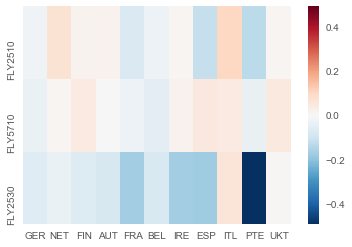

PCA Fly R-Square


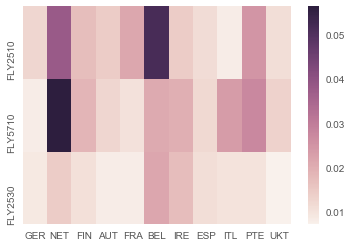

PCA Fly Half-Life


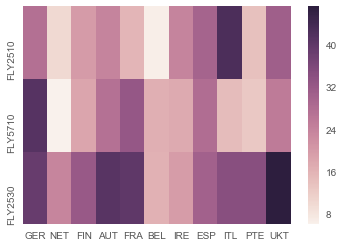

1-2-1 Fly Displacement


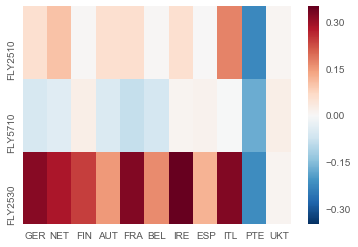

1-2-1 Fly R-Square


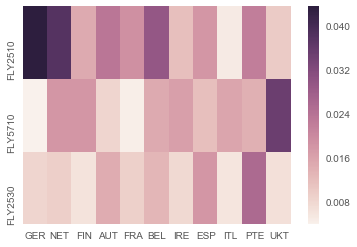

1-2-1 Fly Half-Life


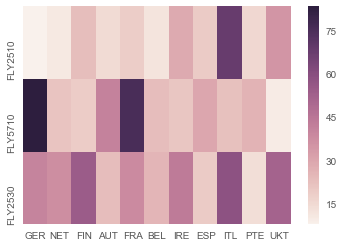

In [44]:
import seaborn as sns
print "PCA Fly Displacement"
sns.heatmap(pca_metrics_df_dict['Current Displacement'].astype(float));plt.show()
print "PCA Fly R-Square"
sns.heatmap(pca_metrics_df_dict['R-squared'].astype(float));plt.show()
print "PCA Fly Half-Life"
sns.heatmap(pca_metrics_df_dict['Half-life'].astype(float));plt.show()
print "1-2-1 Fly Displacement"
sns.heatmap(metrics_df_dict['Current Displacement'].astype(float));plt.show()
print "1-2-1 Fly R-Square"
sns.heatmap(metrics_df_dict['R-squared'].astype(float));plt.show()
print "1-2-1 Fly Half-Life"
sns.heatmap(metrics_df_dict['Half-life'].astype(float));plt.show()

GER
[u'OBL 1 02/22/19 168 Govt__YLD_YTM_MID', u'DBR 2 01/04/22 Govt__YLD_YTM_MID', u'DBR 0.5 02/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.4353657   2.         -0.88945755]


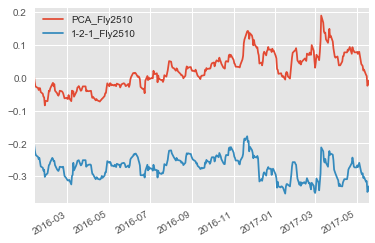

Mean Reversion characteristics for PCA Fly
{'Average': 0.021448793914324839, 'half-life': 27.596348930564069, 'Current_Displacement From Average (Avg - Current)': -0.019719242641596142, 'R-squared': 0.01263095633355571}


FRA
[u'FRTR 1 05/25/19 Govt__YLD_YTM_MID', u'FRTR 3.25 10/25/21 Govt__YLD_YTM_MID', u'FRTR 0.5 05/25/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.62723849  2.         -0.71066551]


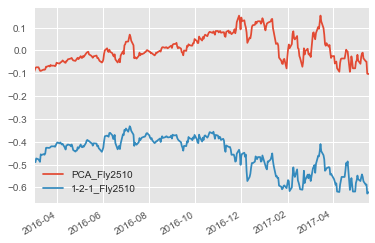

Mean Reversion characteristics for PCA Fly
{'Average': 0.011295263587860266, 'half-life': 15.645034069182056, 'Current_Displacement From Average (Avg - Current)': -0.072482009477374043, 'R-squared': 0.021400359510221567}


BEL
[u'BGB 4 03/28/19 55 Govt__YLD_YTM_MID', u'BGB 4.25 09/28/22 65 Govt__YLD_YTM_MID', u'BGB 1 06/22/26 77 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.44221265  2.         -1.00467228]


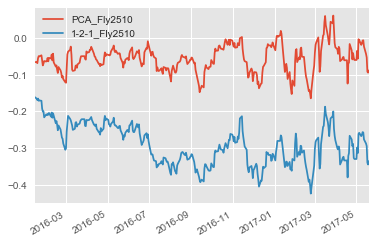

Mean Reversion characteristics for PCA Fly
{'Average': -0.057160880638785473, 'half-life': 6.7142303260112275, 'Current_Displacement From Average (Avg - Current)': -0.027488446638109933, 'R-squared': 0.051708581577955326}


ESP
[u'SPGB 2.75 04/30/19 Govt__YLD_YTM_MID', u'SPGB 5.85 01/31/22 Govt__YLD_YTM_MID', u'SPGB 1.95 04/30/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.7255356   2.         -0.79636537]


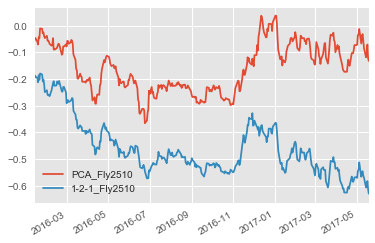

Mean Reversion characteristics for PCA Fly
{'Average': -0.15497925631582174, 'half-life': 30.059301240739444, 'Current_Displacement From Average (Avg - Current)': -0.11797728742853594, 'R-squared': 0.01146451725235309}


PTE
[u'PGB 4.75 06/14/19 Govt__YLD_YTM_MID', u'PGB 2.2 10/17/22 Govt__YLD_YTM_MID', u'PGB 2.875 07/21/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.14189429  2.         -1.17598299]


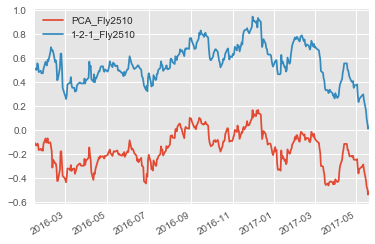

Mean Reversion characteristics for PCA Fly
{'Average': -0.16639126287191713, 'half-life': 13.97968102677261, 'Current_Displacement From Average (Avg - Current)': -0.13274824724008744, 'R-squared': 0.024980254802505764}


UKT
[u'UKT 1.75 07/22/19 Govt__YLD_YTM_MID', u'UKT 0.5 07/22/22 Govt__YLD_YTM_MID', u'UKT 4.25 12/07/27 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.05699909  2.         -1.01598599]


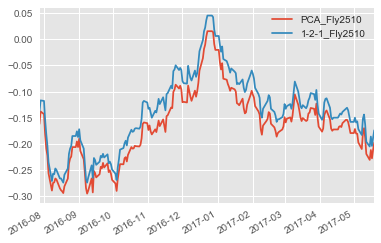

Mean Reversion characteristics for PCA Fly
{'Average': -0.16393606672521047, 'half-life': 30.929160370024668, 'Current_Displacement From Average (Avg - Current)': 0.008198414097362855, 'R-squared': 0.011265185879241746}


ITL
[u'BTPS 2.5 05/01/19 Govt__YLD_YTM_MID', u'BTPS 5 03/01/22 Govt__YLD_YTM_MID', u'BTPS 4.5 03/01/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.32544293  2.         -0.91251118]


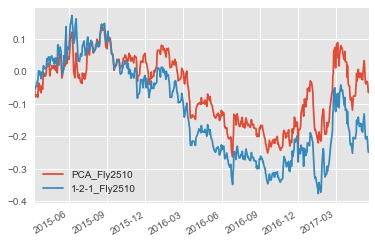

Mean Reversion characteristics for PCA Fly
{'Average': -0.054717868146408465, 'half-life': 42.860727714335844, 'Current_Displacement From Average (Avg - Current)': 0.10238560408488137, 'R-squared': 0.0082229334989769587}


AUT
[u'RAGB 4.35 03/15/19 Govt__YLD_YTM_MID', u'RAGB 3.65 04/20/22 Govt__YLD_YTM_MID', u'RAGB 0.75 10/20/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.26461122  2.         -0.92894197]


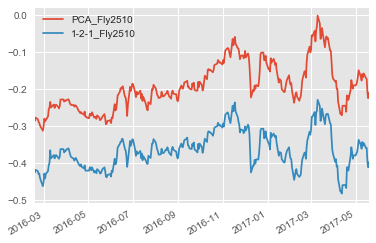

Mean Reversion characteristics for PCA Fly
{'Average': -0.19292896152875907, 'half-life': 23.887002307326039, 'Current_Displacement From Average (Avg - Current)': 0.019501012097089404, 'R-squared': 0.014486528618701144}


NET
[u'NETHER 4 07/15/19 Govt__YLD_YTM_MID', u'NETHER 2.25 07/15/22 Govt__YLD_YTM_MID', u'NETHER 0.5 07/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.27268363  2.         -0.97162851]


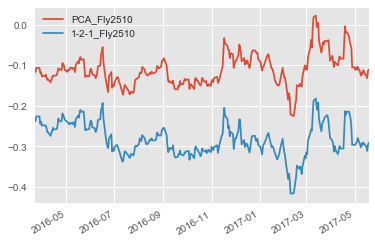

Mean Reversion characteristics for PCA Fly
{'Average': -0.1097762694013022, 'half-life': 10.282511273572196, 'Current_Displacement From Average (Avg - Current)': 0.072754767354301864, 'R-squared': 0.038021467856341196}


FIN
[u'RFGB 4.375 07/04/19 Govt__YLD_YTM_MID', u'RFGB 1.625 09/15/22 Govt__YLD_YTM_MID', u'RFGB 0.5 04/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.97284809  2.         -1.06136328]


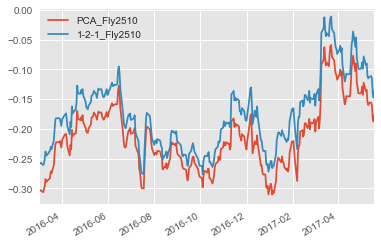

Mean Reversion characteristics for PCA Fly
{'Average': -0.21254038267685638, 'half-life': 20.043471229652955, 'Current_Displacement From Average (Avg - Current)': 0.015878511068597889, 'R-squared': 0.017285821987431782}


IRE
[u'IRISH 4.5 10/18/18 Govt__YLD_YTM_MID', u'IRISH 0.8 03/15/22 Govt__YLD_YTM_MID', u'IRISH 1 05/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.60518141  2.         -1.05136411]


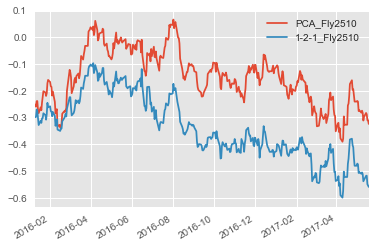

Mean Reversion characteristics for PCA Fly
{'Average': -0.15129013218864226, 'half-life': 23.89082996153364, 'Current_Displacement From Average (Avg - Current)': 0.0087616632570005903, 'R-squared': 0.014502137030408035}


GER
[u'DBR 2 01/04/22 Govt__YLD_YTM_MID', u'DBR 1.75 02/15/24 Govt__YLD_YTM_MID', u'DBR 0.5 02/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.76475243  2.         -1.2171718 ]


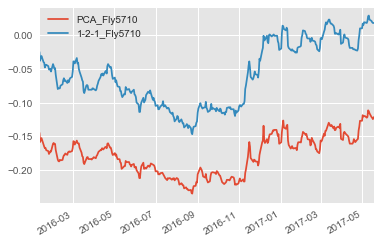

Mean Reversion characteristics for PCA Fly
{'Average': -0.17729800928300238, 'half-life': 41.459450006792409, 'Current_Displacement From Average (Avg - Current)': -0.030740928766223446, 'R-squared': 0.0081647174828977098}


FRA
[u'FRTR 3.25 10/25/21 Govt__YLD_YTM_MID', u'FRTR 2.25 05/25/24 Govt__YLD_YTM_MID', u'FRTR 0.5 05/25/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.82563892  2.         -1.20631108]


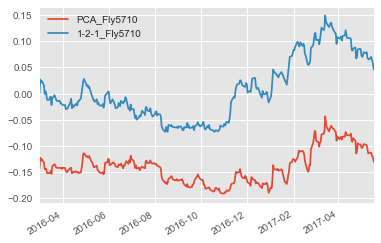

Mean Reversion characteristics for PCA Fly
{'Average': -0.13948683821291771, 'half-life': 32.492964485586441, 'Current_Displacement From Average (Avg - Current)': -0.030361395397127983, 'R-squared': 0.010575030053861512}


BEL
[u'BGB 4.25 09/28/22 65 Govt__YLD_YTM_MID', u'BGB 2.6 06/22/24 72 Govt__YLD_YTM_MID', u'BGB 1 06/22/26 77 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.95138872  2.         -1.06734728]


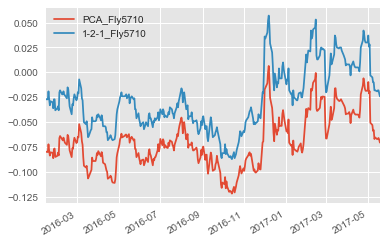

Mean Reversion characteristics for PCA Fly
{'Average': -0.069564153920212882, 'half-life': 16.758409230669265, 'Current_Displacement From Average (Avg - Current)': -0.051140651171436083, 'R-squared': 0.020937013505131219}


ESP
[u'SPGB 5.85 01/31/22 Govt__YLD_YTM_MID', u'SPGB 3.8 04/30/24 Govt__YLD_YTM_MID', u'SPGB 1.95 04/30/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.97075105  2.         -1.17672097]


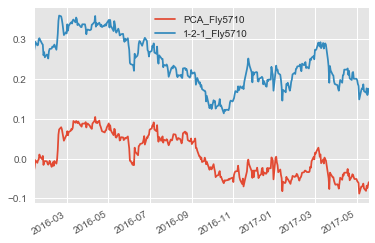

Mean Reversion characteristics for PCA Fly
{'Average': 0.0052420402779788525, 'half-life': 27.973007603751082, 'Current_Displacement From Average (Avg - Current)': 0.052444257030746552, 'R-squared': 0.012271620871434297}


PTE
[u'PGB 2.2 10/17/22 Govt__YLD_YTM_MID', u'PGB 5.65 02/15/24 Govt__YLD_YTM_MID', u'PGB 2.875 07/21/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.67253523  2.         -1.34462802]


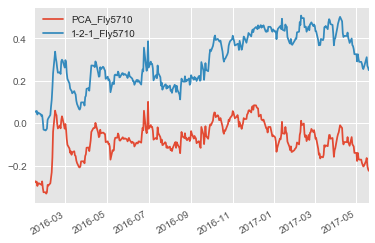

Mean Reversion characteristics for PCA Fly
{'Average': -0.078322201163285032, 'half-life': 12.829359387443569, 'Current_Displacement From Average (Avg - Current)': -0.037940541061824429, 'R-squared': 0.027734641914912261}


UKT
[u'UKT 0.5 07/22/22 Govt__YLD_YTM_MID', u'UKT 2.75 09/07/24 Govt__YLD_YTM_MID', u'UKT 4.25 12/07/27 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.83697501  2.         -1.26913172]


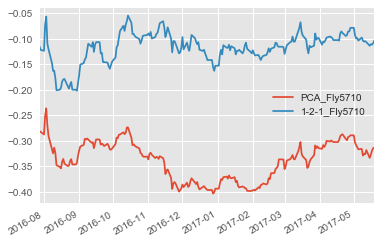

Mean Reversion characteristics for PCA Fly
{'Average': -0.33807042114860131, 'half-life': 25.6619070294145, 'Current_Displacement From Average (Avg - Current)': 0.048349643038024026, 'R-squared': 0.013458621231385415}


ITL
[u'BTPS 5 03/01/22 Govt__YLD_YTM_MID', u'BTPS 4.5 03/01/24 Govt__YLD_YTM_MID', u'BTPS 4.5 03/01/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.98199099  2.         -1.09122917]


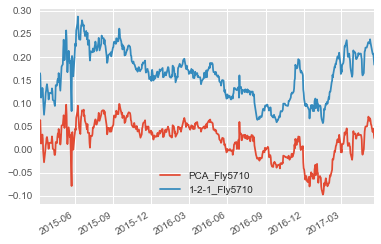

Mean Reversion characteristics for PCA Fly
{'Average': 0.022327800298338741, 'half-life': 14.692747096013118, 'Current_Displacement From Average (Avg - Current)': 0.043577465400069834, 'R-squared': 0.023580007037094286}


AUT
[u'RAGB 3.65 04/20/22 Govt__YLD_YTM_MID', u'RAGB 1.65 10/21/24 1 Govt__YLD_YTM_MID', u'RAGB 0.75 10/20/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.66663652  2.         -1.3572024 ]


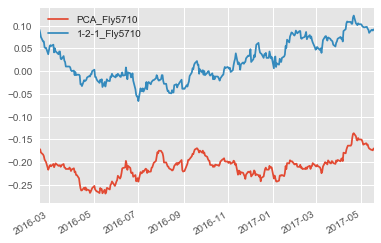

Mean Reversion characteristics for PCA Fly
{'Average': -0.21029006086639199, 'half-life': 27.429024356204675, 'Current_Displacement From Average (Avg - Current)': 0.0025606421913411392, 'R-squared': 0.01262964907970987}


NET
[u'NETHER 2.25 07/15/22 Govt__YLD_YTM_MID', u'NETHER 2 07/15/24 Govt__YLD_YTM_MID', u'NETHER 0.5 07/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.72488063  2.         -1.28116033]


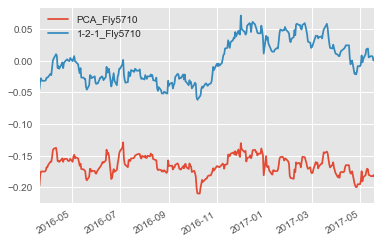

Mean Reversion characteristics for PCA Fly
{'Average': -0.16581571811204313, 'half-life': 6.1117451046795335, 'Current_Displacement From Average (Avg - Current)': 0.010570532341154487, 'R-squared': 0.05631560271771141}


FIN
[u'RFGB 1.625 09/15/22 Govt__YLD_YTM_MID', u'RFGB 2 04/15/24 Govt__YLD_YTM_MID', u'RFGB 0.5 04/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-0.82224142  2.         -1.17035577]


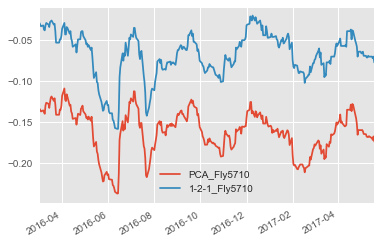

Mean Reversion characteristics for PCA Fly
{'Average': -0.16138654419186566, 'half-life': 18.189771588066211, 'Current_Displacement From Average (Avg - Current)': 0.043291860022200257, 'R-squared': 0.018888911110790385}


IRE
[u'IRISH 0.8 03/15/22 Govt__YLD_YTM_MID', u'IRISH 3.4 03/18/24 Govt__YLD_YTM_MID', u'IRISH 1 05/15/26 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.24050106  2.         -0.99850417]


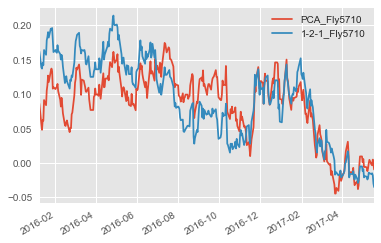

Mean Reversion characteristics for PCA Fly
{'Average': 0.084770752988954229, 'half-life': 17.4631879323919, 'Current_Displacement From Average (Avg - Current)': 0.021777315428363281, 'R-squared': 0.019913343619718082}


GER
[u'OBL 1 02/22/19 168 Govt__YLD_YTM_MID', u'DBR 2 01/04/22 Govt__YLD_YTM_MID', u'DBR 2.5 08/15/46 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.99822856  2.         -0.51151494]


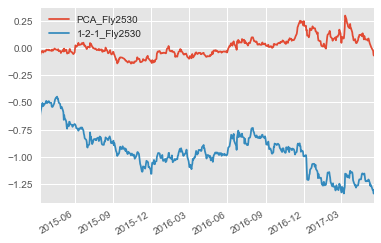

Mean Reversion characteristics for PCA Fly
{'Average': 0.0088487681905463494, 'half-life': 39.20079437219897, 'Current_Displacement From Average (Avg - Current)': -0.05889272848756745, 'R-squared': 0.0089491836213407838}


FRA
[u'FRTR 1 05/25/19 Govt__YLD_YTM_MID', u'FRTR 3.25 10/25/21 Govt__YLD_YTM_MID', u'FRTR 3.25 05/25/45 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-2.09743765  2.         -0.42602463]


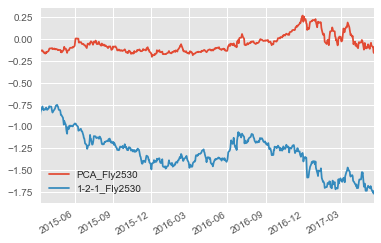

Mean Reversion characteristics for PCA Fly
{'Average': -0.05175318368301178, 'half-life': 40.079820486559001, 'Current_Displacement From Average (Avg - Current)': -0.17165191870289548, 'R-squared': 0.0082985760156180088}


BEL
[u'BGB 4 03/28/19 55 Govt__YLD_YTM_MID', u'BGB 4.25 09/28/22 65 Govt__YLD_YTM_MID', u'BGB 1.6 06/22/47 78 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-2.23312954  2.         -0.53341077]


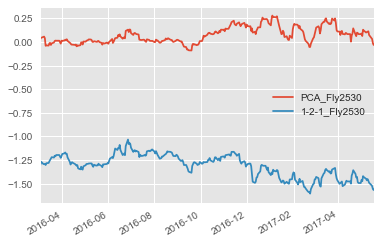

Mean Reversion characteristics for PCA Fly
{'Average': 0.069528316731353401, 'half-life': 16.288568063312702, 'Current_Displacement From Average (Avg - Current)': -0.078501515321273585, 'R-squared': 0.021711057840202552}


ESP
[u'SPGB 2.75 04/30/19 Govt__YLD_YTM_MID', u'SPGB 5.85 01/31/22 Govt__YLD_YTM_MID', u'SPGB 2.9 10/31/46 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-2.21614184  2.         -0.48527222]


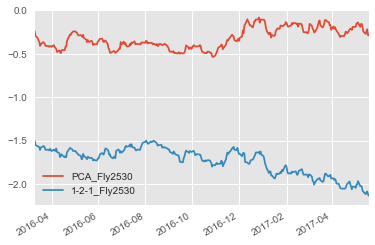

Mean Reversion characteristics for PCA Fly
{'Average': -0.31792107742049691, 'half-life': 30.505087739828614, 'Current_Displacement From Average (Avg - Current)': -0.17322007739337131, 'R-squared': 0.011138092625320062}


PTE
[u'PGB 4.75 06/14/19 Govt__YLD_YTM_MID', u'PGB 2.2 10/17/22 Govt__YLD_YTM_MID', u'PGB 4.1 02/15/45 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.65743234  2.         -0.86395646]


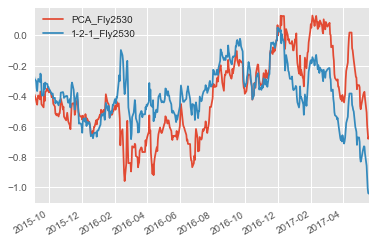

Mean Reversion characteristics for PCA Fly
{'Average': -0.40530198291341307, 'half-life': 34.436775036390969, 'Current_Displacement From Average (Avg - Current)': -0.49034817521626067, 'R-squared': 0.010296383873574677}


UKT
[u'UKT 1.75 07/22/19 Govt__YLD_YTM_MID', u'UKT 0.5 07/22/22 Govt__YLD_YTM_MID', u'UKT 1.5 07/22/47 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.37816328  2.         -0.95647937]


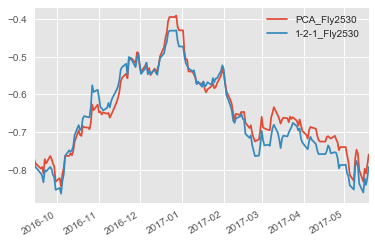

Mean Reversion characteristics for PCA Fly
{'Average': -0.64339623837189031, 'half-life': 47.256866922952604, 'Current_Displacement From Average (Avg - Current)': 0.0074536038781438663, 'R-squared': 0.0073732069137140144}


ITL
[u'BTPS 2.5 05/01/19 Govt__YLD_YTM_MID', u'BTPS 5 03/01/22 Govt__YLD_YTM_MID', u'BTPS 3.25 09/01/46 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.80729449  2.         -0.6976155 ]


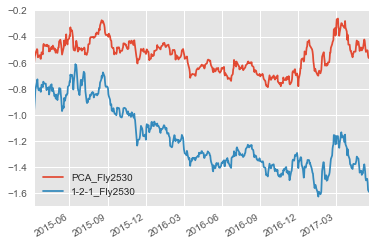

Mean Reversion characteristics for PCA Fly
{'Average': -0.54801472635493909, 'half-life': 34.440692334672441, 'Current_Displacement From Average (Avg - Current)': 0.061854918875615228, 'R-squared': 0.010093634702870058}


AUT
[u'RAGB 4.35 03/15/19 Govt__YLD_YTM_MID', u'RAGB 3.65 04/20/22 Govt__YLD_YTM_MID', u'RAGB 1.5 02/20/47 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-2.06121205  2.         -0.47116767]


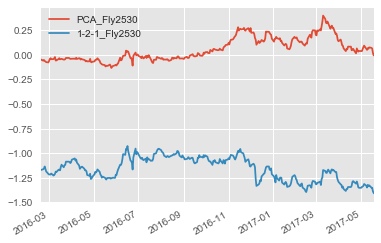

Mean Reversion characteristics for PCA Fly
{'Average': 0.053825313613246065, 'half-life': 41.116513358842425, 'Current_Displacement From Average (Avg - Current)': -0.081916769611002013, 'R-squared': 0.0083918180074445958}


NET
[u'NETHER 4 07/15/19 Govt__YLD_YTM_MID', u'NETHER 2.25 07/15/22 Govt__YLD_YTM_MID', u'NETHER 2.75 01/15/47 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.90350621  2.         -0.55808771]


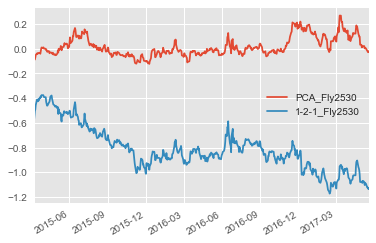

Mean Reversion characteristics for PCA Fly
{'Average': 0.019803666570218259, 'half-life': 23.666220167203353, 'Current_Displacement From Average (Avg - Current)': -0.032471566342658909, 'R-squared': 0.014568419612784211}


FIN
[u'RFGB 4.375 07/04/19 Govt__YLD_YTM_MID', u'RFGB 1.625 09/15/22 Govt__YLD_YTM_MID', u'RFGB 2.625 07/04/42 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-1.85113095  2.         -0.60856127]


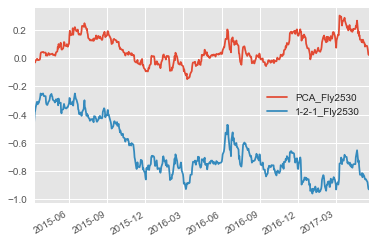

Mean Reversion characteristics for PCA Fly
{'Average': 0.066783136962988099, 'half-life': 32.213279034314368, 'Current_Displacement From Average (Avg - Current)': -0.067075483227180377, 'R-squared': 0.010662374980834555}


IRE
[u'IRISH 4.5 10/18/18 Govt__YLD_YTM_MID', u'IRISH 0.8 03/15/22 Govt__YLD_YTM_MID', u'IRISH 2 02/18/45 Govt__YLD_YTM_MID']
Weights of PCA Butterfly
[-2.6160114   2.         -0.57697139]


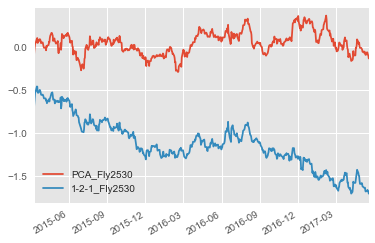

Mean Reversion characteristics for PCA Fly
{'Average': 0.042088578960936276, 'half-life': 19.75266078559503, 'Current_Displacement From Average (Avg - Current)': -0.17099548737221143, 'R-squared': 0.017410592359759502}




In [45]:
#Part 1 - All Fly Structures - PCA and 1-2-1 - all countries and butterfly structures - YTM

fly_list_master = [[2, 5, 10],[5,7,10],[2, 5, 30]]

indb = []
for ind3 in fly_list_master:
    ind4 = 'PCA-Fly'+''.join([str(x1) for x1 in ind3])
    indb.append(ind4)
zd1 = np.array(fly_list_master)

import matplotlib.pyplot as plt
plt.style.use('ggplot')
fly_country_dict = {key:np.nan for key in list(headers.columns)}
pca_fly_country_dict = {key:np.nan for key in list(headers.columns)}
pcadista = pd.DataFrame(  columns = headers.columns)
ind1 = -1
for strlist in fly_list_master:
    fly_list = strlist
    ind1 = ind1+1
    for country in fly_country_dict.keys()[:]:
        tickerlist = [headers.loc[str(x)+'Y',country] for x in fly_list]
        metric = 'YLD_YTM_MID'
        tickerlist = [x+' Govt__'+metric for x in tickerlist]
        print country
        print tickerlist

        try:
            pca_fly_country_dict[country] = pd.DataFrame(trade_pca_calc(ret_df,tickerlist).dropna(), columns = ['PCA_Fly'+''.join([str(x) for x in fly_list])])
            #print pca_fly_country_dict[country]
            fly_country_dict[country] = pd.DataFrame(trade_calc(ret_df,tickerlist).dropna(),columns = ['1-2-1_Fly'+''.join([str(x) for x in fly_list])])
            ax = pca_fly_country_dict[country].plot(legend = True)
            fly_country_dict[country].plot(legend = True, ax = ax)
            plt.show()
            (alpha, theta, r_squared) = mean_reversion(pca_fly_country_dict[country])
            print 'Mean Reversion characteristics for PCA Fly'
            #print alpha, theta, float(pca_curve_country_dict[country].iloc[-1,:])
            print {'half-life':np.log(2)/alpha,'Average':theta
                                ,'Current_Displacement From Average (Avg - Current)':theta - float(pca_fly_country_dict[country].iloc[-1,:])
                               , 'R-squared':r_squared}
            temp1 = [round(theta,4), round((theta - float(pca_fly_country_dict[country].iloc[-1,:])),4), round((theta - float(pca_fly_country_dict[country].iloc[-1,:]))/ theta,4) ]
            pcadista.loc[ind1,str(country)]=temp1
            #pcadista = pd.DataFrame()
            print '\n'
           
                
            #axes = sns.tsplot(pca_fly_country_dict[country].dropna())
            #axes1 = sns.tsplot(fly_country_dict[country].dropna())
            #plt.legend([axes.plot,axes1.plot],[country+'pca',country+'1-2-1'])
        except:
            print "Did not work"


In [46]:
pcadista['flys'] = indb
pcadistan = pcadista.set_index('flys')
pcadistan

,GER,NET,FIN,AUT,FRA,BEL,IRE,ESP,ITL,PTE,UKT
flys,,,,,,,,,,,
PCA-Fly2510,"[0.0214, -0.0197, -0.9194]","[-0.1098, 0.0728, -0.6628]","[-0.2125, 0.0159, -0.0747]","[-0.1929, 0.0195, -0.1011]","[0.0113, -0.0725, -6.417]","[-0.0572, -0.0275, 0.4809]","[-0.1513, 0.0088, -0.0579]","[-0.155, -0.118, 0.7612]","[-0.0547, 0.1024, -1.8712]","[-0.1664, -0.1327, 0.7978]","[-0.1639, 0.0082, -0.05]"
PCA-Fly5710,"[-0.1773, -0.0307, 0.1734]","[-0.1658, 0.0106, -0.0637]","[-0.1614, 0.0433, -0.2682]","[-0.2103, 0.0026, -0.0122]","[-0.1395, -0.0304, 0.2177]","[-0.0696, -0.0511, 0.7352]","[0.0848, 0.0218, 0.2569]","[0.0052, 0.0524, 10.0046]","[0.0223, 0.0436, 1.9517]","[-0.0783, -0.0379, 0.4844]","[-0.3381, 0.0483, -0.143]"
PCA-Fly2530,"[0.0088, -0.0589, -6.6555]","[0.0198, -0.0325, -1.6397]","[0.0668, -0.0671, -1.0044]","[0.0538, -0.0819, -1.5219]","[-0.0518, -0.1717, 3.3167]","[0.0695, -0.0785, -1.1291]","[0.0421, -0.171, -4.0628]","[-0.3179, -0.1732, 0.5449]","[-0.548, 0.0619, -0.1129]","[-0.4053, -0.4903, 1.2098]","[-0.6434, 0.0075, -0.0116]"


In [47]:
highbetafly = []

In [48]:
#Intra-Country flies regressions for both PCA and 1-2-1 weighted flies

def realign_dates(df_list):
    df_list = [pd.DataFrame(x) for x in df_list]
    master_df = df_list[0]
    for x in df_list[1:]:
        master_df = master_df.merge(x, how = 'outer', left_index = True, right_index = True)
    
    master_df = master_df.dropna()
    df_list = [master_df[col] for col in master_df.columns]
    return df_list
    
def ret_regression(ret_df,Ylist,Y_country,Xlist,X_country, metric = 'YLD_YTM_MID', del_changes = True):
    
    print metric
    ds1 = Y_country
    ds2 = X_country
    Y_tickerlist = [headers.loc[str(x)+'Y',Y_country]+' Govt__'+metric for x in Ylist]
    X_tickerlist = [headers.loc[str(x)+'Y',X_country]+' Govt__'+metric for x in Xlist]
    
    Y_country = Y_country+''.join([str(x) for x in  Ylist])
    X_country = X_country+''.join([str(x) for x in Xlist])
    
    if Y_country == X_country:
        print "Regression Not Possible"
        return 0.
    
    fly_country_dict = {key:np.nan for key in [Y_country,X_country]}
    pca_fly_country_dict = {key:np.nan for key in [Y_country,X_country]}
    

    try:
        print Y_country+' PCA_Fly Weights'
        pca_fly_country_dict[Y_country] = pd.DataFrame(trade_pca_calc(ret_df,Y_tickerlist).dropna()
                                                       , columns = [Y_country+'PCA_Fly'])
        print X_country+' PCA_Fly Weights'
        pca_fly_country_dict[X_country] = pd.DataFrame(trade_pca_calc(ret_df,X_tickerlist).dropna()
                                                       , columns = [X_country+'PCA_Fly'])
        
        fly_country_dict[Y_country] = pd.DataFrame(trade_calc(ret_df,Y_tickerlist).dropna()
                                                   ,columns = [Y_country+'1-2-1_Fly'])
        fly_country_dict[X_country] = pd.DataFrame(trade_calc(ret_df,X_tickerlist).dropna()
                                                   ,columns = [X_country+'1-2-1_Fly'])
        
    except:
        print "Did not work at data referencing level"
        return 0.
    if del_changes:
        lm = sk.linear_model.LinearRegression(fit_intercept=False)
        lm_1= sk.linear_model.LinearRegression(fit_intercept=False)
        # We want to fit the model Del Fly1 ~ Del Fly2
        
        
        
        print 'Regression time series'
        plt.show()
        Y = pca_fly_country_dict[Y_country] - pca_fly_country_dict[Y_country].shift(1)
        Y = Y.dropna()
        X = pca_fly_country_dict[X_country] - pca_fly_country_dict[X_country].shift(1)
        X = X.dropna()
        input_list = realign_dates([Y,X])
        Y = np.array(input_list[0]).reshape((-1,1)); X = np.array(input_list[1]).reshape((-1,1))
        
        
        Yp = pca_fly_country_dict[Y_country] #
        Xp = pca_fly_country_dict[X_country] #
        
       
        
        #model = sm.OLS(Y,X,hasconst = True)
        #results = model.fit()
        lm.fit(X = X, y = Y)
        
        Y_1 = fly_country_dict[Y_country] - fly_country_dict[Y_country].shift(1)
        Y_1 = Y_1.dropna()
        X_1 = fly_country_dict[X_country] - fly_country_dict[X_country].shift(1)
        X_1 = X_1.dropna()
        
        
        Yp1 = fly_country_dict[Y_country] #
        Xp1 = fly_country_dict[X_country] # 
        
       
        
        input_list = realign_dates([Y_1,X_1])
        Y_1 = np.array(input_list[0]).reshape((-1,1)); X_1 = np.array(input_list[1]).reshape((-1,1))
        lm_1.fit(X =X_1,y=Y_1)
        #return results
        if (abs(lm.coef_[0][0])> 0.6) and (abs(lm_1.coef_[0][0])> 0.6):
            print('\x1b[6;30;42m' + 'High Beta' + '\x1b[0m')
        return {'PCA':{'beta':lm.coef_[0][0], 'r2-score':sk_m.r2_score(Y,lm.predict(X))},
                '1-2-1':{'beta':lm_1.coef_[0][0], 'r2-score':sk_m.r2_score(Y_1,lm_1.predict(X_1))}}
    else:
        lm = sk.linear_model.LinearRegression()
        Y = pca_fly_country_dict[Y_country]
        X = pca_fly_country_dict[X_country]
        input_list = realign_dates([Y,X])
        Y = np.array(input_list[0]).reshape((-1,1)); X = np.array(input_list[1]).reshape((-1,1))
        lm.fit(X = X, y = Y)
        return {'beta':lm.coef_[0][0], 'intercept':lm.intercept_[0][0],'r2-score':sk_m.r2_score(Y,lm.predict(X))}



In [49]:
#Part 1 - b - Regressing Various Fly Structures with each other
print 'Check 2-5-10 vs 3-5-7 as both are medium tenors'

Ylistm = [[3,5,7], [2,3,5], [5,7,10],[3,5,7]]
Xlistm = [[2,5,10],[5,10,30],[2,10,30],[5,7,10]]

indb1b = []
for ind3a, ind3b in zip(Ylistm, Xlistm):
    ind4a = 'PCA-Fly'+''.join([str(x1) for x1 in ind3a]) + 'vs'.join([str(x2) for x2 in ind3b])
    indb1b.append(ind4a)
#zd1 = np.array(fly_list_master)
pcadista1b = pd.DataFrame(  columns = headers.columns)
ind2 = -1
for Ylist, Xlist in zip(Ylistm, Xlistm):
    ind2 = ind2+1
    for country in list(headers.columns):
        print 'Regression Results'
        zo = ret_regression(ret_df,Ylist,country,Xlist,country)
        print zo
        #print zo['PCA']['beta']
        temp12 = [round(zo['PCA']['beta'],4), round(zo['PCA']['r2-score'],4), round(zo['1-2-1']['beta'],4), round(zo['1-2-1']['r2-score'],4) ]

        pcadista1b.loc[ind2,str(country)]=temp12
        print '\n'
        #print ret_regression_Zspread(ret_df,Ylist,country,Xlist,country)
        #print '\n'

        #Decent Correlation, Beta

Check 2-5-10 vs 3-5-7 as both are medium tenors
Regression Results
YLD_YTM_MID
GER357 PCA_Fly Weights
Weights of PCA Butterfly
[-1.09593197  2.         -0.96827106]
GER2510 PCA_Fly Weights
Weights of PCA Butterfly
[-1.4353657   2.         -0.88945755]
Regression time series
{'PCA': {'beta': 0.56187274673234733, 'r2-score': 0.71238302876821091}, '1-2-1': {'beta': 0.4317512508934952, 'r2-score': 0.55520096313655931}}


Regression Results
YLD_YTM_MID
NET357 PCA_Fly Weights
Weights of PCA Butterfly
[-1.01044628  2.         -1.03213592]
NET2510 PCA_Fly Weights
Weights of PCA Butterfly
[-1.27268363  2.         -0.97162851]
Regression time series
{'PCA': {'beta': 0.51982160768629571, 'r2-score': 0.68376213923322648}, '1-2-1': {'beta': 0.52231527259274202, 'r2-score': 0.71701792609623527}}


Regression Results
YLD_YTM_MID
FIN357 PCA_Fly Weights
Weights of PCA Butterfly
[-0.81055963  2.         -1.25869055]
FIN2510 PCA_Fly Weights
Weights of PCA Butterfly
[-0.97284809  2.         -1.06136328]
R

In [50]:
pcadista1b['flys'] = indb1b
pcadistan1b = pcadista1b.set_index('flys')
pcadistan1b

,GER,NET,FIN,AUT,FRA,BEL,IRE,ESP,ITL,PTE,UKT
flys,,,,,,,,,,,
PCA-Fly3572vs5vs10,"[0.5619, 0.7124, 0.4318, 0.5552]","[0.5198, 0.6838, 0.5223, 0.717]","[0.4553, 0.5303, 0.4811, 0.5246]","[0.4483, 0.5989, 0.5271, 0.7098]","[0.4237, 0.5953, 0.4479, 0.6606]","[0.3709, 0.5519, 0.3233, 0.5052]","[0.4092, 0.3578, 0.3696, 0.3593]","[0.3804, 0.413, 0.1802, 0.1861]","[0.6216, 0.5852, 0.6203, 0.5618]","[0.4089, 0.3506, 0.3937, 0.373]","[0.6121, 0.5595, 0.5717, 0.4433]"
PCA-Fly2355vs10vs30,"[0.0301, 0.0048, -0.0659, 0.0233]","[0.0123, 0.0006, -0.041, 0.0088]","[-0.055, 0.0155, -0.0749, 0.0261]","[-0.0438, 0.0131, -0.022, 0.0045]","[0.0491, 0.0091, -0.0039, -0.0004]","[-0.0847, 0.0286, -0.0392, 0.0067]","[-0.0453, 0.0024, -0.0738, 0.0081]","[-0.039, 0.0063, -0.0765, 0.0272]","[0.0449, 0.0089, -0.0224, 0.002]","[-0.0528, 0.0022, -0.0667, 0.0051]","[0.1447, 0.0729, -0.0089, -0.0166]"
PCA-Fly57102vs10vs30,"[-0.0394, 0.0265, 0.0015, 0.0]","[0.0144, 0.0025, 0.0785, 0.0576]","[0.0033, 0.0001, 0.0554, 0.0357]","[-0.0063, 0.0009, 0.1061, 0.1438]","[-0.0048, 0.0003, 0.1179, 0.1538]","[0.0457, 0.0208, 0.0594, 0.0416]","[-0.0174, 0.0014, 0.1429, 0.1039]","[0.0585, 0.0196, 0.1669, 0.2016]","[0.0493, 0.019, 0.0936, 0.1209]","[-0.0148, 0.0006, 0.0577, 0.0163]","[-0.0231, 0.0051, 0.1588, 0.3094]"
PCA-Fly3575vs7vs10,"[-0.4168, 0.0781, -0.5135, 0.1508]","[-0.3472, 0.0796, -0.4529, 0.1761]","[-0.6234, 0.2458, -0.6024, 0.2181]","[-0.4708, 0.0995, -0.7531, 0.4026]","[-0.2004, 0.0168, -0.7093, 0.2494]","[-0.3511, 0.098, -0.4009, 0.1252]","[-0.5753, 0.2364, -0.3942, 0.1587]","[-0.384, 0.1432, -0.4675, 0.2899]","[-0.6791, 0.2913, -0.5809, 0.2277]","[-0.7017, 0.3336, -0.6671, 0.3585]","[-0.8884, 0.4343, -0.7123, 0.4124]"


In [52]:
#Part 1 - All Country Regressions For Same Butterfly Structures
#Inter-Country flies regression
fly_country_dict1 = {key:np.nan for key in list(headers.columns)}
#for cn in headers.columns:
len1 = len(headers.columns)    
compare_fly_list = [[2,3,5],[5,7,10],[5,10,30]]
indb1b = []
ind3 = -1
pcadista1c = {}
for ind3a in compare_fly_list:
    ind4a = 'PCA-Fly'+''.join([str(x1) for x1 in ind3a]) 
    ind3 = ind3 +1
    #pcadista1c = pd.DataFrame(  columns = headers.columns)
    #indb1b.append(ind4a)
    pcadista1c[ind3] = pd.DataFrame(  columns = headers.columns)

for con in headers.columns:
    indb1b.append(str(con))
    
#print str(headers.columns[0])


ind2 = -1
df1 = pd.DataFrame(np.nan, index = range(len1,len1+1), columns=headers.columns)
#X_country = str(headers.columns[0])
for cn1 in range(0,len1-1):
    X_country = str(headers.columns[cn1])
    for cn2 in range(cn1+1,len1):
    #X_country = 'GER'
        Y_country = str(headers.columns[cn2])
        compare_fly_list = [[2,3,5],[5,7,10],[5,10,30]]
        ind5 = -1
        for fly in compare_fly_list:
            ind5 = ind5 +1
            print '\n'
            print 'Regression Results - ' +','.join([str(x) for x in fly]) 
            zo = ret_regression(ret_df,fly,Y_country,fly,X_country)
            print zo
            temp12 = [round(zo['PCA']['beta'],4), round(zo['PCA']['r2-score'],4), round(zo['1-2-1']['beta'],4), round(zo['1-2-1']['r2-score'],4) ]
            pcadista1c[ind5].loc[cn1+1,Y_country]=temp12

#ind6 = -1
#for fly in compare_fly_list:
#    ind6 = ind6+1
#    pcadista1c[ind6].append(df1)


#Germany vs UK

#Germany vs Netherlands


#Portugal vs Italy




Regression Results - 2,3,5
YLD_YTM_MID
NET235 PCA_Fly Weights
Weights of PCA Butterfly
[-1.4843026   2.         -0.63031783]
GER235 PCA_Fly Weights
Weights of PCA Butterfly
[-1.54897488  2.         -0.5379112 ]
Regression time series
{'PCA': {'beta': 0.18080829681405361, 'r2-score': 0.018741365175047875}, '1-2-1': {'beta': 0.63806321136299482, 'r2-score': 0.34084536732616744}}


Regression Results - 5,7,10
YLD_YTM_MID
NET5710 PCA_Fly Weights
Weights of PCA Butterfly
[-0.72488063  2.         -1.28116033]
GER5710 PCA_Fly Weights
Weights of PCA Butterfly
[-0.76475243  2.         -1.2171718 ]
Regression time series
{'PCA': {'beta': 0.075724663102155726, 'r2-score': 0.003245076826589588}, '1-2-1': {'beta': 0.23274511851310542, 'r2-score': 0.026654153597844732}}


Regression Results - 5,10,30
YLD_YTM_MID
NET51030 PCA_Fly Weights
Weights of PCA Butterfly
[-1.48061973  2.         -0.72168409]
GER51030 PCA_Fly Weights
Weights of PCA Butterfly
[-1.42956926  2.         -0.79828374]
Regression t

In [57]:
df1 = pd.DataFrame(np.nan, index = range(len1,len1+1), columns=headers.columns)

#pcadista1c[0].append(df1)
#pcadista1c[1].append(df1)
#pcadista1c[2].append(df1)
#pcadista1c[3].append(df1)


In [58]:
# Regression of curves vs the outrights levels of rates
import statsmodels.formula as smf
import statsmodels.tsa as smt
import statsmodels as sm
import scipy.stats as scs
import statsmodels.tsa.stattools as tools

def tsdiagnostics(y, lags=None, figsize=(10, 8), style='ggplot'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
        y = y.dropna()

    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        #pp_ax = plt.subplot2grid(layout, (2, 1))
        
        y.plot(ax=ts_ax)
        ts_ax.set_title('Time Series Analysis Plots')
        acf_mod = tools.acf(y,nlags = 40)
        acf_ax.bar(range(41), acf_mod, width = 0.5,color='r')
        acf_ax.set_title('ACF')
        sm.graphics.tsaplots.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)
        sm.graphics.gofplots.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')  
       # plt.show()
        #scs.probplot(np.array(y).ravel(), plot=pp_ax)#, sparams=(y.mean(), y.std())
        
        print 'ADF Tests'
        adf_test = adfuller(np.array(y), regression='c', autolag='AIC', store=False, regresults=False)
        
        print('ADF Statistic: %f' % adf_test[0])
        print('p-value: %f' % adf_test[1])
        print('Critical Values:')
        for key, value in adf_test[4].items():
            print('\t%s: %.3f' % (key, value))
        
        #hurst_exponent = 0.
        (alpha, theta, r_squared) = mean_reversion(y)
        #print y
        #print type(y)
        ynew = y.to_frame()
        #print ynew
        #print type(ynew)
        print 'Mean Reversion characteristics'
        print {'half-life':np.log(2)/alpha,'Average':theta
               ,'Current_Displacement':theta - float(ynew.iloc[-1,:])
               , 'R-squared':r_squared}
        
    #return adf_test
    

In [60]:
def portfolio_regression(ret_df,Ylist,Yweights,Y_country,Xlist,Xweights,X_country
                         , metric = 'YLD_YTM_MID', del_changes = True):
    if not isinstance(Y_country,list):
        Y_country = [Y_country]*len(Yweights)
    if not isinstance(X_country,list):
        X_country = [X_country]*len(Xweights)
        
    Y_tickerlist = [headers.loc[str(x)+'Y',country]+' Govt__'+metric for x,country in zip(Ylist,Y_country)]
    X_tickerlist = [headers.loc[str(x)+'Y',country]+' Govt__'+metric for x,country in zip(Xlist,X_country)]
    Y_country_label = ','.join([country+'_'+str(x) for x,country in  zip(Ylist,Y_country)])
    X_country_label = ','.join([country+'_'+str(x) for x,country in  zip(Xlist,X_country)])
    
   

    try:
        Y = pd.DataFrame(np.array(sum([ret_df[col]*weight for col,weight in zip(Y_tickerlist,Yweights)]))
                                                       , columns = [Y_country_label+'_portfolio_trade'])
        Y = Y.dropna()
        X = pd.DataFrame(np.array(sum([ret_df[col]*weight for col,weight in zip(X_tickerlist,Xweights)]))
                                                       , columns = [X_country_label+'_portfolio_trade'])
        X = X.dropna()
        
    except:
        print "Did not work at data referencing level"
        return 0.
    
    ax = Y.plot(legend = True)
    X.plot(legend = True, ax = ax)
    print 'Regression time series'
    plt.show()
    
    if del_changes:
        lm = sk.linear_model.LinearRegression(fit_intercept=False)
        # We want to fit the model Del Fly1 ~ Del Fly2
        
        Y = Y - Y.shift(1)
        Y = Y.dropna()
        X = X - X.shift(1)
        X = X.dropna()
        input_list = realign_dates([Y,X])
        Y = np.array(input_list[0]).reshape((-1,1)); X = np.array(input_list[1]).reshape((-1,1))
        
        
        
        
        
        #model = sm.OLS(Y,X,hasconst = True)
        #results = model.fit()
        lm.fit(X = X, y = Y)
        residuals = Y - lm.predict(X)
        residuals = residuals.reshape(-1)
        tsdiagnostics(residuals)
        plt.scatter(x=X,y=Y)
        plt.plot(X,np.array(lm.coef_).ravel()[0]*X , 'b')
        plt.show()
        return {'beta':np.array(lm.coef_).ravel(), 'r2-score':sk_m.r2_score(Y,lm.predict(X))}
    
    else:
        lm = sk.linear_model.LinearRegression()
        input_list = realign_dates([Y,X])
        Y = np.array(input_list[0]).reshape((-1,1)); X = np.array(input_list[1]).reshape((-1,1))
        lm.fit(X = X, y = Y)
        return {'beta':lm.coef_[0][0], 'intercept':lm.intercept_[0][0],'r2-score':sk_m.r2_score(Y,lm.predict(X))}

def ret_custom_portfolio(ret_df,Ylist,Yweights,Y_country
                         , metric = 'YLD_YTM_MID', del_changes = True):
    Y_tickerlist = [headers.loc[str(x)+'Y',Y_country]+' Govt__'+metric for x in Ylist]
    
    Y_country = Y_country+''.join([str(x) for x in  Ylist])
    
    try:
        cust_portfolio = pd.DataFrame(sum([ret_df[col]*weight for col,weight in zip(Y_tickerlist,Yweights)])
                                                       , columns = [Y_country+'_portfolio_trade'])
        cust_portfolio = cust_portfolio.dropna()
    except:
        print "Did not work at data referencing level"
        return 0.
    return cust_portfolio

GER
[u'OBL 1 02/22/19 168 Govt__YLD_YTM_MID', u'DBR 2 01/04/22 Govt__YLD_YTM_MID']
[-1.2139008  1.       ]
PCA Weighted and Regular Curve Plots


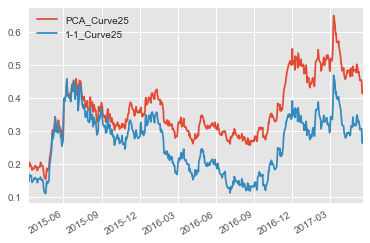

Mean Reversion characteristics for PCA curve
{'country': u'GER', 'Average': 0.36344223549116639, 'half-life': 49.013617333796574, 'R-squared': 0.0071244194808475214, 'Current_Displacement': -0.11952861832360351}
Rolling PCA Weights Plots


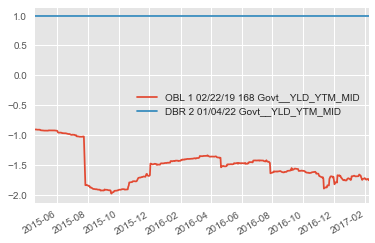

<class 'pandas.core.frame.DataFrame'>


GER 2,5 regression vs 5
Regression time series


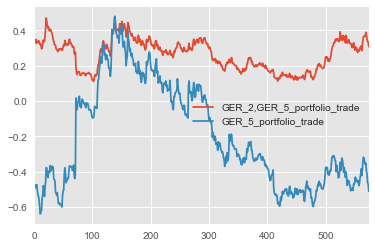

ADF Tests
ADF Statistic: -23.255066
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48641754688951777, 'Average': -2.3711562800129105e-05, 'half-life': 0.71185240548061146, 'Current_Displacement': 0.016548753819978917}


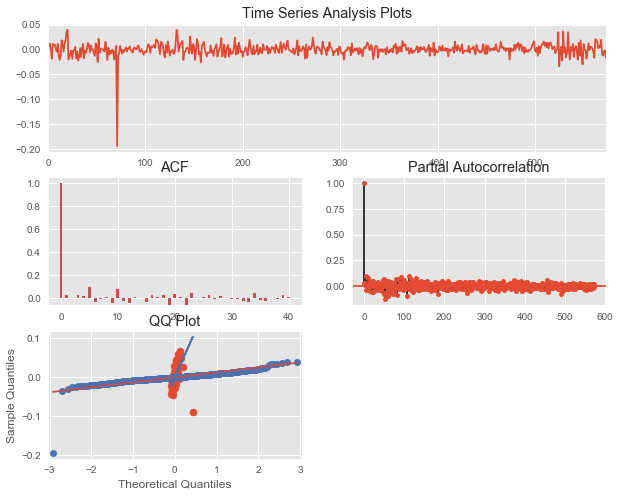

{'beta': array([ 0.24173166]), 'r2-score': 0.31139160157099188}
GER
[u'OBL 1 02/22/19 168 Govt__YLD_YTM_MID', u'DBR 0.5 02/15/26 Govt__YLD_YTM_MID']
[-1.64686658  1.        ]
PCA Weighted and Regular Curve Plots


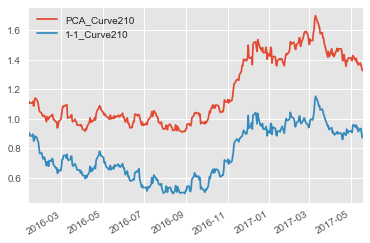

Mean Reversion characteristics for PCA curve
{'country': u'GER', 'Average': 1.1813846721831309, 'half-life': 89.509138220895068, 'R-squared': 0.0038418070766103041, 'Current_Displacement': -0.2927521870340497}
Rolling PCA Weights Plots


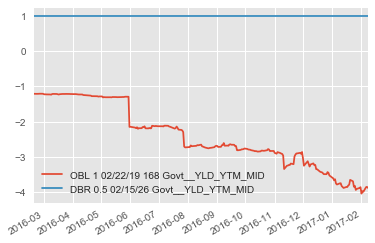

<class 'pandas.core.frame.DataFrame'>


GER 2,10 regression vs 10
Regression time series


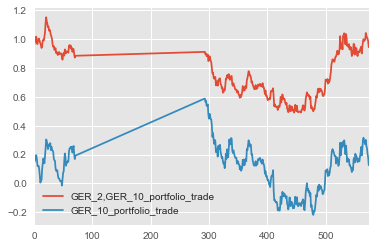

ADF Tests
ADF Statistic: -19.613384
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.52360525418380988, 'Average': -3.8602111346023433e-05, 'half-life': 0.66224803271868005, 'Current_Displacement': 0.015390507815080936}


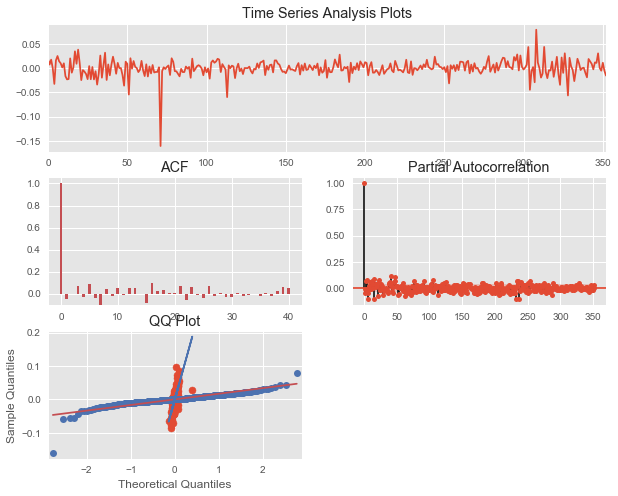

{'beta': array([ 0.473535]), 'r2-score': 0.56096761649903648}
GER
[u'DBR 2 01/04/22 Govt__YLD_YTM_MID', u'DBR 0.5 02/15/26 Govt__YLD_YTM_MID']
[-1.15015737  1.        ]
PCA Weighted and Regular Curve Plots


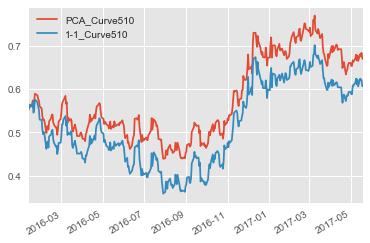

Mean Reversion characteristics for PCA curve
{'country': u'GER', 'Average': 0.57854996939723868, 'half-life': 53.850934925049138, 'R-squared': 0.0063109457030308125, 'Current_Displacement': -0.13503028726731658}
Rolling PCA Weights Plots


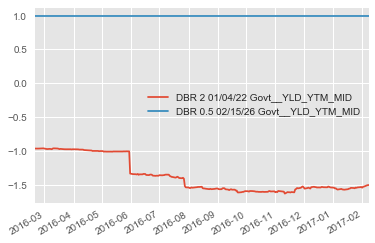

<class 'pandas.core.frame.DataFrame'>


GER 5,10 regression vs 10
Regression time series


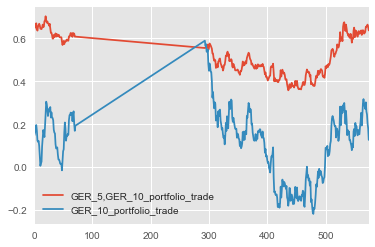

ADF Tests
ADF Statistic: -19.280913
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.51506997119737774, 'Average': -1.5083859236932655e-05, 'half-life': 0.67347992533935996, 'Current_Displacement': 0.0050933927657638434}


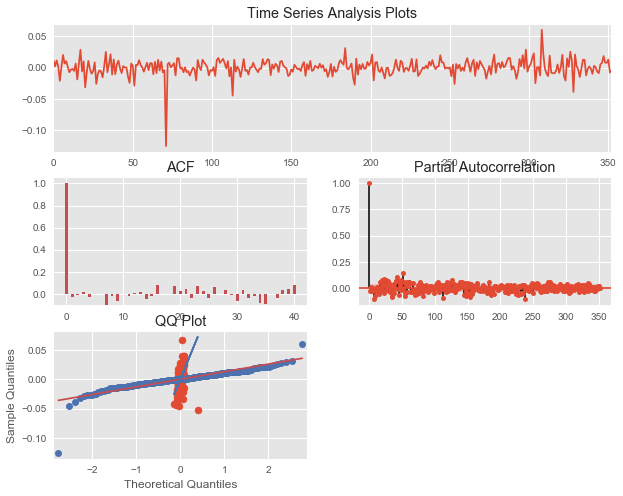

{'beta': array([ 0.18317636]), 'r2-score': 0.24480528073754804}
GER
[u'DBR 0.5 02/15/26 Govt__YLD_YTM_MID', u'DBR 2.5 08/15/46 Govt__YLD_YTM_MID']
[-1.14694585  1.        ]
PCA Weighted and Regular Curve Plots


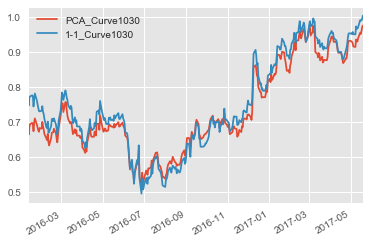

Mean Reversion characteristics for PCA curve
{'country': u'GER', 'Average': 0.73534946868832562, 'half-life': 45.961471861970587, 'R-squared': 0.0072433280480976858, 'Current_Displacement': -0.18798840864656308}
Rolling PCA Weights Plots


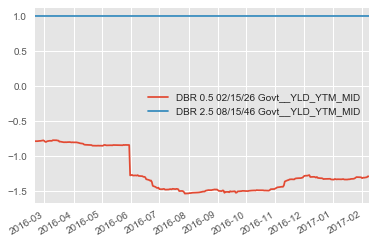

<class 'pandas.core.frame.DataFrame'>


GER 10,30 regression vs 30
Regression time series


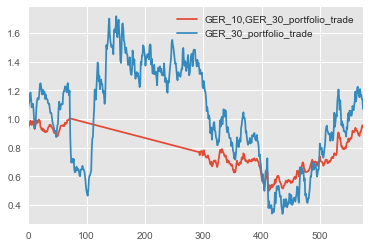

ADF Tests
ADF Statistic: -17.538373
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.4677571332307946, 'Average': 0.00015198039007317357, 'half-life': 0.74204104431594287, 'Current_Displacement': -0.006165781480202988}


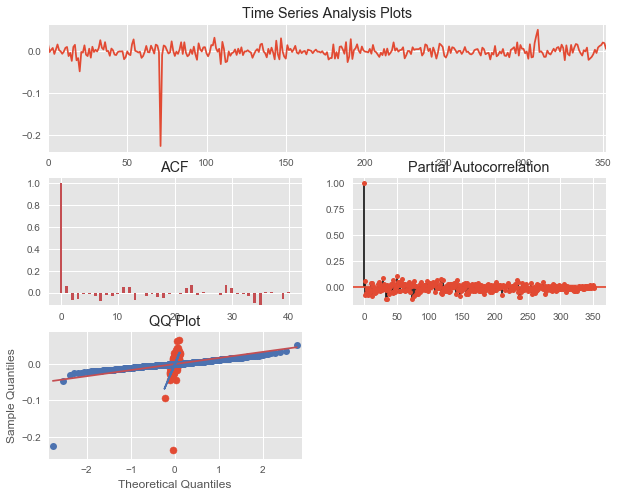

{'beta': array([ 0.2883248]), 'r2-score': 0.37276462939906918}
NET
[u'NETHER 4 07/15/19 Govt__YLD_YTM_MID', u'NETHER 2.25 07/15/22 Govt__YLD_YTM_MID']
[-1.19481906  1.        ]
PCA Weighted and Regular Curve Plots


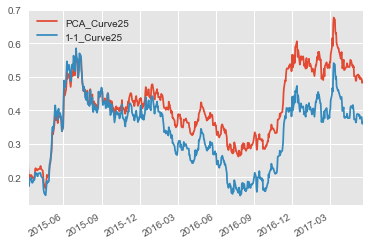

Mean Reversion characteristics for PCA curve
{'country': u'NET', 'Average': 0.41555647592105499, 'half-life': 49.349252065311269, 'R-squared': 0.0067662186014114667, 'Current_Displacement': -0.11067385865381923}
Rolling PCA Weights Plots


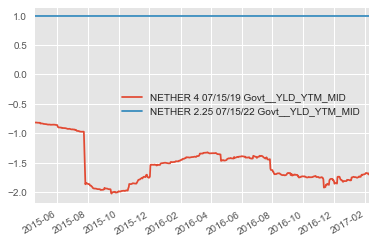

<class 'pandas.core.frame.DataFrame'>


NET 2,5 regression vs 5
Regression time series


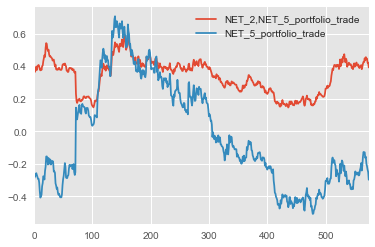

ADF Tests
ADF Statistic: -22.728652
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47498675712899086, 'Average': 3.2108093106815909e-05, 'half-life': 0.72881146936927543, 'Current_Displacement': 0.017518455162248599}


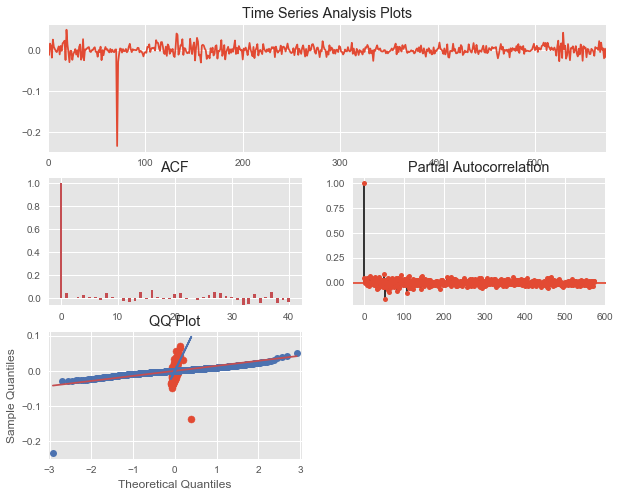

{'beta': array([ 0.24497134]), 'r2-score': 0.2730933429355521}
NET
[u'NETHER 4 07/15/19 Govt__YLD_YTM_MID', u'NETHER 0.5 07/15/26 Govt__YLD_YTM_MID']
[-1.85692872  1.        ]
PCA Weighted and Regular Curve Plots


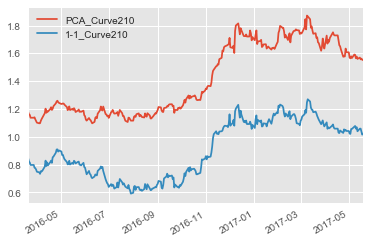

Mean Reversion characteristics for PCA curve
{'country': u'NET', 'Average': 1.4303415955482544, 'half-life': 83.965288503974534, 'R-squared': 0.0037829992569338167, 'Current_Displacement': -0.32808228946740248}
Rolling PCA Weights Plots


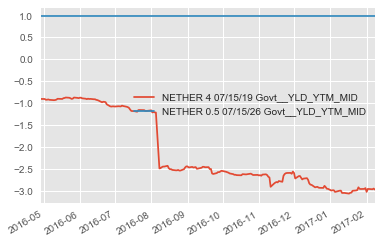

<class 'pandas.core.frame.DataFrame'>


NET 2,10 regression vs 10
Regression time series


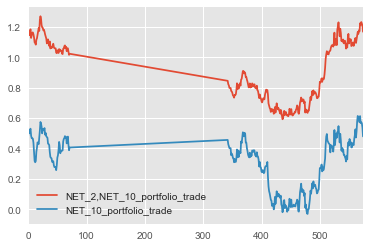

ADF Tests
ADF Statistic: -18.327872
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.52740641298593727, 'Average': 6.2599850365608511e-05, 'half-life': 0.6571414337043161, 'Current_Displacement': 0.0062298353452462521}


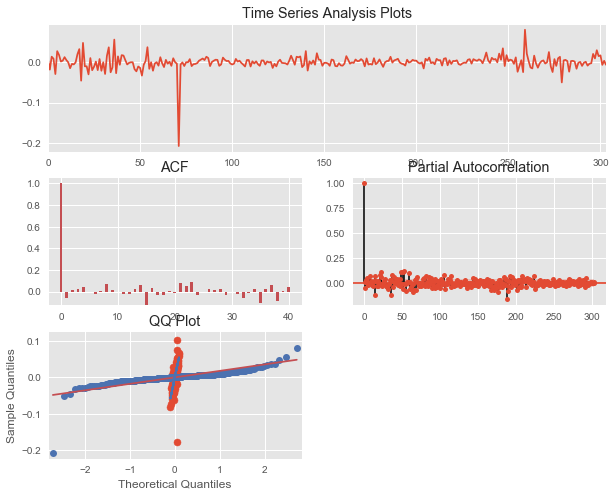

{'beta': array([ 0.59038584]), 'r2-score': 0.54398278754493301}
NET
[u'NETHER 2.25 07/15/22 Govt__YLD_YTM_MID', u'NETHER 0.5 07/15/26 Govt__YLD_YTM_MID']
[-1.23754581  1.        ]
PCA Weighted and Regular Curve Plots


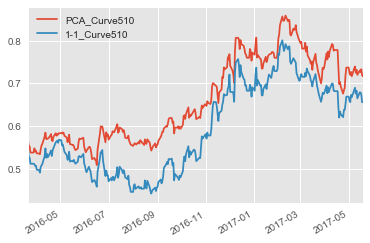

Mean Reversion characteristics for PCA curve
{'country': u'NET', 'Average': 0.65910766182071456, 'half-life': 50.4832124901356, 'R-squared': 0.0070351249277703642, 'Current_Displacement': -0.18744344505849031}
Rolling PCA Weights Plots


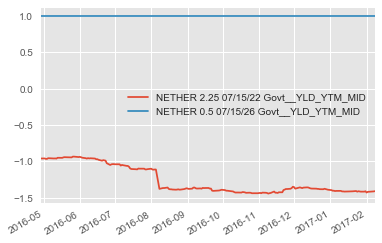

<class 'pandas.core.frame.DataFrame'>


NET 5,10 regression vs 10
Regression time series


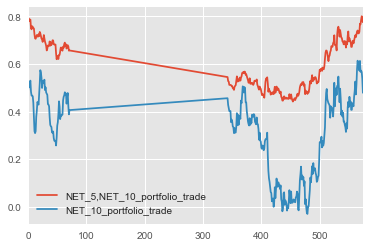

ADF Tests
ADF Statistic: -16.083921
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.4622047047491521, 'Average': -2.5692815197320205e-05, 'half-life': 0.74985272833417693, 'Current_Displacement': -0.0037212200291366279}


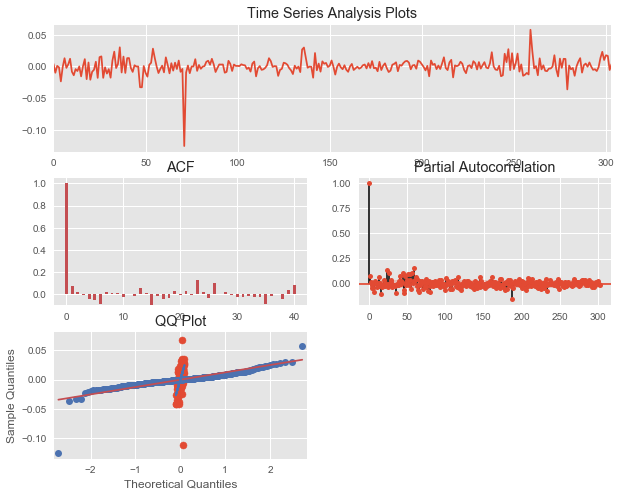

{'beta': array([ 0.26602588]), 'r2-score': 0.32640793616320007}
NET
[u'NETHER 0.5 07/15/26 Govt__YLD_YTM_MID', u'NETHER 2.75 01/15/47 Govt__YLD_YTM_MID']
[-1.41428423  1.        ]
PCA Weighted and Regular Curve Plots


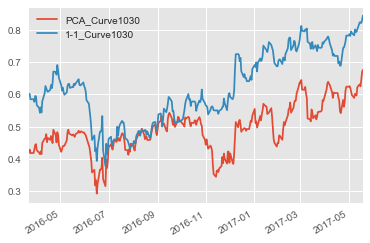

Mean Reversion characteristics for PCA curve
{'country': u'NET', 'Average': 0.49350657125873354, 'half-life': 12.811086952199053, 'R-squared': 0.027000350783689897, 'Current_Displacement': -0.021051282014400097}
Rolling PCA Weights Plots


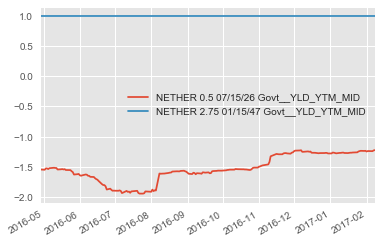

<class 'pandas.core.frame.DataFrame'>


NET 10,30 regression vs 30
Regression time series


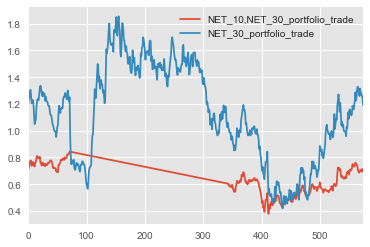

ADF Tests
ADF Statistic: -17.546609
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.50565254583159591, 'Average': -0.00021083618443211037, 'half-life': 0.6847277893785304, 'Current_Displacement': -0.016562598529526226}


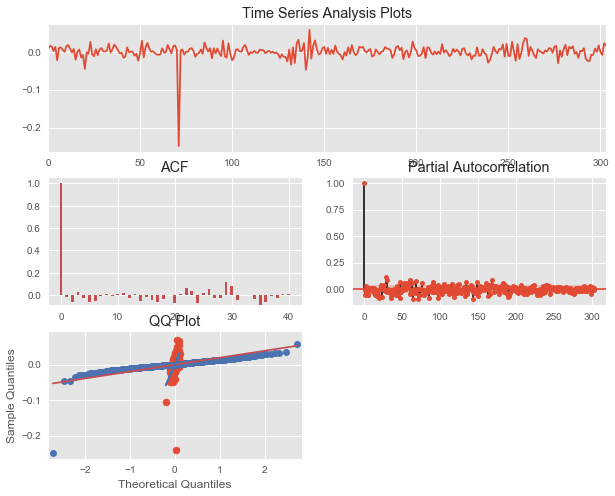

{'beta': array([ 0.28919604]), 'r2-score': 0.29168710929319219}
FIN
[u'RFGB 4.375 07/04/19 Govt__YLD_YTM_MID', u'RFGB 1.625 09/15/22 Govt__YLD_YTM_MID']
[-1.24586023  1.        ]
PCA Weighted and Regular Curve Plots


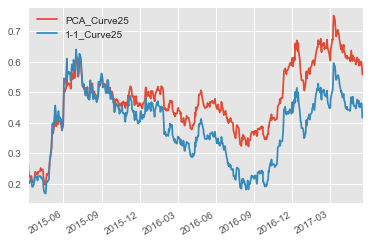

Mean Reversion characteristics for PCA curve
{'country': u'FIN', 'Average': 0.47793210967234856, 'half-life': 48.825942684235045, 'R-squared': 0.0069403868630857346, 'Current_Displacement': -0.1681228993252204}
Rolling PCA Weights Plots


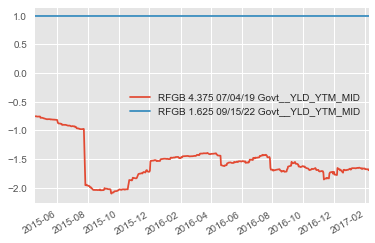

<class 'pandas.core.frame.DataFrame'>


FIN 2,5 regression vs 5
Regression time series


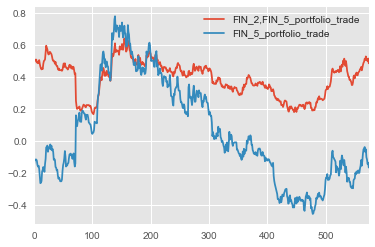

ADF Tests
ADF Statistic: -15.371852
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.4745576016739933, 'Average': -1.814929317756865e-05, 'half-life': 0.73013962885048034, 'Current_Displacement': 0.021225867521560068}


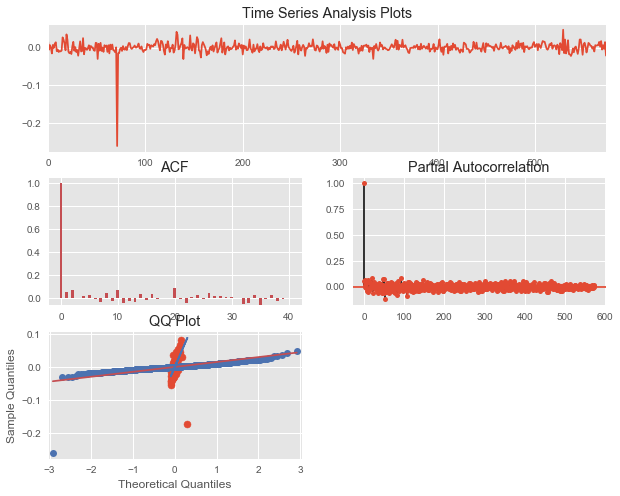

{'beta': array([ 0.29186611]), 'r2-score': 0.31563502959559075}
FIN
[u'RFGB 4.375 07/04/19 Govt__YLD_YTM_MID', u'RFGB 0.5 04/15/26 Govt__YLD_YTM_MID']
[-1.89838434  1.        ]
PCA Weighted and Regular Curve Plots


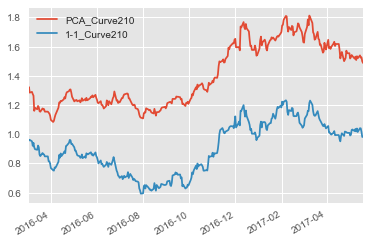

Mean Reversion characteristics for PCA curve
{'country': u'FIN', 'Average': 1.4129542457258466, 'half-life': 83.671873060591778, 'R-squared': 0.0037866828148938048, 'Current_Displacement': -0.32389396233033341}
Rolling PCA Weights Plots


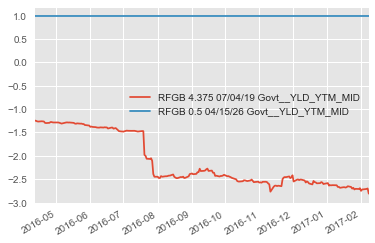

<class 'pandas.core.frame.DataFrame'>


FIN 2,10 regression vs 10
Regression time series


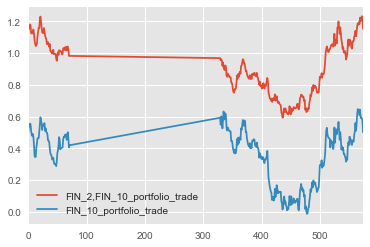

ADF Tests
ADF Statistic: -11.539644
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.51123075914770844, 'Average': 1.6871842726017094e-05, 'half-life': 0.67402139017845641, 'Current_Displacement': 0.031434839429607515}


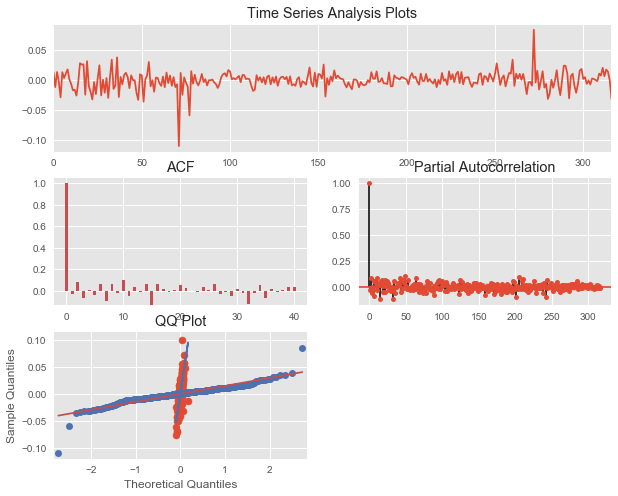

{'beta': array([ 0.55117189]), 'r2-score': 0.62415190418046951}
FIN
[u'RFGB 1.625 09/15/22 Govt__YLD_YTM_MID', u'RFGB 0.5 04/15/26 Govt__YLD_YTM_MID']
[-1.29321758  1.        ]
PCA Weighted and Regular Curve Plots


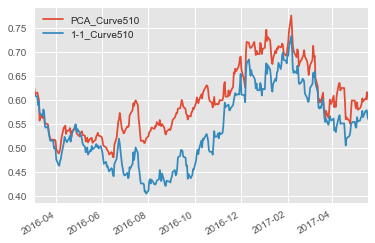

Mean Reversion characteristics for PCA curve
{'country': u'FIN', 'Average': 0.59720851859033008, 'half-life': 40.513635883824485, 'R-squared': 0.0081201026175055091, 'Current_Displacement': -0.11717238149330012}
Rolling PCA Weights Plots


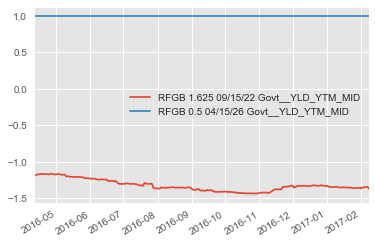

<class 'pandas.core.frame.DataFrame'>


FIN 5,10 regression vs 10
Regression time series


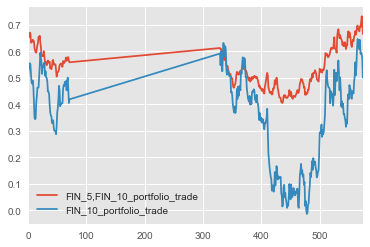

ADF Tests
ADF Statistic: -15.615059
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.43710455157554295, 'Average': 3.8390618324101484e-05, 'half-life': 0.78660043124303636, 'Current_Displacement': 0.021337680252081333}


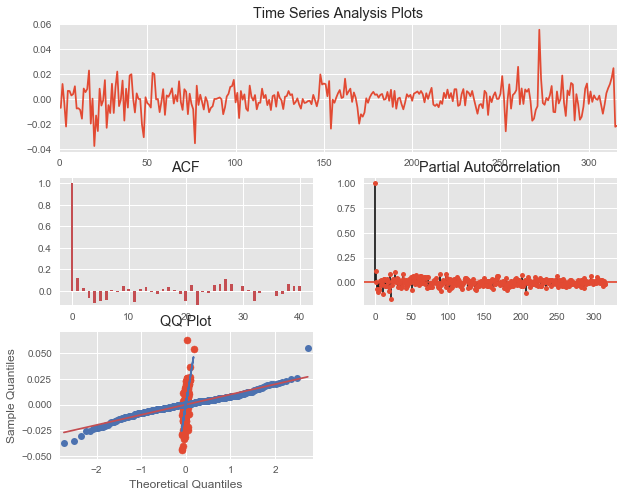

{'beta': array([ 0.26715301]), 'r2-score': 0.46567968766398693}
FIN
[u'RFGB 0.5 04/15/26 Govt__YLD_YTM_MID', u'RFGB 2.625 07/04/42 Govt__YLD_YTM_MID']
[-1.31160541  1.        ]
PCA Weighted and Regular Curve Plots


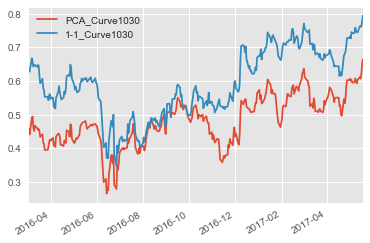

Mean Reversion characteristics for PCA curve
{'country': u'FIN', 'Average': 0.48182217521417287, 'half-life': 15.742784450835554, 'R-squared': 0.022043133600109788, 'Current_Displacement': -0.079063515868573353}
Rolling PCA Weights Plots


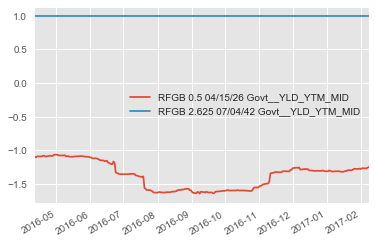

<class 'pandas.core.frame.DataFrame'>


FIN 10,30 regression vs 30
Regression time series


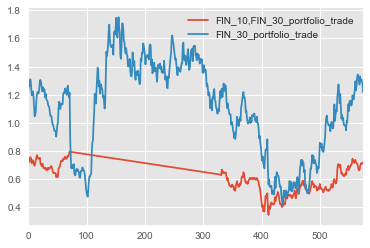

ADF Tests
ADF Statistic: -17.383952
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.49042665673055341, 'Average': -4.4307026722547136e-05, 'half-life': 0.70503518995528236, 'Current_Displacement': -0.021582517177245089}


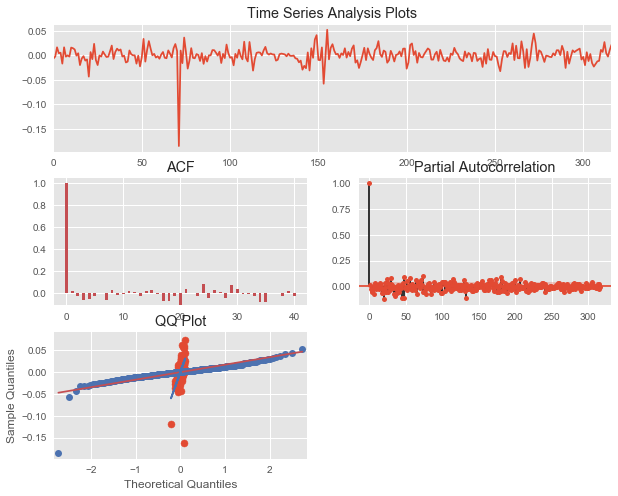

{'beta': array([ 0.28732662]), 'r2-score': 0.35069260755962139}
AUT
[u'RAGB 4.35 03/15/19 Govt__YLD_YTM_MID', u'RAGB 3.65 04/20/22 Govt__YLD_YTM_MID']
[-1.28249324  1.        ]
PCA Weighted and Regular Curve Plots


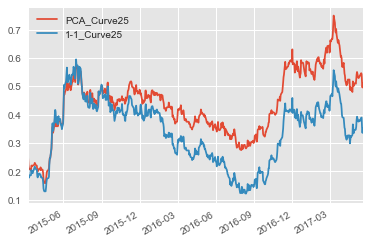

Mean Reversion characteristics for PCA curve
{'country': u'AUT', 'Average': 0.43830461300823709, 'half-life': 53.12886430565834, 'R-squared': 0.0064853452280566604, 'Current_Displacement': -0.13449106299899272}
Rolling PCA Weights Plots


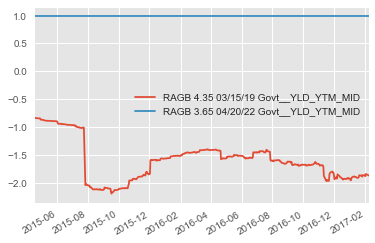

<class 'pandas.core.frame.DataFrame'>


AUT 2,5 regression vs 5
Regression time series


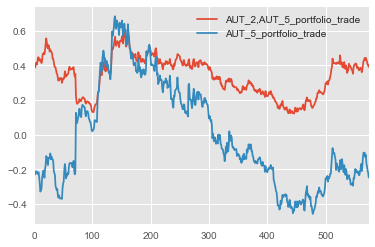

ADF Tests
ADF Statistic: -23.379516
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.4890845499172396, 'Average': 3.7180123143114729e-06, 'half-life': 0.70855222793901151, 'Current_Displacement': 0.0047579057160913292}


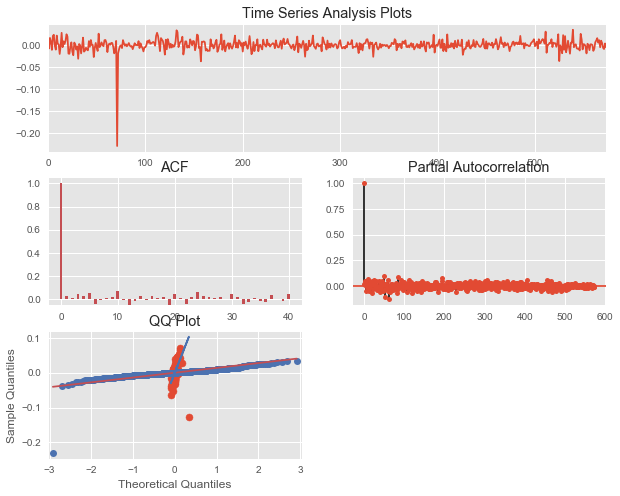

{'beta': array([ 0.30540046]), 'r2-score': 0.35655794463171653}
AUT
[u'RAGB 4.35 03/15/19 Govt__YLD_YTM_MID', u'RAGB 0.75 10/20/26 Govt__YLD_YTM_MID']
[-2.03376748  1.        ]
PCA Weighted and Regular Curve Plots


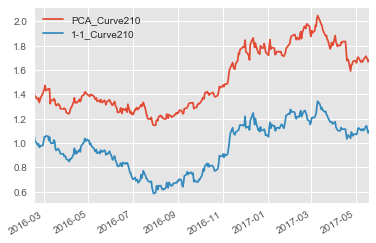

Mean Reversion characteristics for PCA curve
{'country': u'AUT', 'Average': 1.5234000946190838, 'half-life': 87.570625997563312, 'R-squared': 0.0038005616282814625, 'Current_Displacement': -0.3442110919828445}
Rolling PCA Weights Plots


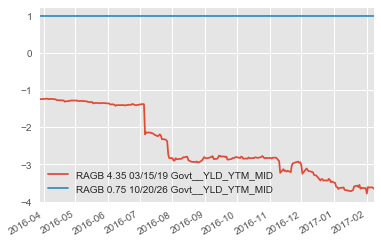

<class 'pandas.core.frame.DataFrame'>


AUT 2,10 regression vs 10
Regression time series


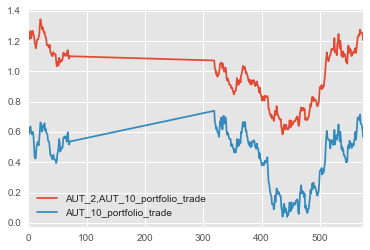

ADF Tests
ADF Statistic: -18.317905
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.50875271436315783, 'Average': 8.3523039549516815e-06, 'half-life': 0.68122843940037481, 'Current_Displacement': 0.0071285702066414764}


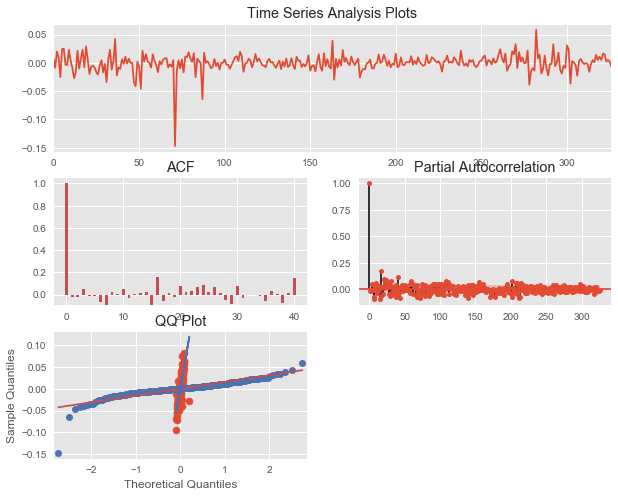

{'beta': array([ 0.58587808]), 'r2-score': 0.64381732228146271}
AUT
[u'RAGB 3.65 04/20/22 Govt__YLD_YTM_MID', u'RAGB 0.75 10/20/26 Govt__YLD_YTM_MID']
[-1.30616408  1.        ]
PCA Weighted and Regular Curve Plots


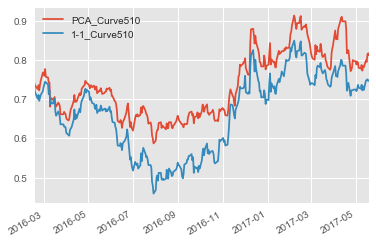

Mean Reversion characteristics for PCA curve
{'country': u'AUT', 'Average': 0.73770683345470123, 'half-life': 41.452136911406484, 'R-squared': 0.0080352366909804962, 'Current_Displacement': -0.15222185724158965}
Rolling PCA Weights Plots


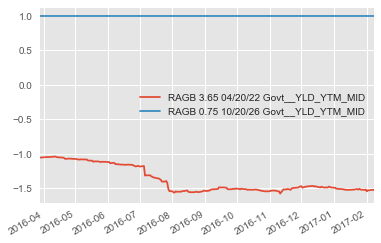

<class 'pandas.core.frame.DataFrame'>


AUT 5,10 regression vs 10
Regression time series


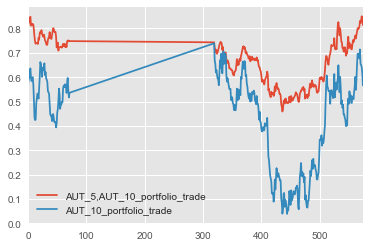

ADF Tests
ADF Statistic: -17.233355
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.47825122932792818, 'Average': -1.0085620706106599e-05, 'half-life': 0.72481410086064313, 'Current_Displacement': 0.0093381872528855749}


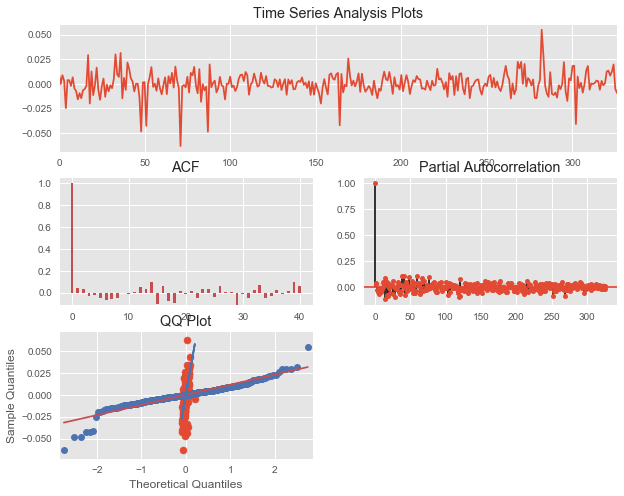

{'beta': array([ 0.28728877]), 'r2-score': 0.43596992636699627}
AUT
[u'RAGB 0.75 10/20/26 Govt__YLD_YTM_MID', u'RAGB 1.5 02/20/47 Govt__YLD_YTM_MID']
[-1.27141168  1.        ]
PCA Weighted and Regular Curve Plots


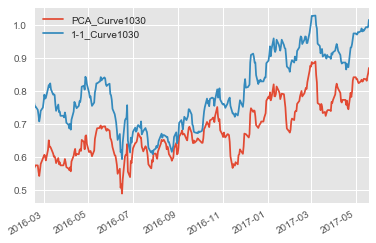

Mean Reversion characteristics for PCA curve
{'country': u'AUT', 'Average': 0.68231851346188666, 'half-life': 17.208840671192068, 'R-squared': 0.020129705158528521, 'Current_Displacement': -0.057062476266186435}
Rolling PCA Weights Plots


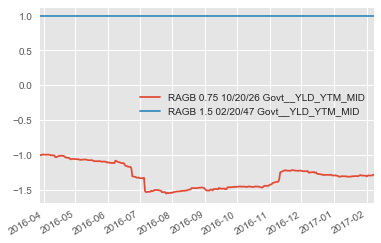

<class 'pandas.core.frame.DataFrame'>


AUT 10,30 regression vs 30
Regression time series


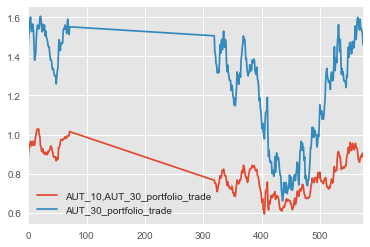

ADF Tests
ADF Statistic: -17.582658
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.48827280461695932, 'Average': -3.8141800997224948e-05, 'half-life': 0.7101444001193894, 'Current_Displacement': -0.0081148879785252447}


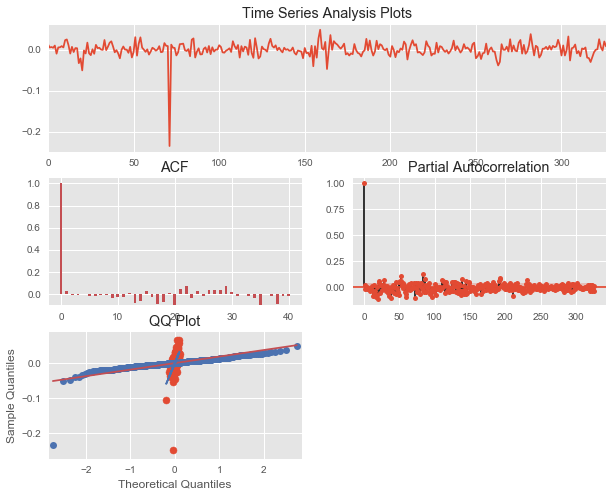

{'beta': array([ 0.30768945]), 'r2-score': 0.33849388276473635}
FRA
[u'FRTR 1 05/25/19 Govt__YLD_YTM_MID', u'FRTR 3.25 10/25/21 Govt__YLD_YTM_MID']
[-1.19912269  1.        ]
PCA Weighted and Regular Curve Plots


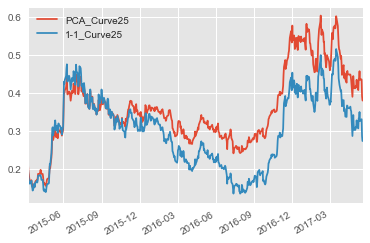

Mean Reversion characteristics for PCA curve
{'country': u'FRA', 'Average': 0.36198374434370151, 'half-life': 61.819561001422365, 'R-squared': 0.0052719677401700249, 'Current_Displacement': -0.20955567026560862}
Rolling PCA Weights Plots


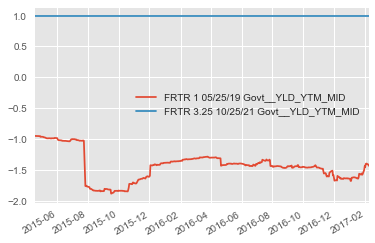

<class 'pandas.core.frame.DataFrame'>


FRA 2,5 regression vs 5
Regression time series


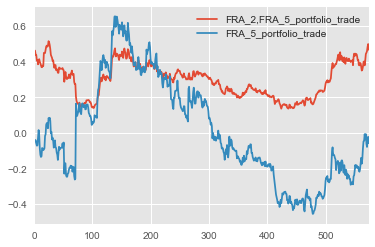

ADF Tests
ADF Statistic: -9.211245
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48570544956457307, 'Average': 7.3129501468925994e-06, 'half-life': 0.71160423856701183, 'Current_Displacement': 0.023712071952635565}


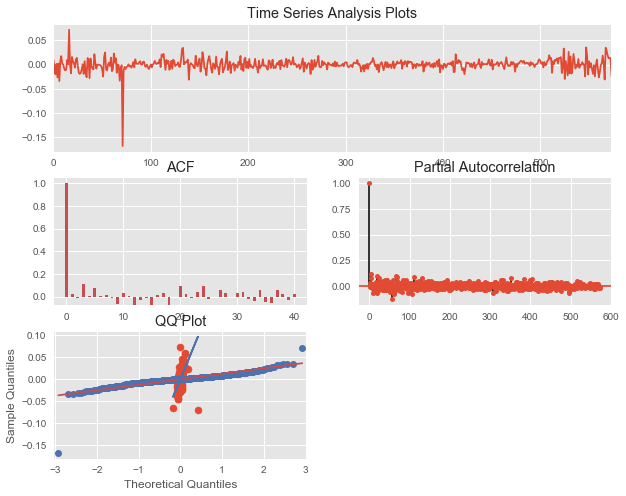

{'beta': array([ 0.23042336]), 'r2-score': 0.2952770398716974}
FRA
[u'FRTR 1 05/25/19 Govt__YLD_YTM_MID', u'FRTR 0.5 05/25/26 Govt__YLD_YTM_MID']
[-2.29487378  1.        ]
PCA Weighted and Regular Curve Plots


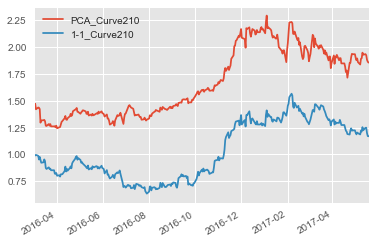

Mean Reversion characteristics for PCA curve
{'country': u'FRA', 'Average': 1.6675974904897097, 'half-life': 63.173361164363378, 'R-squared': 0.005464177307216489, 'Current_Displacement': -0.45821124357515841}
Rolling PCA Weights Plots


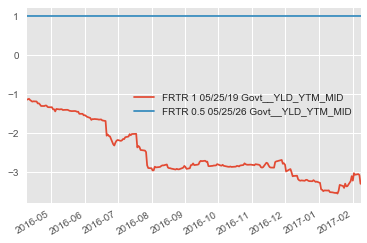

<class 'pandas.core.frame.DataFrame'>


FRA 2,10 regression vs 10
Regression time series


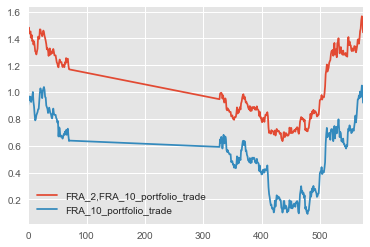

ADF Tests
ADF Statistic: -18.779903
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.52822047462558452, 'Average': -5.8698519722814159e-06, 'half-life': 0.65366122363582813, 'Current_Displacement': 0.031252212965275382}


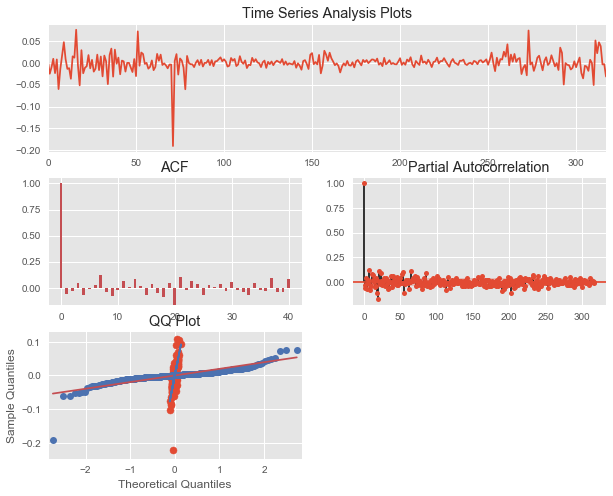

{'beta': array([ 0.67048521]), 'r2-score': 0.61720649774027181}
FRA
[u'FRTR 3.25 10/25/21 Govt__YLD_YTM_MID', u'FRTR 0.5 05/25/26 Govt__YLD_YTM_MID']
[-1.40039464  1.        ]
PCA Weighted and Regular Curve Plots


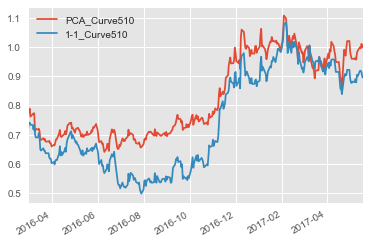

Mean Reversion characteristics for PCA curve
{'country': u'FRA', 'Average': 0.82044290386635577, 'half-life': 42.521267723367679, 'R-squared': 0.0084801697460834546, 'Current_Displacement': -0.18177998503849591}
Rolling PCA Weights Plots


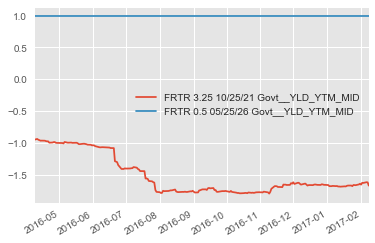

<class 'pandas.core.frame.DataFrame'>


FRA 5,10 regression vs 10
Regression time series


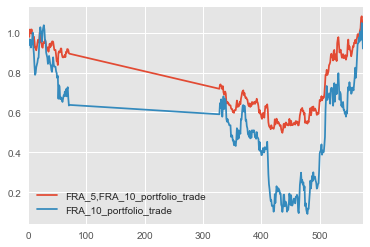

ADF Tests
ADF Statistic: -18.636311
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.5243934021653307, 'Average': -5.8820936850278306e-05, 'half-life': 0.65797144811034447, 'Current_Displacement': 0.029342357303822154}


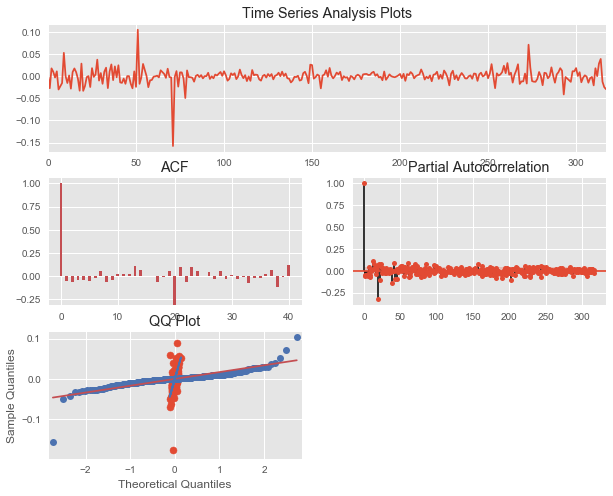

{'beta': array([ 0.38877404]), 'r2-score': 0.4221181331745183}
FRA
[u'FRTR 0.5 05/25/26 Govt__YLD_YTM_MID', u'FRTR 3.25 05/25/45 Govt__YLD_YTM_MID']
[-1.3034498  1.       ]
PCA Weighted and Regular Curve Plots


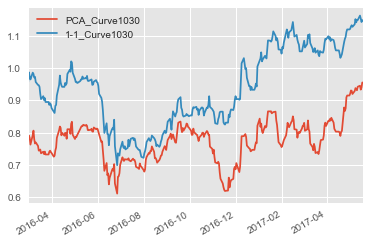

Mean Reversion characteristics for PCA curve
{'country': u'FRA', 'Average': 0.77617728342736403, 'half-life': 17.369039939708149, 'R-squared': 0.019771958762592301, 'Current_Displacement': -0.054345451380320875}
Rolling PCA Weights Plots


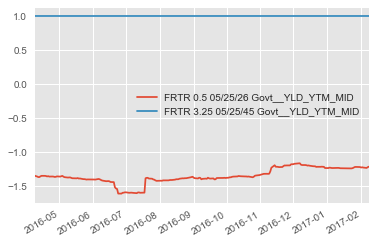

<class 'pandas.core.frame.DataFrame'>


FRA 10,30 regression vs 30
Regression time series


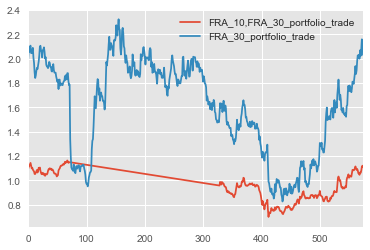

ADF Tests
ADF Statistic: -17.096190
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.4812934045923849, 'Average': -0.00017402534275197035, 'half-life': 0.71919371185563274, 'Current_Displacement': -0.014710595068469633}


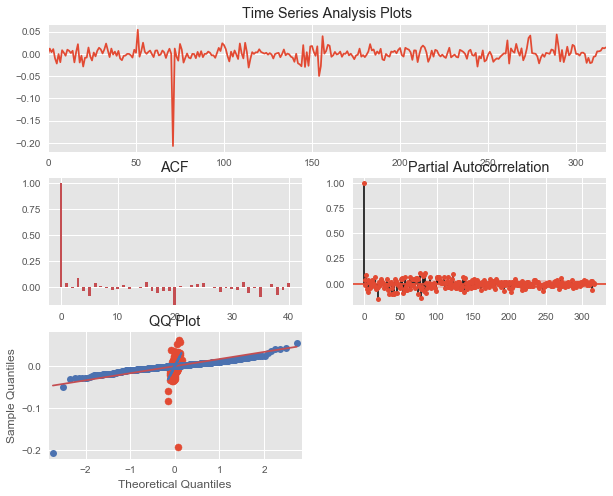

{'beta': array([ 0.20971427]), 'r2-score': 0.24438397769358755}
BEL
[u'BGB 4 03/28/19 55 Govt__YLD_YTM_MID', u'BGB 4.25 09/28/22 65 Govt__YLD_YTM_MID']
[-1.35891361  1.        ]
PCA Weighted and Regular Curve Plots


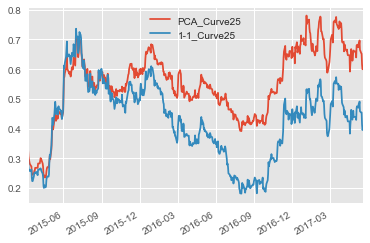

Mean Reversion characteristics for PCA curve
{'country': u'BEL', 'Average': 0.55089885121545989, 'half-life': 46.266282426472102, 'R-squared': 0.0074934288479849842, 'Current_Displacement': -0.17652605568596413}
Rolling PCA Weights Plots


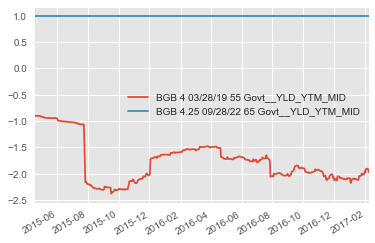

<class 'pandas.core.frame.DataFrame'>


BEL 2,5 regression vs 5
Regression time series


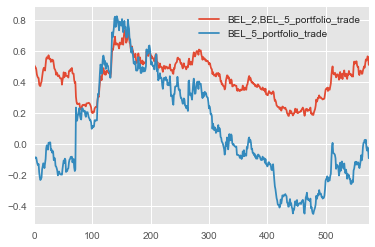

ADF Tests
ADF Statistic: -22.967882
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48021143788280141, 'Average': 6.6303974048304713e-06, 'half-life': 0.71912039591214649, 'Current_Displacement': 0.029651364882164272}


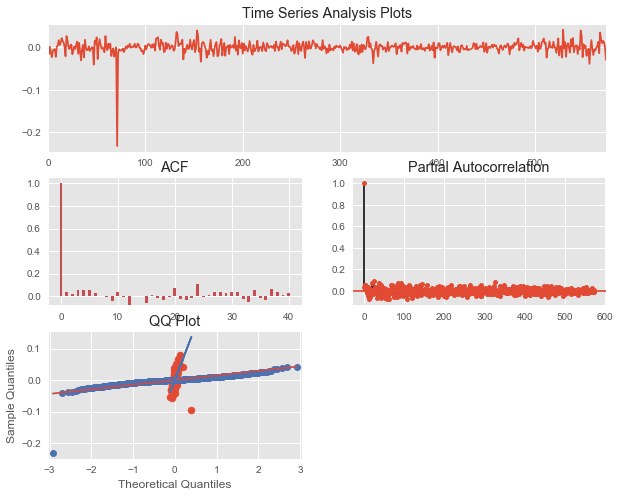

{'beta': array([ 0.34562974]), 'r2-score': 0.42127709799292667}
BEL
[u'BGB 4 03/28/19 55 Govt__YLD_YTM_MID', u'BGB 1 06/22/26 77 Govt__YLD_YTM_MID']
[-1.98031222  1.        ]
PCA Weighted and Regular Curve Plots


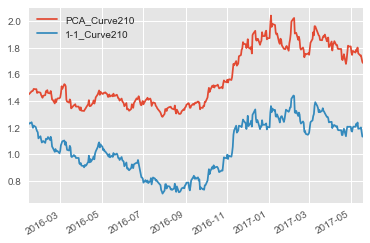

Mean Reversion characteristics for PCA curve
{'country': u'BEL', 'Average': 1.5715241179914261, 'half-life': 65.895323984236498, 'R-squared': 0.0052992028893363852, 'Current_Displacement': -0.3346041530002446}
Rolling PCA Weights Plots


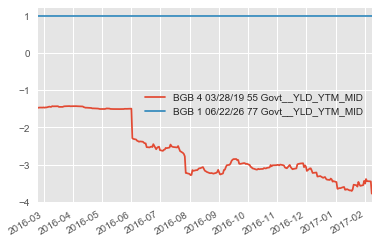

<class 'pandas.core.frame.DataFrame'>


BEL 2,10 regression vs 10
Regression time series


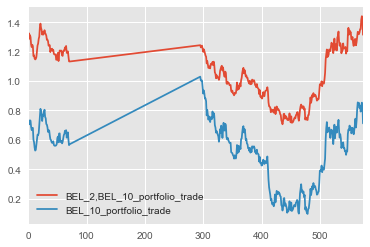

ADF Tests
ADF Statistic: -18.797516
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.50381167784128378, 'Average': -1.4369351061065597e-06, 'half-life': 0.6770982768455065, 'Current_Displacement': 0.051704550383845534}


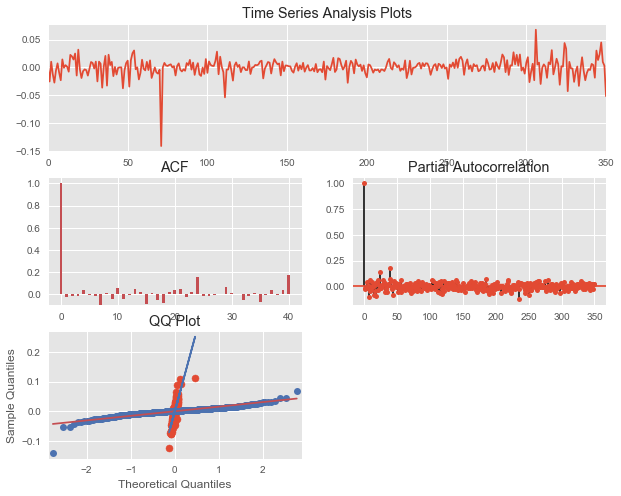

{'beta': array([ 0.54841548]), 'r2-score': 0.69848239377819077}
BEL
[u'BGB 4.25 09/28/22 65 Govt__YLD_YTM_MID', u'BGB 1 06/22/26 77 Govt__YLD_YTM_MID']
[-1.15899958  1.        ]
PCA Weighted and Regular Curve Plots


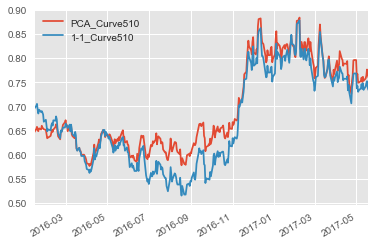

Mean Reversion characteristics for PCA curve
{'country': u'BEL', 'Average': 0.69455564532190439, 'half-life': 47.015326749550503, 'R-squared': 0.0073694248313758148, 'Current_Displacement': -0.12407231583696643}
Rolling PCA Weights Plots


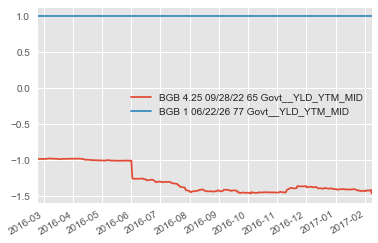

<class 'pandas.core.frame.DataFrame'>


BEL 5,10 regression vs 10
Regression time series


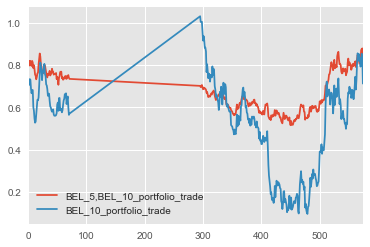

ADF Tests
ADF Statistic: -12.180043
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.45111682218320315, 'Average': -4.8637172444418759e-05, 'half-life': 0.75094305894348745, 'Current_Displacement': 0.050173937301120429}


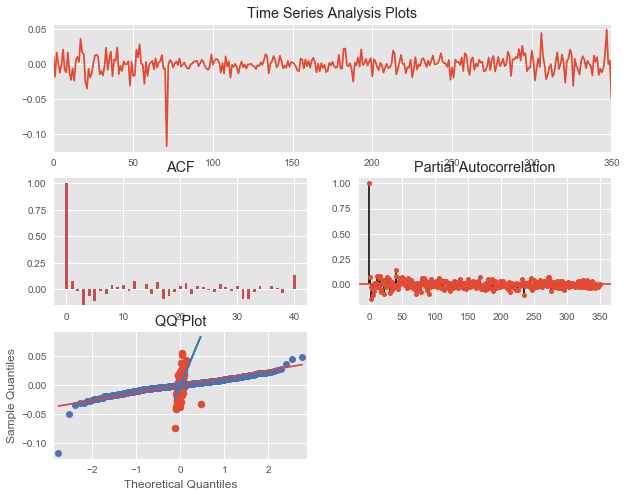

{'beta': array([ 0.18290327]), 'r2-score': 0.27023703708492741}
BEL
[u'BGB 1 06/22/26 77 Govt__YLD_YTM_MID', u'BGB 1.6 06/22/47 78 Govt__YLD_YTM_MID']
[-1.28267861  1.        ]
PCA Weighted and Regular Curve Plots


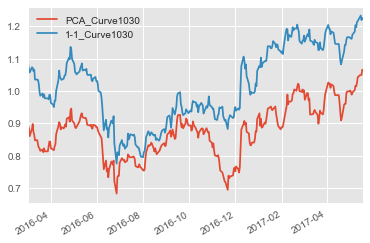

Mean Reversion characteristics for PCA curve
{'country': u'BEL', 'Average': 0.88089916227294407, 'half-life': 26.51864113447844, 'R-squared': 0.012403248662055777, 'Current_Displacement': -0.10783367052188775}
Rolling PCA Weights Plots


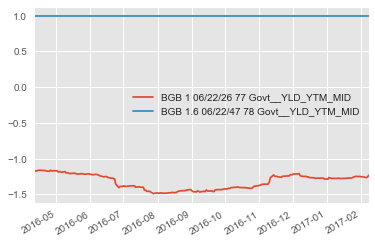

<class 'pandas.core.frame.DataFrame'>


BEL 10,30 regression vs 30
Regression time series


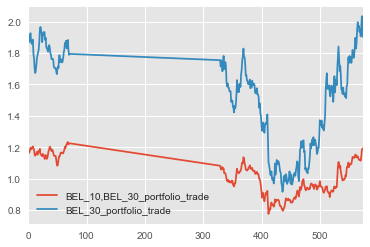

ADF Tests
ADF Statistic: -15.658969
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.43848687961983202, 'Average': 6.6063406897421567e-05, 'half-life': 0.78281787204378794, 'Current_Displacement': -0.033838999006631426}


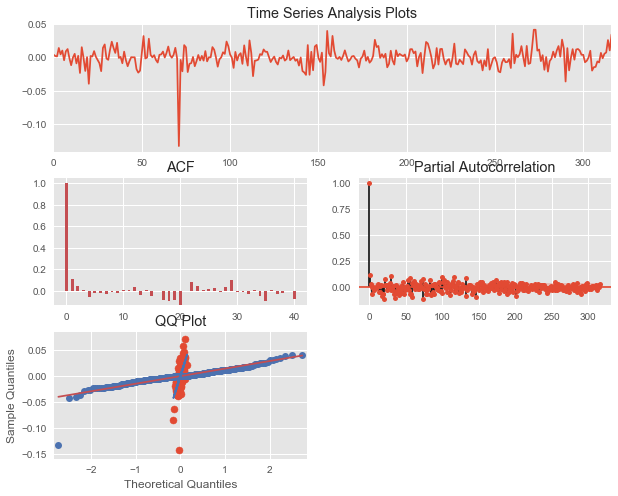

{'beta': array([ 0.27200805]), 'r2-score': 0.4161520717119791}
IRE
[u'IRISH 4.5 10/18/18 Govt__YLD_YTM_MID', u'IRISH 0.8 03/15/22 Govt__YLD_YTM_MID']
[-1.54362369  1.        ]
PCA Weighted and Regular Curve Plots


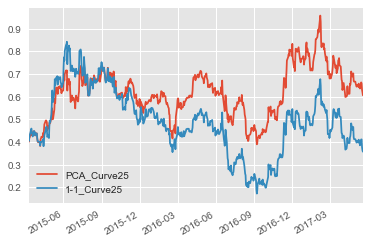

Mean Reversion characteristics for PCA curve
{'country': u'IRE', 'Average': 0.61687055525502066, 'half-life': 29.594859916046417, 'R-squared': 0.011354731538771756, 'Current_Displacement': -0.22424331292152311}
Rolling PCA Weights Plots


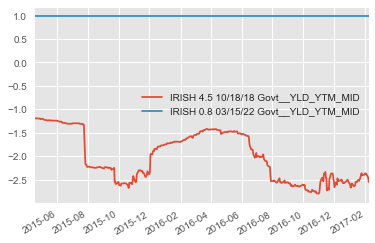

<class 'pandas.core.frame.DataFrame'>


IRE 2,5 regression vs 5
Regression time series


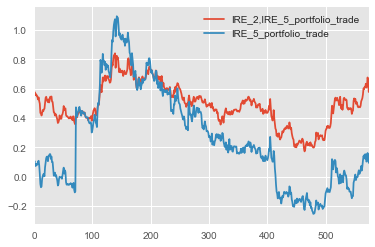

ADF Tests
ADF Statistic: -24.015316
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.5024985812842061, 'Average': 9.4878330417036327e-06, 'half-life': 0.68222430192322547, 'Current_Displacement': 0.054790500723261089}


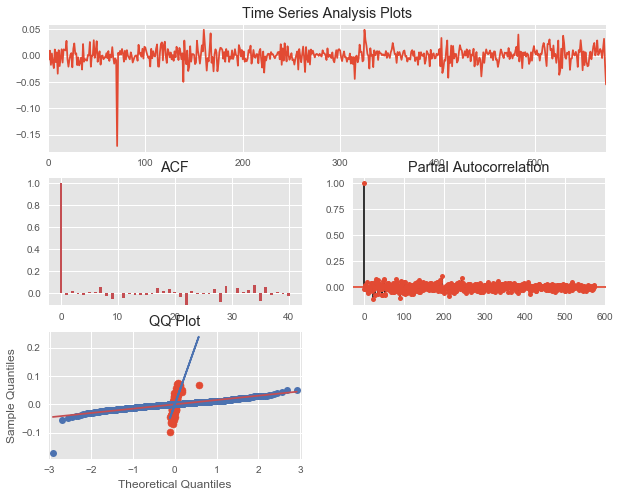

{'beta': array([ 0.41587146]), 'r2-score': 0.56064412394820673}
IRE
[u'IRISH 4.5 10/18/18 Govt__YLD_YTM_MID', u'IRISH 1 05/15/26 Govt__YLD_YTM_MID']
[-2.54306193  1.        ]
PCA Weighted and Regular Curve Plots


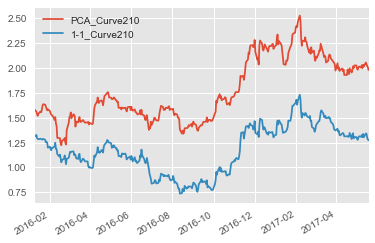

Mean Reversion characteristics for PCA curve
{'country': u'IRE', 'Average': 1.7893688440130555, 'half-life': 76.818933599276079, 'R-squared': 0.0040196753293145759, 'Current_Displacement': -0.51147312820266677}
Rolling PCA Weights Plots


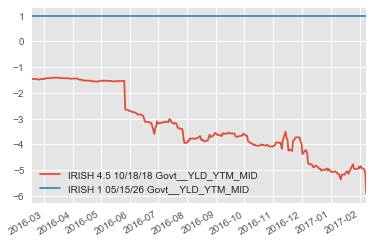

<class 'pandas.core.frame.DataFrame'>


IRE 2,10 regression vs 10
Regression time series


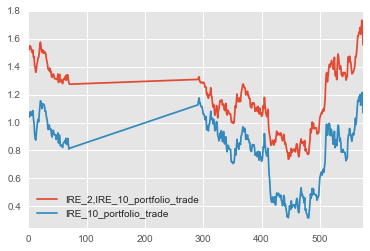

ADF Tests
ADF Statistic: -17.421735
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46301913017055696, 'Average': 1.5535147047252639e-05, 'half-life': 0.73350435983364404, 'Current_Displacement': 0.065169923665494012}


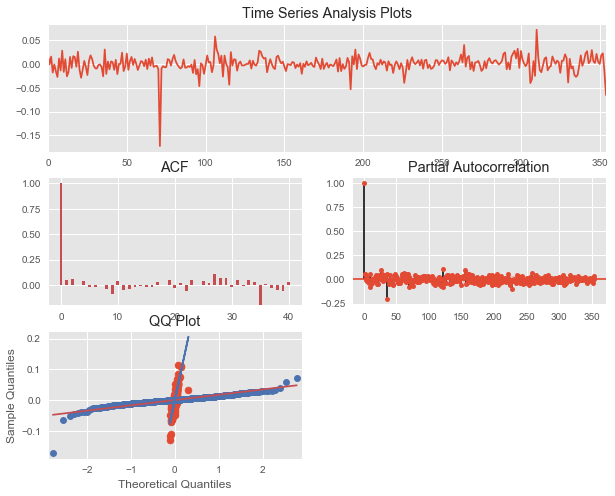

{'beta': array([ 0.66510719]), 'r2-score': 0.7249032451303723}
IRE
[u'IRISH 0.8 03/15/22 Govt__YLD_YTM_MID', u'IRISH 1 05/15/26 Govt__YLD_YTM_MID']
[-1.18050011  1.        ]
PCA Weighted and Regular Curve Plots


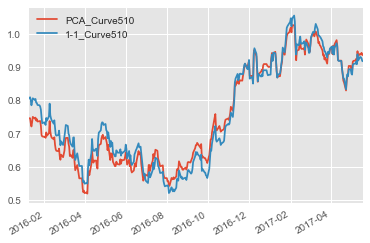

Mean Reversion characteristics for PCA curve
{'country': u'IRE', 'Average': 0.76565578473208273, 'half-life': 89.493200459954693, 'R-squared': 0.0034539934102757464, 'Current_Displacement': -0.19337720529415536}
Rolling PCA Weights Plots


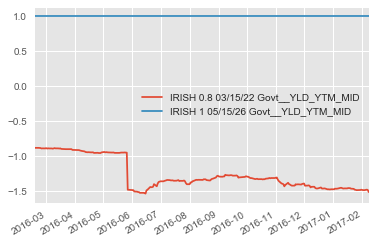

<class 'pandas.core.frame.DataFrame'>


IRE 5,10 regression vs 10
Regression time series


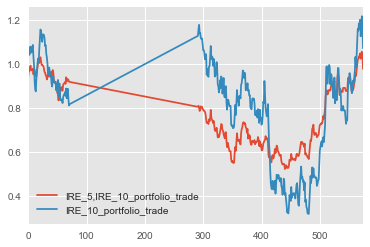

ADF Tests
ADF Statistic: -17.618957
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46862121078923502, 'Average': 1.5770809267219596e-05, 'half-life': 0.73545641907366155, 'Current_Displacement': 0.037390991144886157}


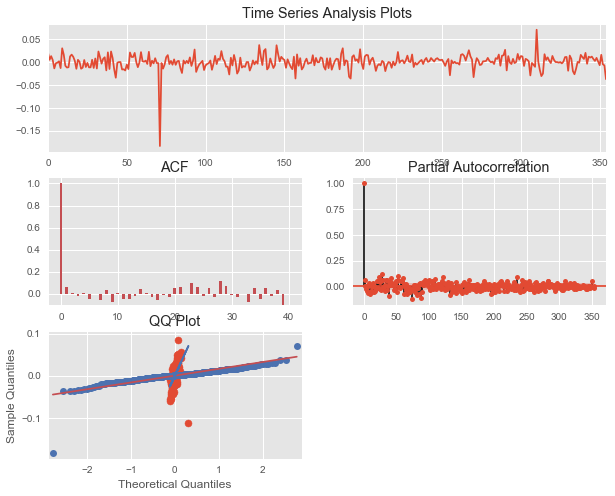

{'beta': array([ 0.22853313]), 'r2-score': 0.26130630898807128}
IRE
[u'IRISH 1 05/15/26 Govt__YLD_YTM_MID', u'IRISH 2 02/18/45 Govt__YLD_YTM_MID']
[-1.07282395  1.        ]
PCA Weighted and Regular Curve Plots


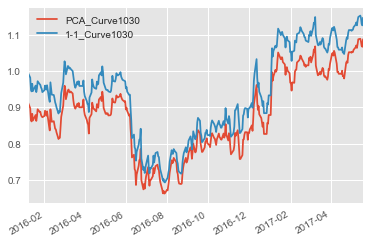

Mean Reversion characteristics for PCA curve
{'country': u'IRE', 'Average': 0.88062498888941654, 'half-life': 40.228818940519503, 'R-squared': 0.0086272462017894513, 'Current_Displacement': -0.12245338663543548}
Rolling PCA Weights Plots


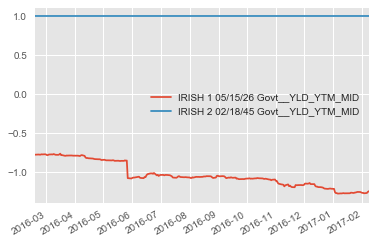

<class 'pandas.core.frame.DataFrame'>


IRE 10,30 regression vs 30
Regression time series


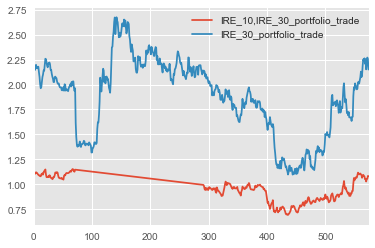

ADF Tests
ADF Statistic: -18.036437
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.48029939524163323, 'Average': 5.7555102836846813e-05, 'half-life': 0.72086015114413193, 'Current_Displacement': -0.017372623278801902}


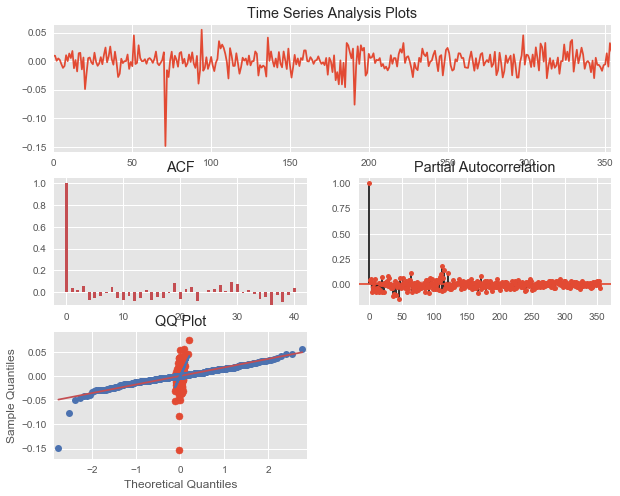

{'beta': array([ 0.20029587]), 'r2-score': 0.2016171898648339}
ESP
[u'SPGB 2.75 04/30/19 Govt__YLD_YTM_MID', u'SPGB 5.85 01/31/22 Govt__YLD_YTM_MID']
[-1.15965818  1.        ]
PCA Weighted and Regular Curve Plots


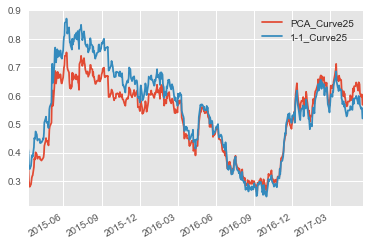

Mean Reversion characteristics for PCA curve
{'country': u'ESP', 'Average': 0.53122232424776261, 'half-life': 63.589346863083556, 'R-squared': 0.0052982463887348841, 'Current_Displacement': -0.1394156315401609}
Rolling PCA Weights Plots


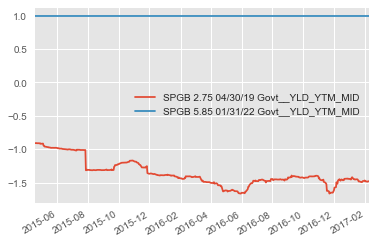

<class 'pandas.core.frame.DataFrame'>


ESP 2,5 regression vs 5
Regression time series


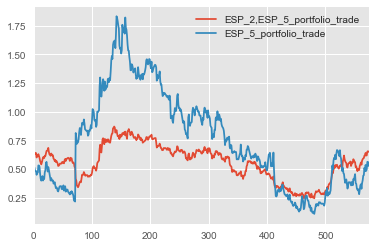

ADF Tests
ADF Statistic: -14.349477
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47739598537726036, 'Average': 1.4597176065835088e-06, 'half-life': 0.72651153862839524, 'Current_Displacement': -0.001818096514718933}


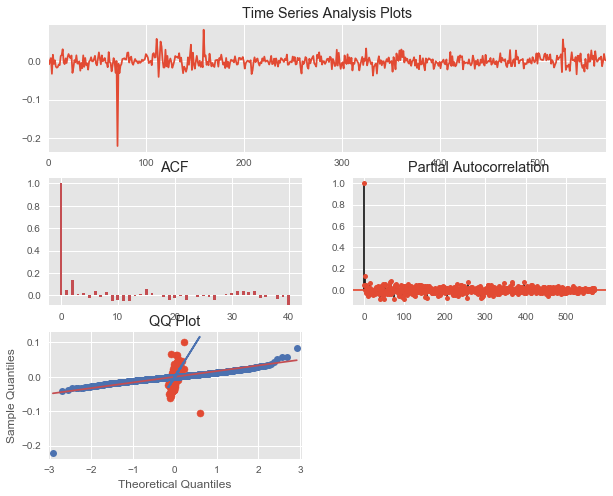

{'beta': array([ 0.19484446]), 'r2-score': 0.25261002737691762}
ESP
[u'SPGB 2.75 04/30/19 Govt__YLD_YTM_MID', u'SPGB 1.95 04/30/26 Govt__YLD_YTM_MID']
[-1.30064889  1.        ]
PCA Weighted and Regular Curve Plots


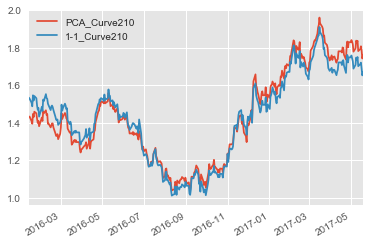

Mean Reversion characteristics for PCA curve
{'country': u'ESP', 'Average': 1.4478744324195649, 'half-life': 77.732358914654654, 'R-squared': 0.0041639834277357179, 'Current_Displacement': -0.35110538081219511}
Rolling PCA Weights Plots


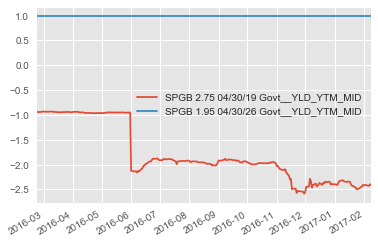

<class 'pandas.core.frame.DataFrame'>


ESP 2,10 regression vs 10
Regression time series


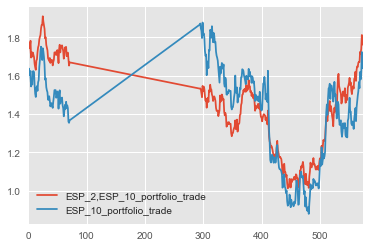

ADF Tests
ADF Statistic: -19.287157
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.51594631779999567, 'Average': -1.9900854173136891e-05, 'half-life': 0.67249326277745247, 'Current_Displacement': 0.017247274841588989}


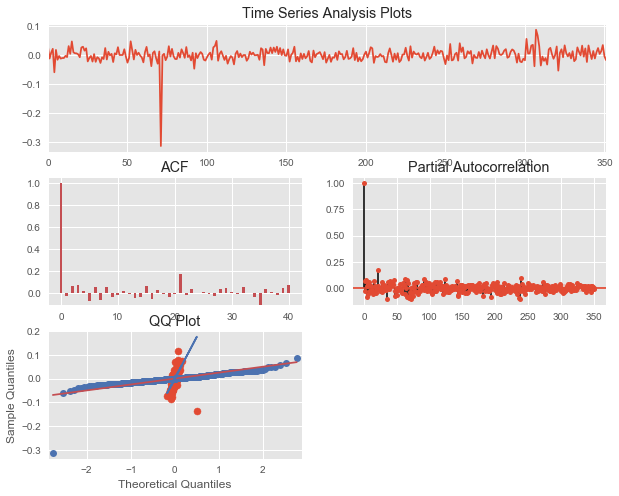

{'beta': array([ 0.35250444]), 'r2-score': 0.34452282010004265}
ESP
[u'SPGB 5.85 01/31/22 Govt__YLD_YTM_MID', u'SPGB 1.95 04/30/26 Govt__YLD_YTM_MID']
[-0.9520393  1.       ]
PCA Weighted and Regular Curve Plots


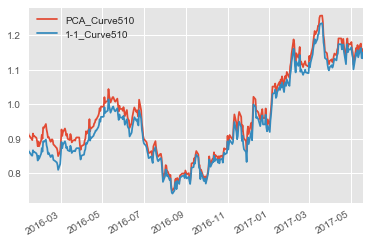

Mean Reversion characteristics for PCA curve
{'country': u'ESP', 'Average': 0.96990319673627301, 'half-life': 46.393170233434986, 'R-squared': 0.0071684019928530684, 'Current_Displacement': -0.16642005117382008}
Rolling PCA Weights Plots


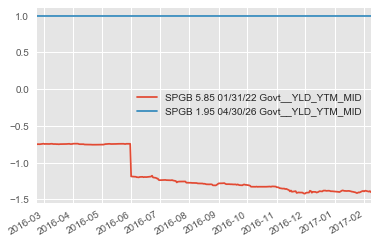

<class 'pandas.core.frame.DataFrame'>


ESP 5,10 regression vs 10
Regression time series


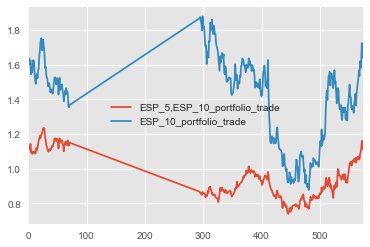

ADF Tests
ADF Statistic: -19.083227
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.5106353091641731, 'Average': -3.0469815549010858e-05, 'half-life': 0.67789852739369116, 'Current_Displacement': 0.034261108278691735}


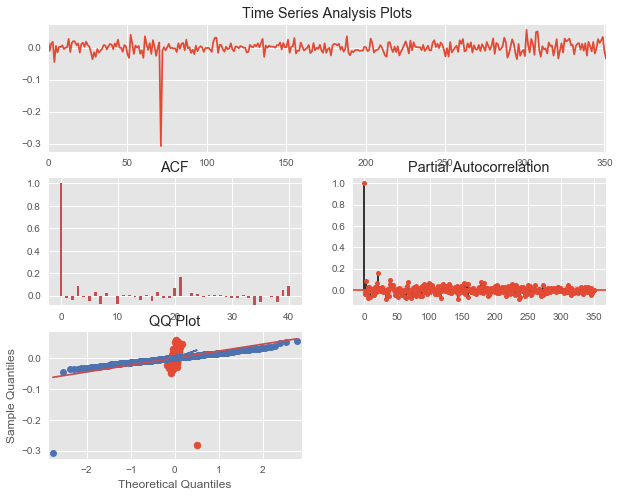

{'beta': array([ 0.0508003]), 'r2-score': 0.013233103270322899}
ESP
[u'SPGB 1.95 04/30/26 Govt__YLD_YTM_MID', u'SPGB 2.9 10/31/46 Govt__YLD_YTM_MID']
[-1.00647345  1.        ]
PCA Weighted and Regular Curve Plots


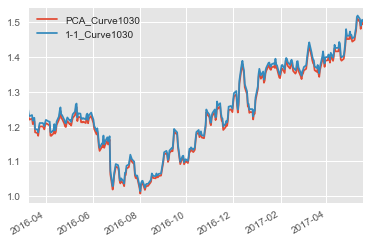

Mean Reversion characteristics for PCA curve
{'country': u'ESP', 'Average': 1.2384261198629092, 'half-life': 45.25714140002723, 'R-squared': 0.0076205652984354666, 'Current_Displacement': -0.14796388800140314}
Rolling PCA Weights Plots


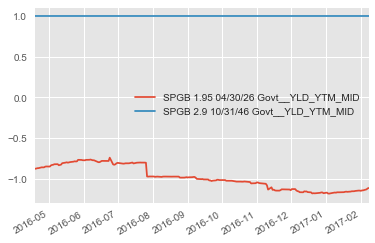

<class 'pandas.core.frame.DataFrame'>


ESP 10,30 regression vs 30
Regression time series


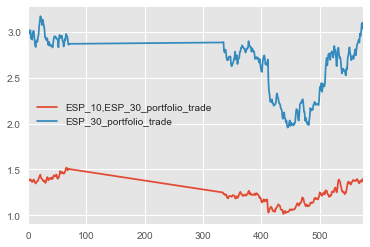

ADF Tests
ADF Statistic: -12.710796
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.44546999989849201, 'Average': 4.6636356138870773e-05, 'half-life': 0.77797939276014227, 'Current_Displacement': -0.016526723892031699}


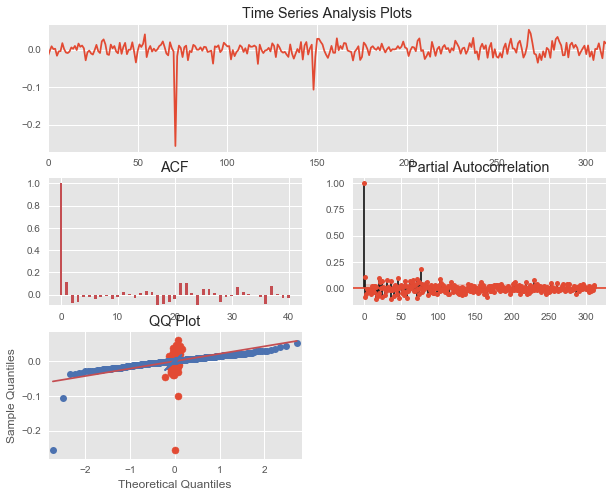

{'beta': array([ 0.11833375]), 'r2-score': 0.062155389435490371}
ITL
[u'BTPS 2.5 05/01/19 Govt__YLD_YTM_MID', u'BTPS 5 03/01/22 Govt__YLD_YTM_MID']
[-1.23634099  1.        ]
PCA Weighted and Regular Curve Plots


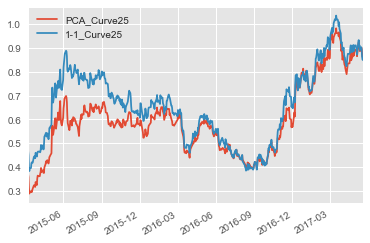

Mean Reversion characteristics for PCA curve
{'country': u'ITL', 'Average': 0.60154605854085774, 'half-life': 44.988106455351385, 'R-squared': 0.0074989800065140555, 'Current_Displacement': -0.22338524515470592}
Rolling PCA Weights Plots


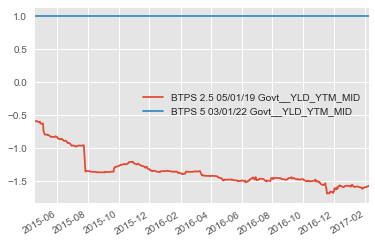

<class 'pandas.core.frame.DataFrame'>


ITL 2,5 regression vs 5
Regression time series


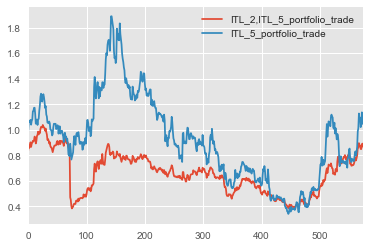

ADF Tests
ADF Statistic: -11.932259
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47735962901385409, 'Average': -6.035092881033545e-06, 'half-life': 0.72645655769902595, 'Current_Displacement': 0.0026607502459002033}


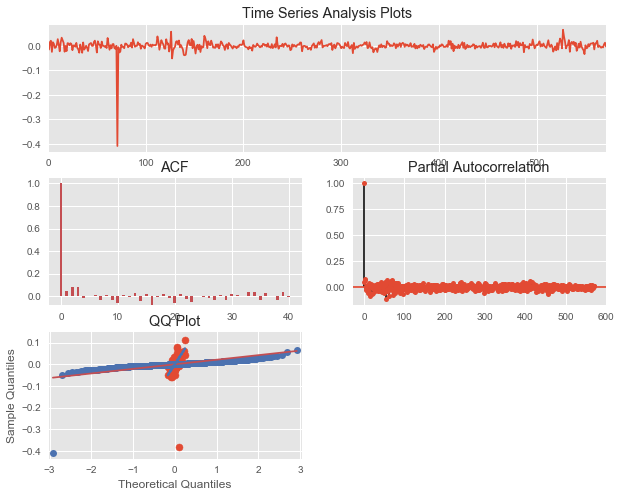

{'beta': array([ 0.30046781]), 'r2-score': 0.29905793156558313}
ITL
[u'BTPS 2.5 05/01/19 Govt__YLD_YTM_MID', u'BTPS 4.5 03/01/26 Govt__YLD_YTM_MID']
[-2.24525747  1.        ]
PCA Weighted and Regular Curve Plots


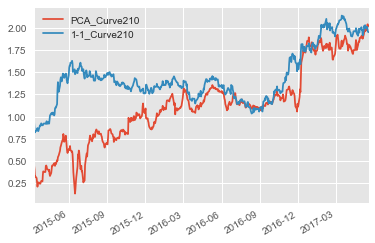

Mean Reversion characteristics for PCA curve
{'country': u'ITL', 'Average': 1.1227832434101928, 'half-life': 46.574973187185776, 'R-squared': 0.0073886398119972219, 'Current_Displacement': -0.68156092775230248}
Rolling PCA Weights Plots


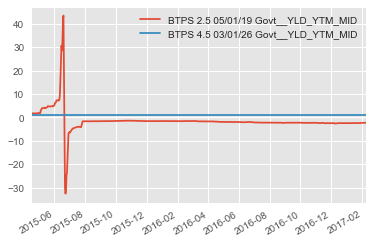

<class 'pandas.core.frame.DataFrame'>


ITL 2,10 regression vs 10
Regression time series


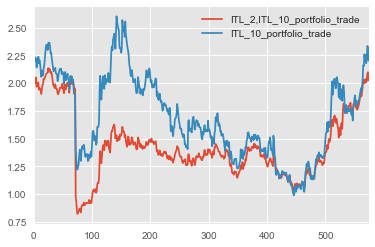

ADF Tests
ADF Statistic: -22.675937
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47382879791856047, 'Average': 3.3155558561211727e-06, 'half-life': 0.73139496593478537, 'Current_Displacement': -0.0080014038523101225}


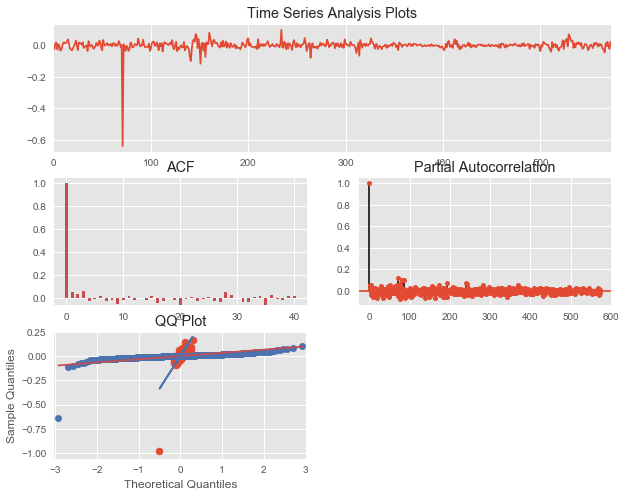

{'beta': array([ 0.67503933]), 'r2-score': 0.59550945102432706}
ITL
[u'BTPS 5 03/01/22 Govt__YLD_YTM_MID', u'BTPS 4.5 03/01/26 Govt__YLD_YTM_MID']
[-1.35284263  1.        ]
PCA Weighted and Regular Curve Plots


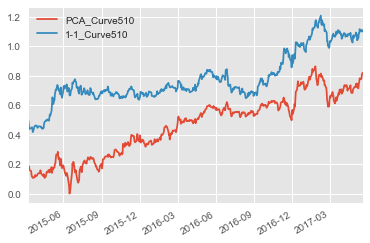

Mean Reversion characteristics for PCA curve
{'country': u'ITL', 'Average': 0.45721262762393039, 'half-life': 59.675081501761305, 'R-squared': 0.00583507001597805, 'Current_Displacement': -0.33306682154781625}
Rolling PCA Weights Plots


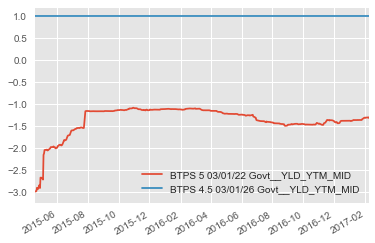

<class 'pandas.core.frame.DataFrame'>


ITL 5,10 regression vs 10
Regression time series


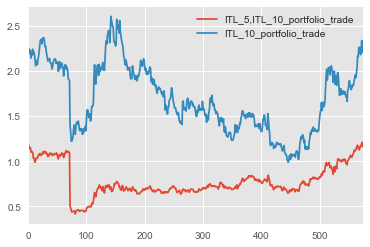

ADF Tests
ADF Statistic: -22.661207
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47437960274230118, 'Average': -9.5949469748227576e-06, 'half-life': 0.73051786129009488, 'Current_Displacement': 0.0088126930142798966}


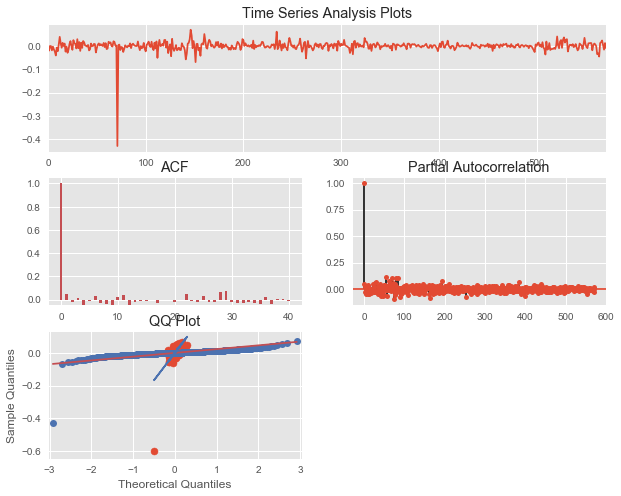

{'beta': array([ 0.33481427]), 'r2-score': 0.42903487436643628}
ITL
[u'BTPS 4.5 03/01/26 Govt__YLD_YTM_MID', u'BTPS 3.25 09/01/46 Govt__YLD_YTM_MID']
[-1.12082314  1.        ]
PCA Weighted and Regular Curve Plots


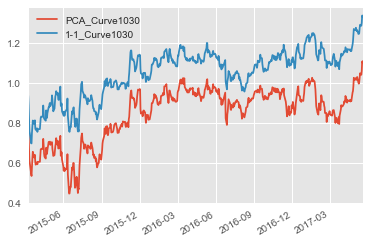

Mean Reversion characteristics for PCA curve
{'country': u'ITL', 'Average': 0.84719943778868778, 'half-life': 33.247314566786876, 'R-squared': 0.010392902842926488, 'Current_Displacement': -0.091506358459565007}
Rolling PCA Weights Plots


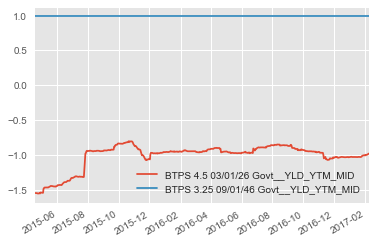

<class 'pandas.core.frame.DataFrame'>


ITL 10,30 regression vs 30
Regression time series


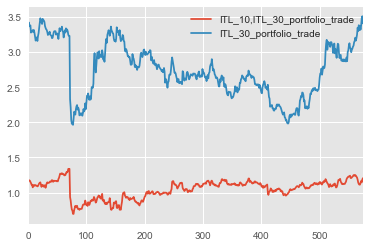

ADF Tests
ADF Statistic: -22.542077
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47087752287661222, 'Average': 5.8841226650200582e-05, 'half-life': 0.73540603610165922, 'Current_Displacement': -0.03705167634196295}


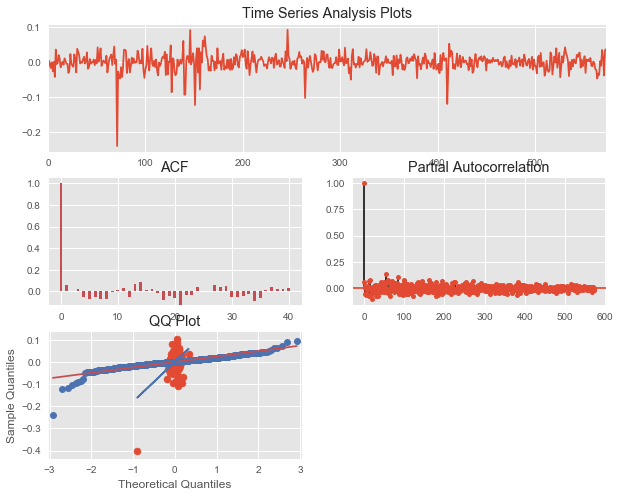

{'beta': array([ 0.17931206]), 'r2-score': 0.18803143640714004}
PTE
[u'PGB 4.75 06/14/19 Govt__YLD_YTM_MID', u'PGB 2.2 10/17/22 Govt__YLD_YTM_MID']
[-1.15466453  1.        ]
PCA Weighted and Regular Curve Plots


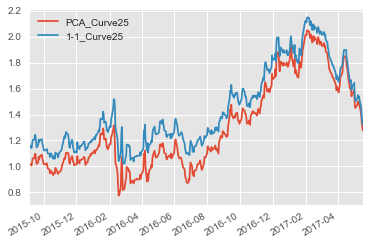

Mean Reversion characteristics for PCA curve
{'country': u'PTE', 'Average': 1.3015641751693585, 'half-life': 104.5426050135558, 'R-squared': 0.0032174397008651878, 'Current_Displacement': -0.7018212282817764}
Rolling PCA Weights Plots


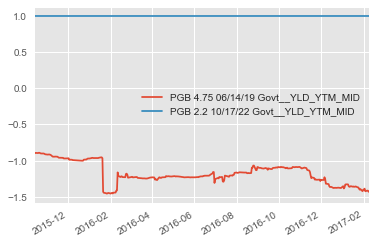

<class 'pandas.core.frame.DataFrame'>


PTE 2,5 regression vs 5
Regression time series


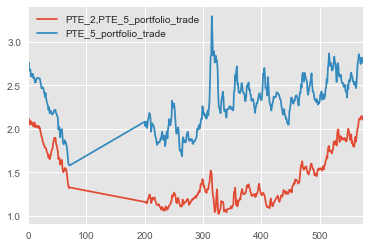

ADF Tests
ADF Statistic: -18.553805
p-value: 0.000000
Critical Values:
	5%: -2.868
	1%: -3.445
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.43727715771361064, 'Average': -3.9983330424880735e-05, 'half-life': 0.79237632524600099, 'Current_Displacement': 0.024308082624668541}


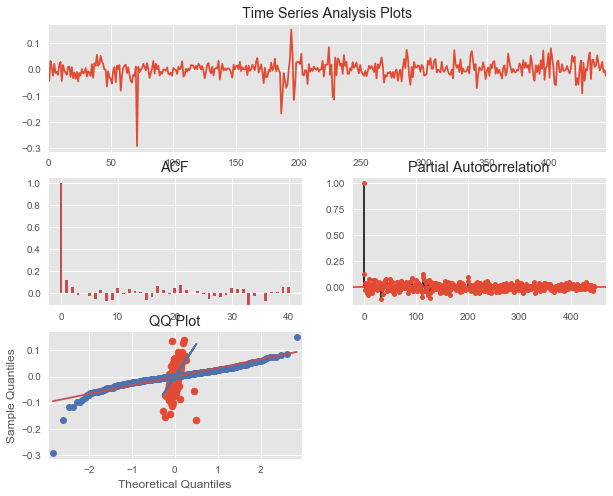

{'beta': array([ 0.24807714]), 'r2-score': 0.22047056905633}
PTE
[u'PGB 4.75 06/14/19 Govt__YLD_YTM_MID', u'PGB 2.875 07/21/26 Govt__YLD_YTM_MID']
[-1.32894916  1.        ]
PCA Weighted and Regular Curve Plots


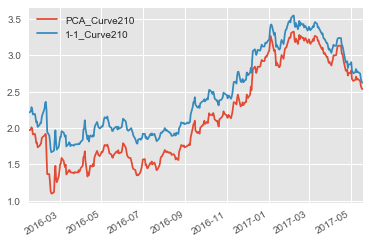

Mean Reversion characteristics for PCA curve
{'country': u'PTE', 'Average': 2.1844081817395744, 'half-life': 154.05552875155865, 'R-squared': 0.0021360504805851832, 'Current_Displacement': -1.0304722205619559}
Rolling PCA Weights Plots


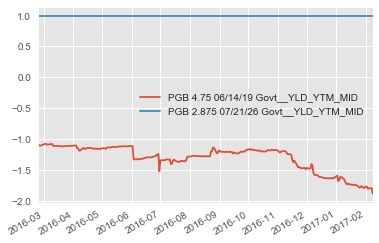

<class 'pandas.core.frame.DataFrame'>


PTE 2,10 regression vs 10
Regression time series


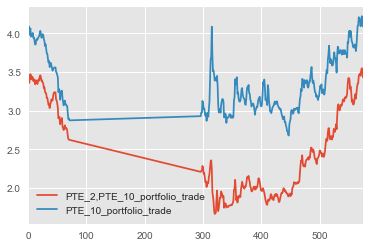

ADF Tests
ADF Statistic: -15.878028
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.42080925595506435, 'Average': -7.5347486764467853e-05, 'half-life': 0.8218506330915275, 'Current_Displacement': 0.056617353645406411}


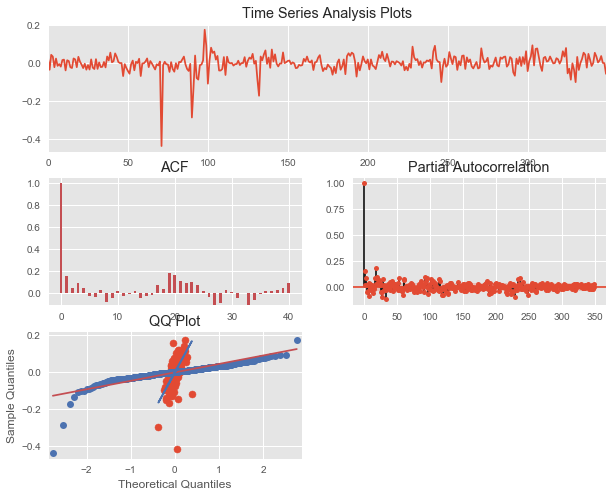

{'beta': array([ 0.43894682]), 'r2-score': 0.3474982304521228}
PTE
[u'PGB 2.2 10/17/22 Govt__YLD_YTM_MID', u'PGB 2.875 07/21/26 Govt__YLD_YTM_MID']
[-1.02230878  1.        ]
PCA Weighted and Regular Curve Plots


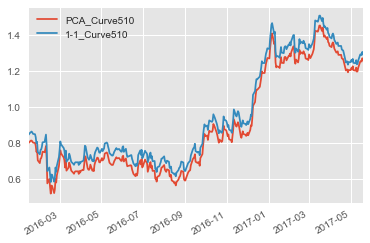

Mean Reversion characteristics for PCA curve
{'country': u'PTE', 'Average': 0.90746803477747706, 'half-life': 90.465650299740105, 'R-squared': 0.0036869875251333006, 'Current_Displacement': -0.35691511717681523}
Rolling PCA Weights Plots


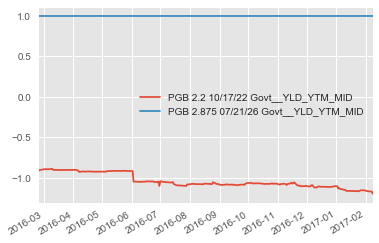

<class 'pandas.core.frame.DataFrame'>


PTE 5,10 regression vs 10
Regression time series


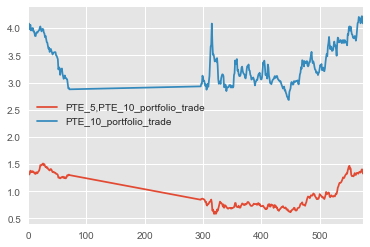

ADF Tests
ADF Statistic: -17.319365
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46364569579426052, 'Average': -1.511345125486171e-05, 'half-life': 0.74414558960184718, 'Current_Displacement': 0.059285345382127833}


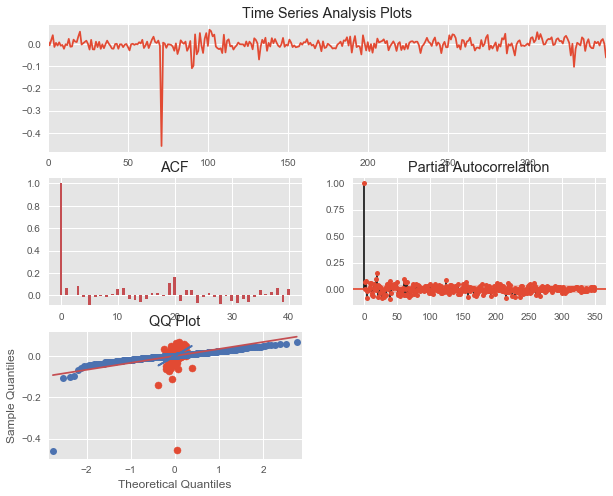

{'beta': array([ 0.12459953]), 'r2-score': 0.073727312036222847}
PTE
[u'PGB 2.875 07/21/26 Govt__YLD_YTM_MID', u'PGB 4.1 02/15/45 Govt__YLD_YTM_MID']
[-0.93083392  1.        ]
PCA Weighted and Regular Curve Plots


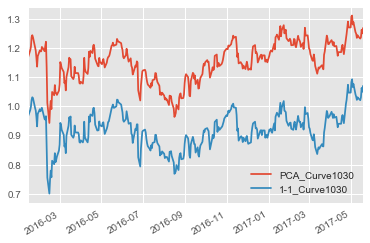

Mean Reversion characteristics for PCA curve
{'country': u'PTE', 'Average': 1.1545711170916155, 'half-life': 13.025253778722432, 'R-squared': 0.02621032688324465, 'Current_Displacement': -0.075179808564094452}
Rolling PCA Weights Plots


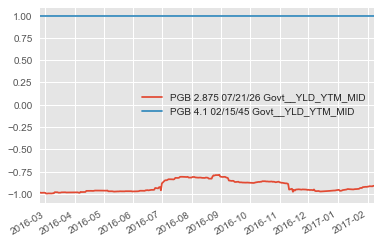

<class 'pandas.core.frame.DataFrame'>


PTE 10,30 regression vs 30
Regression time series


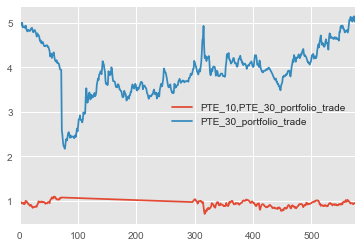

ADF Tests
ADF Statistic: -10.316638
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46217140034165372, 'Average': 8.7272819026860534e-05, 'half-life': 0.74999525962277347, 'Current_Displacement': -0.0046727099209904416}


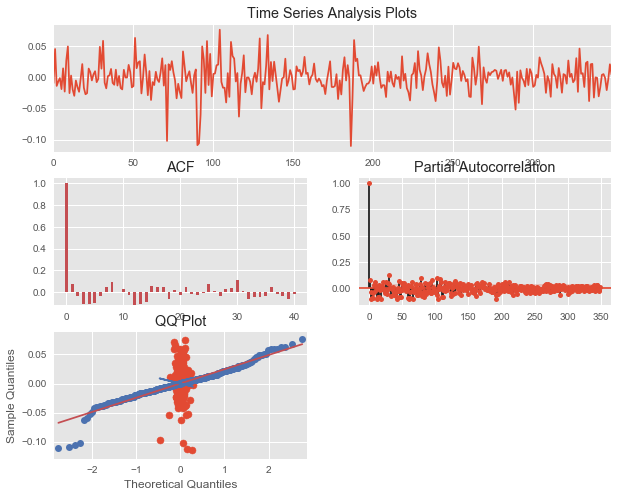

{'beta': array([-0.01882367]), 'r2-score': 0.0029682256320235911}
UKT
[u'UKT 1.75 07/22/19 Govt__YLD_YTM_MID', u'UKT 0.5 07/22/22 Govt__YLD_YTM_MID']
[-1.41289793  1.        ]
PCA Weighted and Regular Curve Plots


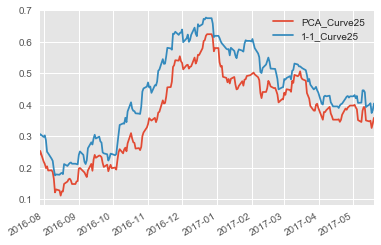

Mean Reversion characteristics for PCA curve
{'country': u'UKT', 'Average': 0.38142828455510397, 'half-life': 72.884135986262336, 'R-squared': 0.0046330638896069365, 'Current_Displacement': -0.056095148434138598}
Rolling PCA Weights Plots


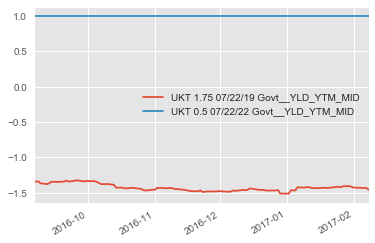

<class 'pandas.core.frame.DataFrame'>


UKT 2,5 regression vs 5
Regression time series


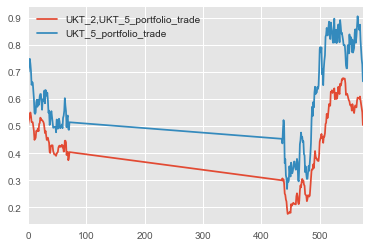

ADF Tests
ADF Statistic: -6.427073
p-value: 0.000000
Critical Values:
	5%: -2.876
	1%: -3.462
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.50253947938054599, 'Average': 2.9209089031317493e-06, 'half-life': 0.68507606926321818, 'Current_Displacement': 0.024934379360544014}


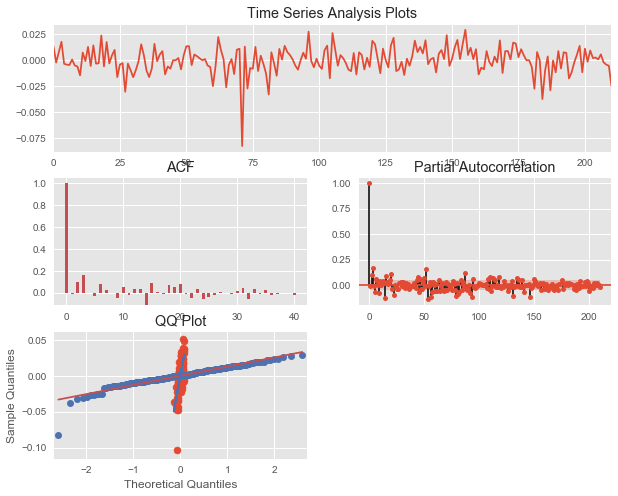

{'beta': array([ 0.35594422]), 'r2-score': 0.49153016681892903}
UKT
[u'UKT 1.75 07/22/19 Govt__YLD_YTM_MID', u'UKT 4.25 12/07/27 Govt__YLD_YTM_MID']
[-1.03061188  1.        ]
PCA Weighted and Regular Curve Plots


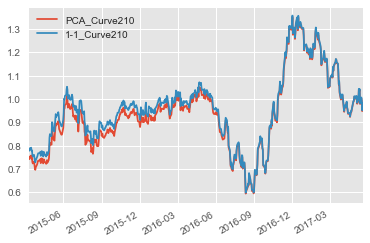

Mean Reversion characteristics for PCA curve
{'country': u'UKT', 'Average': 0.93887164732028405, 'half-life': 65.769674268288497, 'R-squared': 0.005276792684147491, 'Current_Displacement': -0.2061998403681744}
Rolling PCA Weights Plots


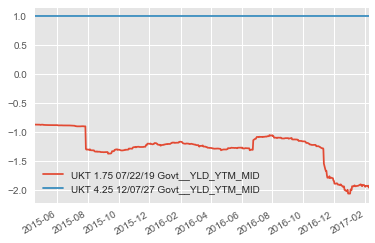

<class 'pandas.core.frame.DataFrame'>


UKT 2,10 regression vs 10
Regression time series


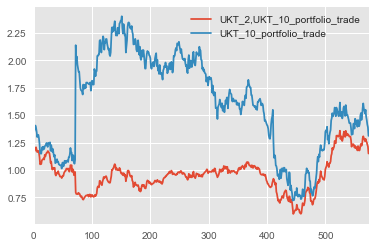

ADF Tests
ADF Statistic: -12.013152
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48150738315574593, 'Average': -2.7504052650674113e-05, 'half-life': 0.71566628900425011, 'Current_Displacement': 0.057055889524012193}


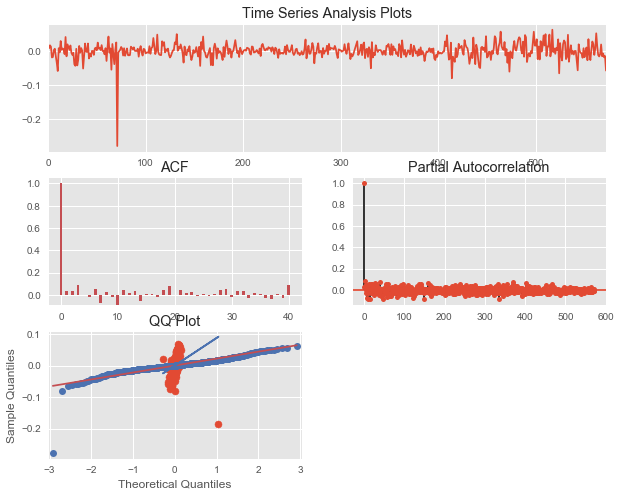

{'beta': array([ 0.08755198]), 'r2-score': 0.063840613093545384}
UKT
[u'UKT 0.5 07/22/22 Govt__YLD_YTM_MID', u'UKT 4.25 12/07/27 Govt__YLD_YTM_MID']
[-1.3305548  1.       ]
PCA Weighted and Regular Curve Plots


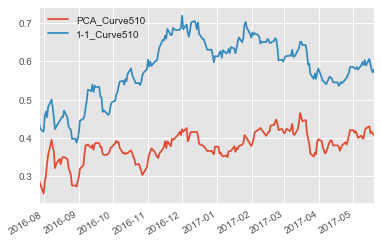

Mean Reversion characteristics for PCA curve
{'country': u'UKT', 'Average': 0.37877850803679625, 'half-life': 8.9288782402864797, 'R-squared': 0.038467984193185312, 'Current_Displacement': -0.047402550024170043}
Rolling PCA Weights Plots


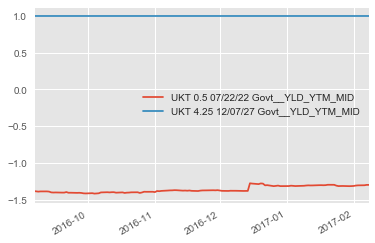

<class 'pandas.core.frame.DataFrame'>


UKT 5,10 regression vs 10
Regression time series


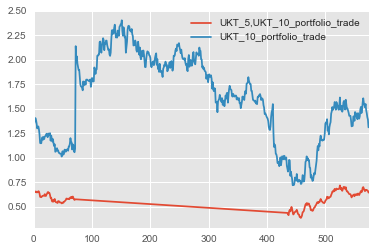

ADF Tests
ADF Statistic: -6.110646
p-value: 0.000000
Critical Values:
	5%: -2.876
	1%: -3.463
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.43749372186633539, 'Average': -0.00016926315778925918, 'half-life': 0.79218167161070319, 'Current_Displacement': -0.0024778364712982085}


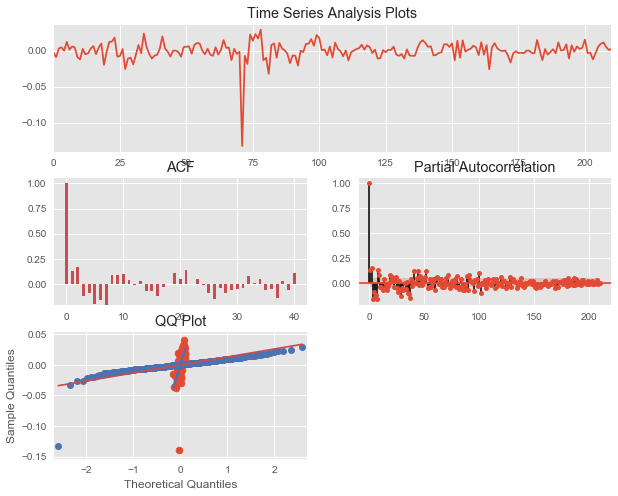

{'beta': array([ 0.24441232]), 'r2-score': 0.40742278715410141}
UKT
[u'UKT 4.25 12/07/27 Govt__YLD_YTM_MID', u'UKT 1.5 07/22/47 Govt__YLD_YTM_MID']
[-0.96047797  1.        ]
PCA Weighted and Regular Curve Plots


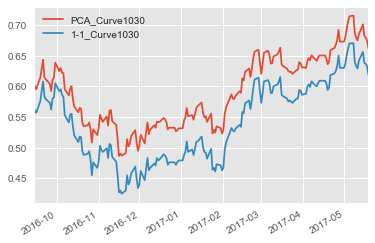

Mean Reversion characteristics for PCA curve
{'country': u'UKT', 'Average': 0.59115169215501651, 'half-life': 26.123909544215923, 'R-squared': 0.013272917641462878, 'Current_Displacement': 0.011338308667200425}
Rolling PCA Weights Plots


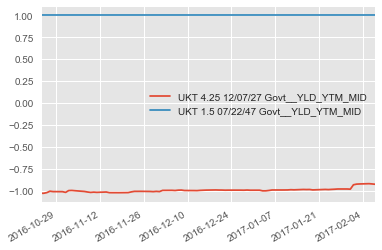

<class 'pandas.core.frame.DataFrame'>


UKT 10,30 regression vs 30
Regression time series


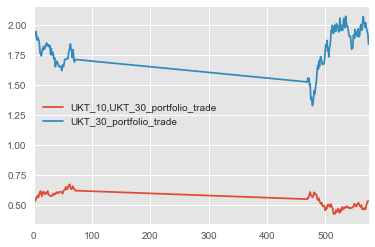

ADF Tests
ADF Statistic: -12.966671
p-value: 0.000000
Critical Values:
	5%: -2.878
	1%: -3.468
	10%: -2.576
Mean Reversion characteristics
{'R-squared': 0.49142814609509644, 'Average': -1.4591437364770597e-05, 'half-life': 0.70539770747156816, 'Current_Displacement': 0.0029115982062984142}


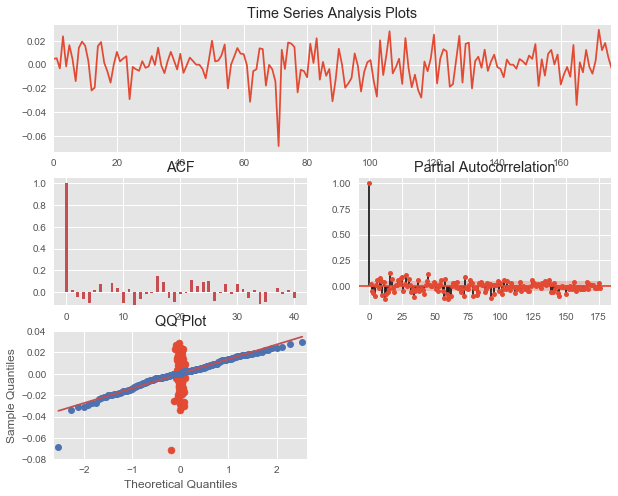

{'beta': array([ 0.01293747]), 'r2-score': 0.0015858076785304487}


In [68]:
# Part 2 
mastercurve_list = [[2,5],[2,10],[5,10],[10,30]]
#curve_list = [5,10]
import matplotlib.pyplot as plt
plt.style.use('ggplot')
curve_country_dict = {key:np.nan for key in list(headers.columns)}
pca_curve_country_dict = {key:np.nan for key in list(headers.columns)}
for country in list(headers.columns)[:]:
    for cur1 in mastercurve_list:
        curve_list = cur1
        tickerlist = [headers.loc[str(x)+'Y',country] for x in curve_list]
        metric = 'YLD_YTM_MID'
        tickerlist = [x+' Govt__'+metric for x in tickerlist]
        print country
        print tickerlist

        try:
            pca_curve_country_dict[country] = pd.DataFrame(trade_pca_calc(ret_df,tickerlist).dropna()
                                                           , columns = ['PCA_Curve'+''.join([str(x) for x in curve_list])])
            curve_country_dict[country] = pd.DataFrame(trade_calc(ret_df,tickerlist).dropna()
                                                       ,columns = ['1-1_Curve'+''.join([str(x) for x in curve_list])])
            ax = pca_curve_country_dict[country].plot(legend = True)
            curve_country_dict[country].plot(legend = True, ax = ax)
            print 'PCA Weighted and Regular Curve Plots'
            plt.show()
            (alpha, theta, r_squared) = mean_reversion(pca_curve_country_dict[country])
            print 'Mean Reversion characteristics for PCA curve'
            #print alpha, theta, float(pca_curve_country_dict[country].iloc[-1,:])
            print {'half-life':np.log(2)/alpha,'Average':theta
                                ,'Current_Displacement':theta - float(pca_curve_country_dict[country].iloc[-1,:]), 'country':country
                               , 'R-squared':r_squared}
            #print 'll'
            #print float(pca_curve_country_dict[country].iloc[-1,:])
            print 'Rolling PCA Weights Plots'
            rolling_df = rolling_pca_calc(ret_df,tickerlist,window=100)
            rolling_df.dropna().plot(legend = True)
            plt.show()

        except:
            print "Did not work"

        print type(pca_curve_country_dict[country])      
        #tsdiagnostics(np.array(pca_curve_country_dict[country]).ravel())
        print '\n'
        print country+' ' + ','.join([str(x) for x in curve_list])+' regression vs '+ str(curve_list[1])
        print portfolio_regression(ret_df,curve_list,[-1,1],country,[curve_list[1]],[1],country)

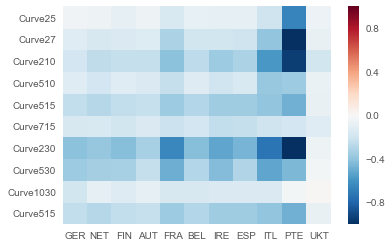

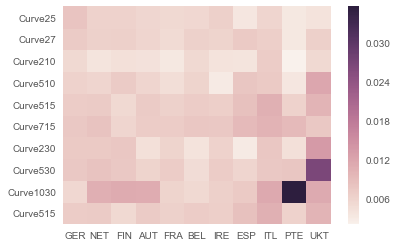

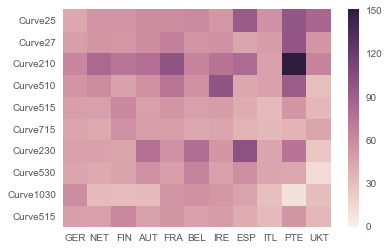

NET GER [2, 7]


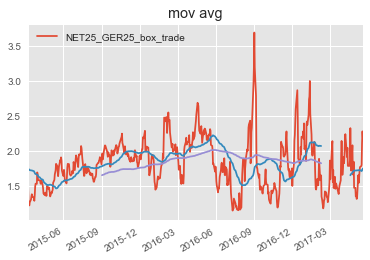

Mean Reversion characteristics for Box Trade
{'R-squared': 0.041171131393287541, 'Average': 1.8279088506344885, 'half-life': 8.5600905723082139, 'Current_Displacement': 0.17674605993681403}
ADF Tests
ADF Statistic: -5.210023
p-value: 0.000008
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.041171131393287541, 'Average': 1.8279088506344885, 'half-life': 8.5600905723082139, 'Current_Displacement': 0.17674605993681403}
NET GER [2, 5]


ValueError: ordinal must be >= 1

ValueError: ordinal must be >= 1

In [75]:
#3 Box analysis - Part 2 (Ratio Analysis) #MARK

def ret_box(ret_df,Ylist,Y_country,Xlist,X_country, metric = 'YLD_YTM_MID', del_changes = True):
    
    Y_tickerlist = [headers.loc[str(x)+'Y',Y_country]+' Govt__'+metric for x in Ylist]
    X_tickerlist = [headers.loc[str(x)+'Y',X_country]+' Govt__'+metric for x in Xlist]
    temp_df = ret_df[Y_tickerlist+X_tickerlist]
    temp_df = temp_df.copy().dropna()
    #print temp_df
    #print (temp_df[Y_tickerlist[1]]).head()
    Y_country = Y_country+''.join([str(x) for x in  Ylist])
    X_country = X_country+''.join([str(x) for x in Xlist])
    #print Y_country
    return pd.DataFrame((temp_df[Y_tickerlist[1]]-temp_df[X_tickerlist[1]])/(temp_df[Y_tickerlist[0]]
                                                                             -temp_df[X_tickerlist[0]])
                                                       , columns = [Y_country+'_'+X_country+'_box_trade'])

#Run All Curves
mastercurve_list = [[2,5],[2,7],[2,10],[5,10],[5,15],[7,15],[2,30],[5,30],[10,30],[5,15]]
fly_country_dict1 = {key:np.nan for key in list(headers.columns)}
#for cn in headers.columns:
len1 = len(headers.columns)    
for cn1 in range(0,len1-1):
    X_country = str(headers.columns[cn1])
    for cn2 in range(cn1+1,len1):
        Y_country = str(headers.columns[cn2])
       
        compare_fly_list = mastercurve_list
        
        for fly in compare_fly_list:
            print Y_country, X_country, Ylist
            Ylist = fly
            Xlist = Ylist



            box_df = ret_box(ret_df.copy(),Ylist,Y_country,Xlist,X_country)
            #print box_df
            #50d moving average
            box_df.iloc[:,0].plot(legend = True)
            box_df.iloc[:,0].rolling(50).mean().plot()
            box_df.iloc[:,0].rolling(200).mean().plot(title='mov avg')
            plt.show()
            (alpha, theta, r_squared) = mean_reversion(box_df)
            #print country
            #print pca_curve_country_dict[country].iloc[-1,:]
            print 'Mean Reversion characteristics for Box Trade'
            #print box_df.iloc[-1,:]
            print {'half-life':np.log(2)/alpha,'Average':theta
                   ,'Current_Displacement':theta - float(box_df.iloc[-1,:])
                   , 'R-squared':r_squared}
            #print box_df.iloc[:,0]
            tsdiagnostics(box_df.iloc[:,0])

In [ ]:
#3 Box analysis - Part 2 (Ratio Analysis) #MARK

def ret_box(ret_df,Ylist,Y_country,Xlist,X_country, metric = 'YLD_YTM_MID', del_changes = True):
    
    Y_tickerlist = [headers.loc[str(x)+'Y',Y_country]+' Govt__'+metric for x in Ylist]
    X_tickerlist = [headers.loc[str(x)+'Y',X_country]+' Govt__'+metric for x in Xlist]
    temp_df = ret_df[Y_tickerlist+X_tickerlist]
    temp_df = temp_df.copy().dropna()
    #print temp_df
    #print (temp_df[Y_tickerlist[1]]).head()
    Y_country = Y_country+''.join([str(x) for x in  Ylist])
    X_country = X_country+''.join([str(x) for x in Xlist])
    #print Y_country
    return pd.DataFrame((temp_df[Y_tickerlist[1]]-temp_df[X_tickerlist[1]])/(temp_df[Y_tickerlist[0]]
                                                                             -temp_df[X_tickerlist[0]])
                                                       , columns = [Y_country+'_'+X_country+'_box_trade'])

#Run All Curves
mastercurve_list = [[2,5],[2,7],[2,10],[5,10],[5,15],[7,15],[2,30],[5,30],[10,30],[5,15]]
fly_country_dict1 = {key:np.nan for key in list(headers.columns)}
#for cn in headers.columns:
len1 = len(headers.columns)    
for cn1 in range(0,len1-1):
    X_country = str(headers.columns[cn1])
    for cn2 in range(cn1+1,len1):
        Y_country = str(headers.columns[cn2])
       
        compare_fly_list = mastercurve_list
        
        for fly in compare_fly_list:
            print Y_country, X_country, Ylist
            Ylist = fly
            Xlist = Ylist



            box_df = ret_box(ret_df.copy(),Ylist,Y_country,Xlist,X_country)
            #print box_df
            #50d moving average
           
            plt.show()
            (alpha, theta, r_squared) = mean_reversion(box_df)
            #print country
            #print pca_curve_country_dict[country].iloc[-1,:]
            print 'Mean Reversion characteristics for Box Trade'
            #print box_df.iloc[-1,:]
            print {'half-life':np.log(2)/alpha,'Average':theta
                   ,'Current_Displacement':theta - float(box_df.iloc[-1,:])
                   , 'R-squared':r_squared}
            #print box_df.iloc[:,0]
            tsdiagnostics(box_df.iloc[:,0])

In [ ]:
#def ret_box(ret_df,Ylist,Y_country,Xlist,X_country, metric = 'YLD_YTM_MID', del_changes = True):
#Ylist = [5,15]
#Xlist = Ylist
#Y_country = 'FIN'
#X_country = 'NET'
#ctest = ret_box(ret_df.copy(),Ylist,Y_country,Xlist,X_country )
#print ctest

[2, 5]
['NET', 'GER']
Regression time series


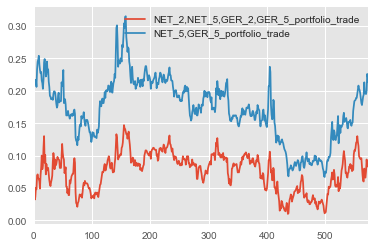

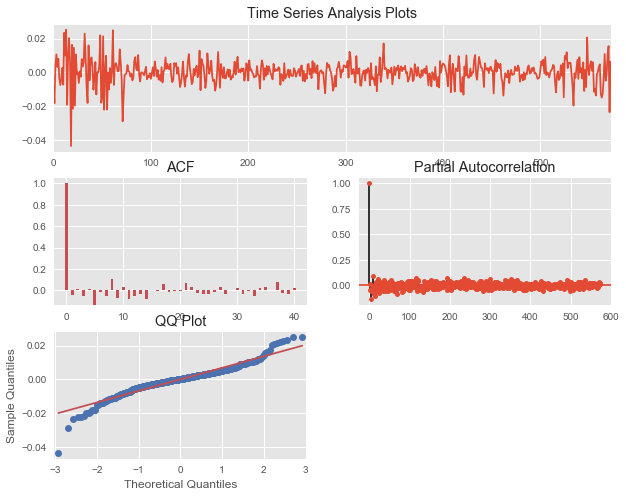

ADF Tests
ADF Statistic: -9.058750
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.52451841450525583, 'Average': 5.6809006395155128e-05, 'half-life': 0.66151574129074076, 'Current_Displacement': -0.00076688103997329536}


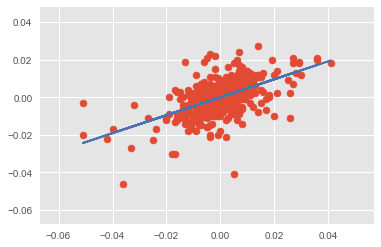

{'beta': array([ 0.47796126]), 'r2-score': 0.31916467170946328}
[2, 7]
['NET', 'GER']
Regression time series


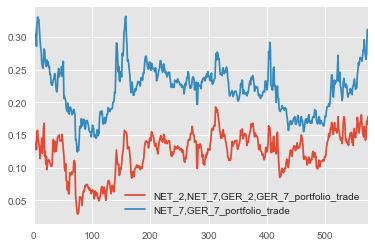

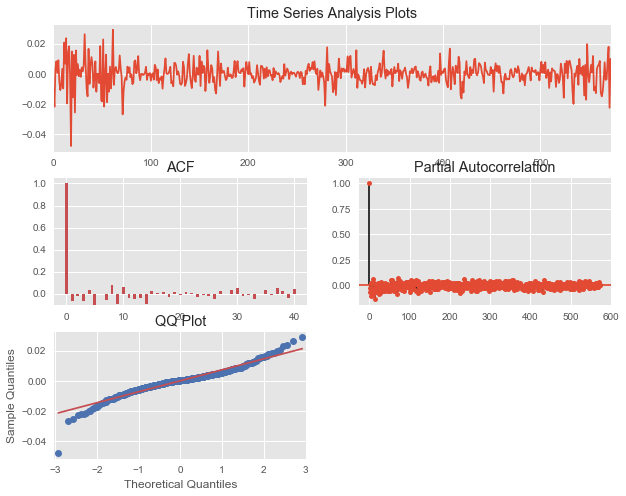

ADF Tests
ADF Statistic: -8.720702
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.535335683034728, 'Average': 4.5050125028035435e-05, 'half-life': 0.64834041068984127, 'Current_Displacement': -0.00053055549683789032}


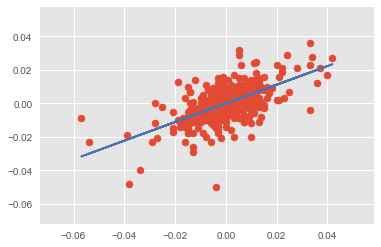

{'beta': array([ 0.55756056]), 'r2-score': 0.36698800039415802}
[2, 10]
['NET', 'GER']
Regression time series


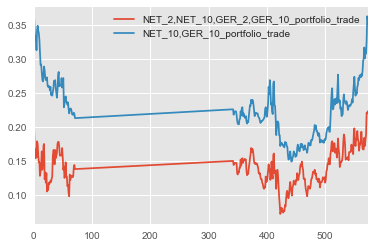

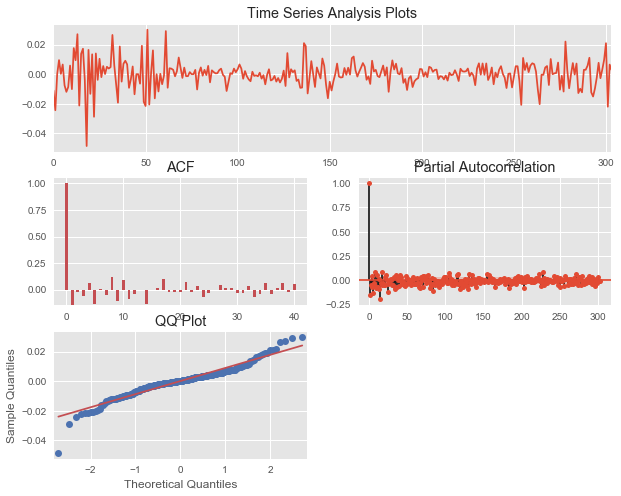

ADF Tests
ADF Statistic: -6.465843
p-value: 0.000000
Critical Values:
	5%: -2.872
	1%: -3.453
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.57541226023222247, 'Average': 9.5216304077646124e-05, 'half-life': 0.60358785254055602, 'Current_Displacement': -0.0028140699796756694}


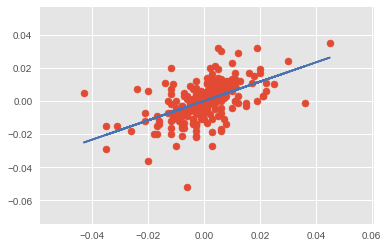

{'beta': array([ 0.58185726]), 'r2-score': 0.29129817392781598}
[5, 10]
['NET', 'GER']
Regression time series


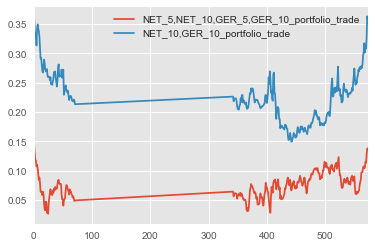

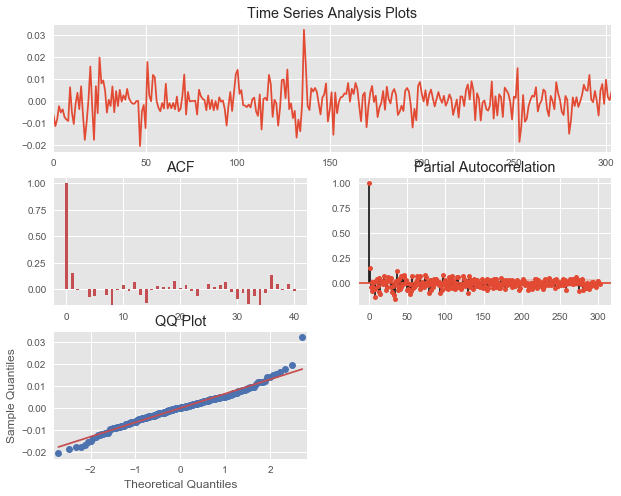

ADF Tests
ADF Statistic: -7.923292
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.453
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.42477337219339351, 'Average': -7.6549170236176638e-06, 'half-life': 0.81672612378527776, 'Current_Displacement': -0.0041433961905512585}


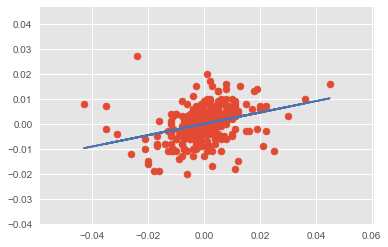

{'beta': array([ 0.22714825]), 'r2-score': 0.10309737402881058}
[5, 15]
['NET', 'GER']
Regression time series


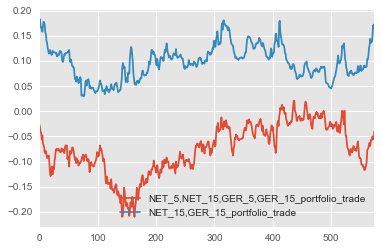

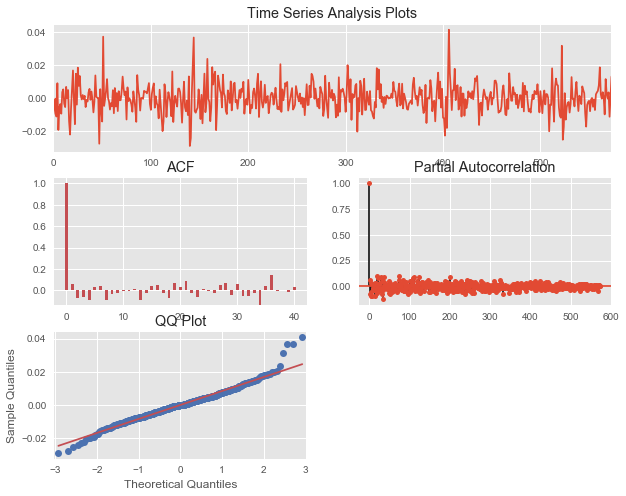

ADF Tests
ADF Statistic: -13.897963
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.46958021768402536, 'Average': -6.1910577521605229e-06, 'half-life': 0.73736154445302504, 'Current_Displacement': -0.012903185691025804}


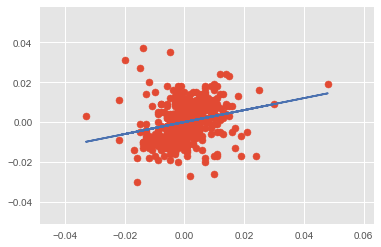

{'beta': array([ 0.30042934]), 'r2-score': 0.05811108430278944}
[7, 15]
['NET', 'GER']
Regression time series


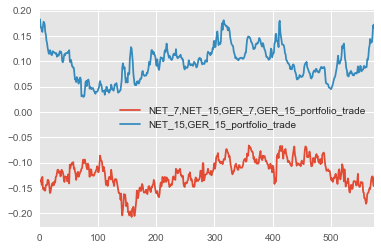

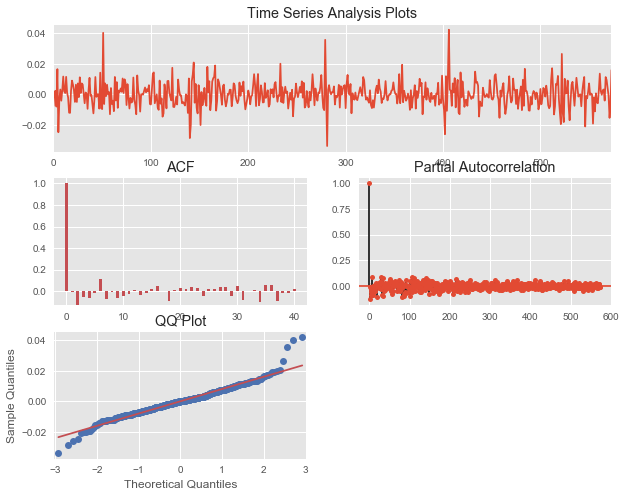

ADF Tests
ADF Statistic: -9.583468
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.50255129661426223, 'Average': 1.4750206681659451e-05, 'half-life': 0.6878316413766864, 'Current_Displacement': -0.01584295999009834}


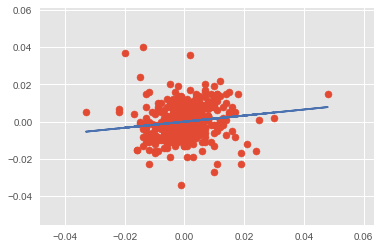

{'beta': array([ 0.16318426]), 'r2-score': 0.019685689998625522}
[2, 30]
['NET', 'GER']
Regression time series


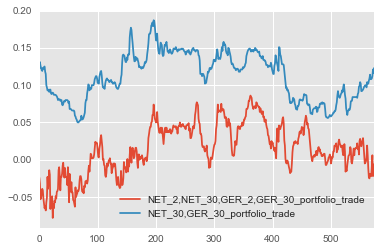

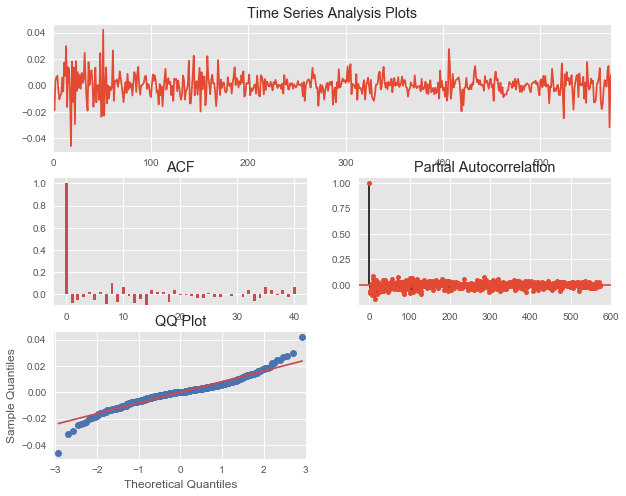

ADF Tests
ADF Statistic: -6.961101
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.54228046317532796, 'Average': 4.8270437117336526e-05, 'half-life': 0.63970773511152068, 'Current_Displacement': -0.0090386501686651154}


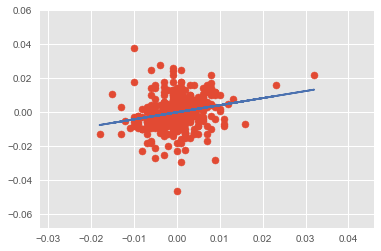

{'beta': array([ 0.4161542]), 'r2-score': 0.04760032168160222}
[5, 30]
['NET', 'GER']
Regression time series


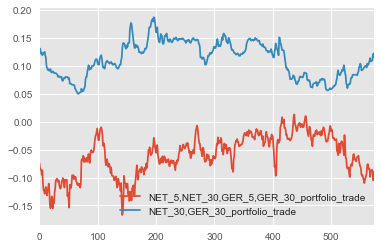

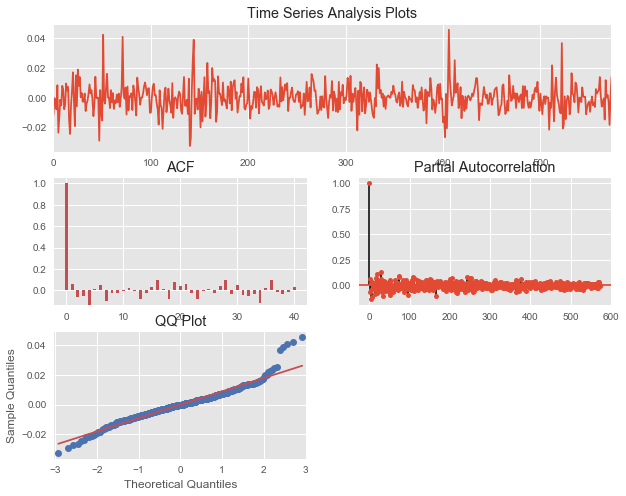

ADF Tests
ADF Statistic: -10.918050
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.46926077888060447, 'Average': -5.5334546668755374e-06, 'half-life': 0.7380275934169197, 'Current_Displacement': -0.01397946645145429}


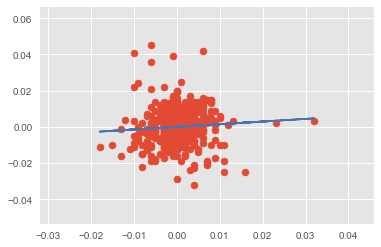

{'beta': array([ 0.146581]), 'r2-score': 0.0049858326223408689}
[10, 30]
['NET', 'GER']
Regression time series


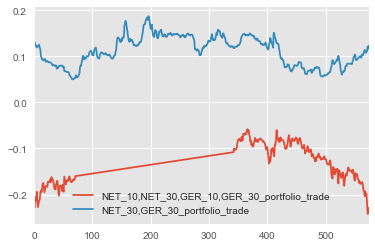

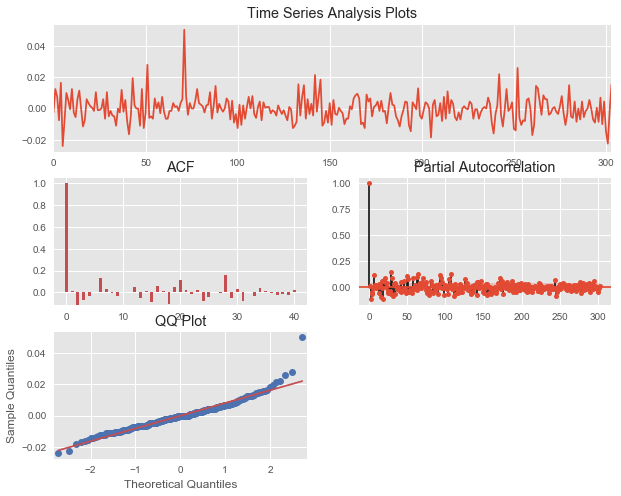

ADF Tests
ADF Statistic: -13.695654
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.49194887116146302, 'Average': -0.00012497648602685641, 'half-life': 0.70024816431439829, 'Current_Displacement': -0.015629788900091066}


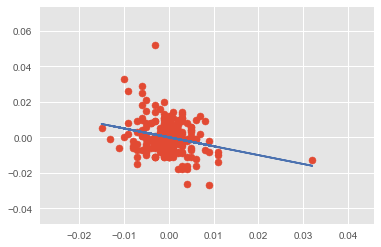

{'beta': array([-0.50068749]), 'r2-score': 0.059307230229778796}
[5, 15]
['NET', 'GER']
Regression time series


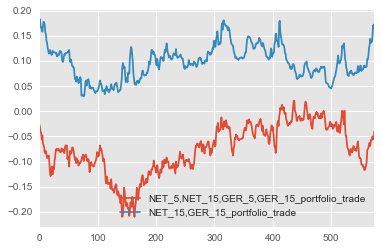

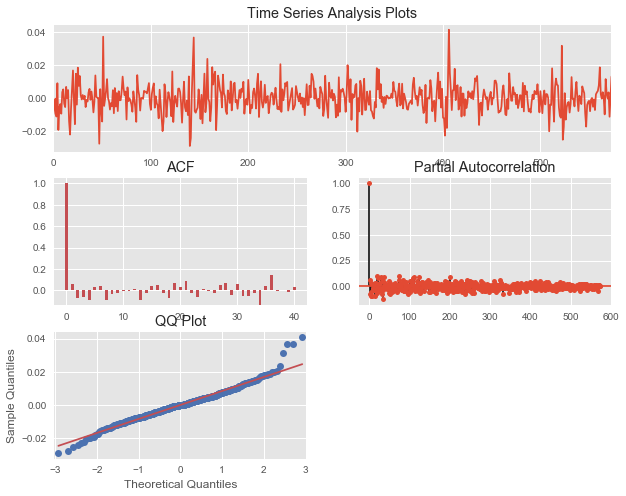

ADF Tests
ADF Statistic: -13.897963
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.46958021768402536, 'Average': -6.1910577521605229e-06, 'half-life': 0.73736154445302504, 'Current_Displacement': -0.012903185691025804}


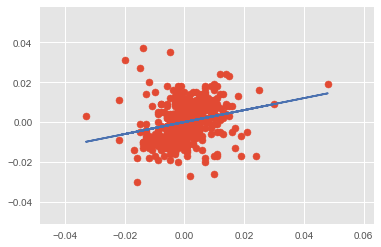

{'beta': array([ 0.30042934]), 'r2-score': 0.05811108430278944}
[2, 5]
['FIN', 'GER']
Regression time series


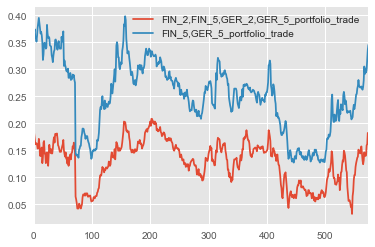

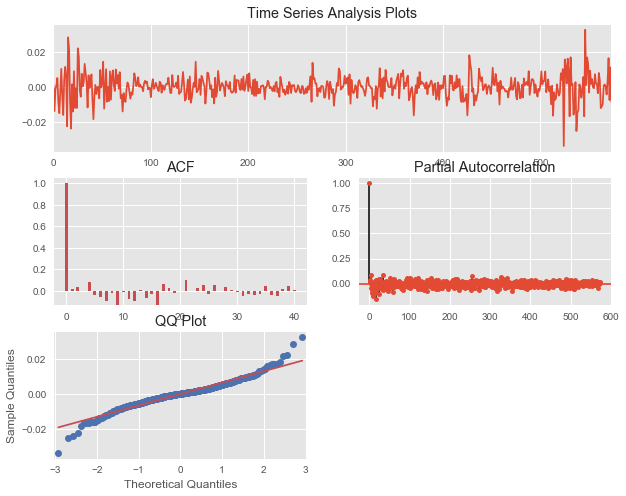

ADF Tests
ADF Statistic: -9.456679
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.49114123274585475, 'Average': 1.6287710991461003e-05, 'half-life': 0.70452331445295546, 'Current_Displacement': 0.0086991542364956778}


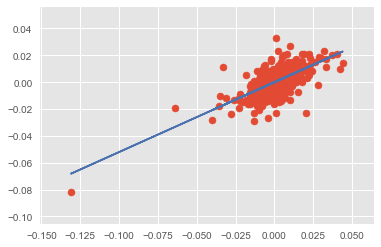

{'beta': array([ 0.5203185]), 'r2-score': 0.47065144007959914}
[2, 7]
['FIN', 'GER']
Regression time series


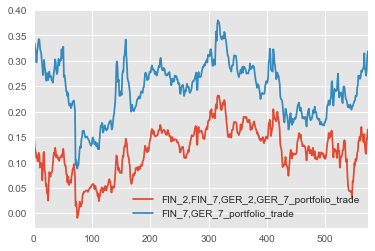

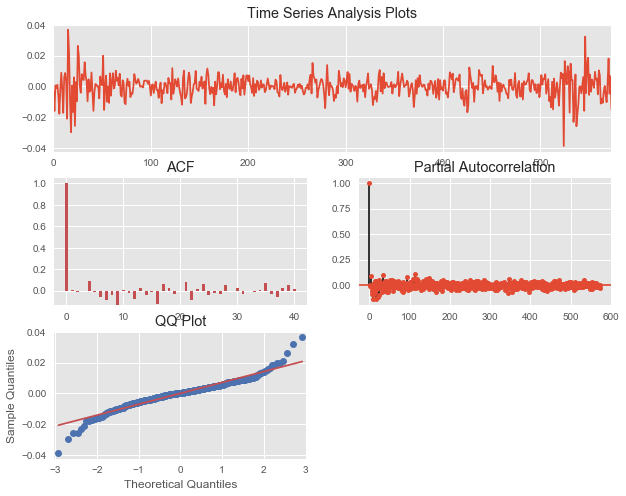

ADF Tests
ADF Statistic: -8.594041
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.49562923126137182, 'Average': 2.2005065840386766e-05, 'half-life': 0.69657567216303207, 'Current_Displacement': 0.015104638192612747}


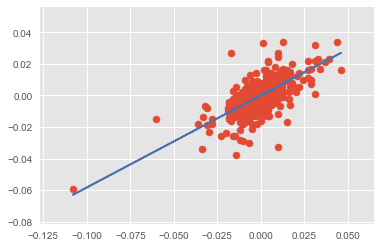

{'beta': array([ 0.58347337]), 'r2-score': 0.47251040433790947}
[2, 10]
['FIN', 'GER']
Regression time series


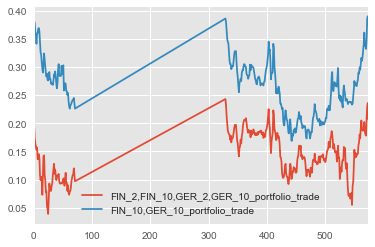

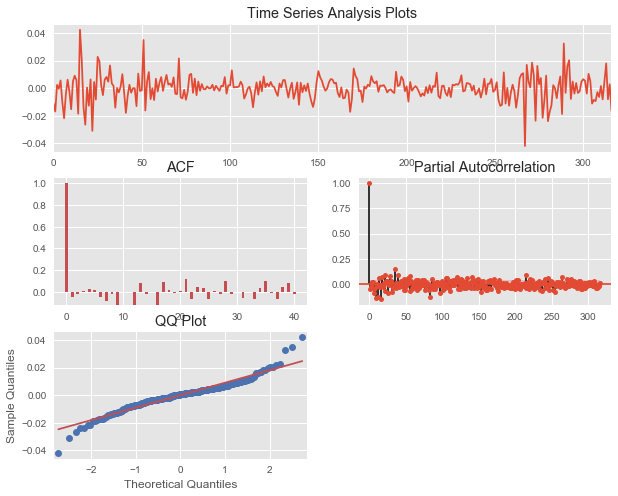

ADF Tests
ADF Statistic: -18.598377
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.52417004884217833, 'Average': 6.1715428529333425e-05, 'half-life': 0.65924270391237683, 'Current_Displacement': 0.016624822527882603}


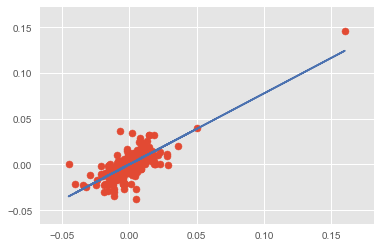

{'beta': array([ 0.77730581]), 'r2-score': 0.59826945697967915}
[5, 10]
['FIN', 'GER']
Regression time series


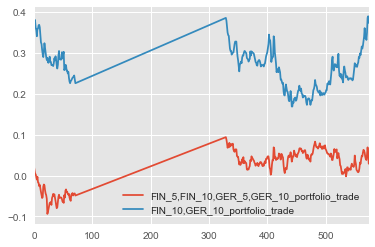

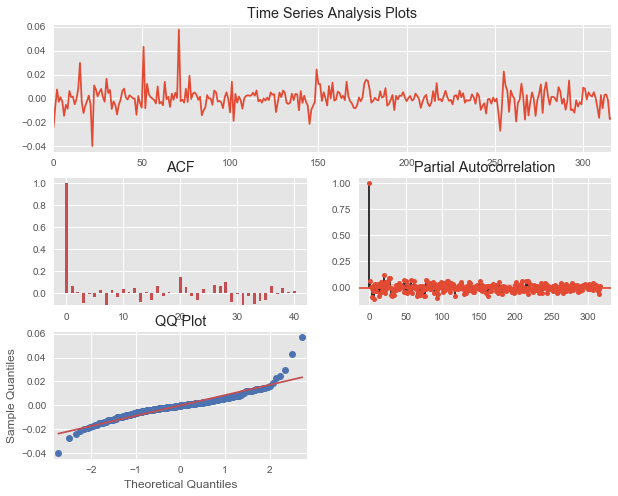

ADF Tests
ADF Statistic: -16.718138
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.47093168760369009, 'Average': 6.5837485968384444e-05, 'half-life': 0.74115846567523114, 'Current_Displacement': 0.016502386819135129}


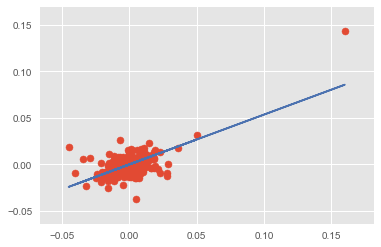

{'beta': array([ 0.53521567]), 'r2-score': 0.43872909111418534}
[5, 15]
['FIN', 'GER']
Regression time series


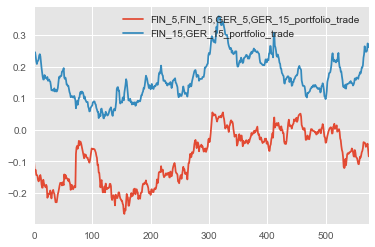

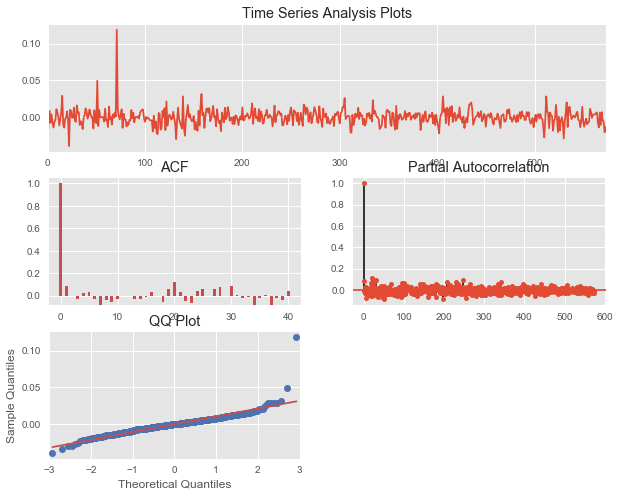

ADF Tests
ADF Statistic: -22.130412
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.4617042256875632, 'Average': 5.7686806409903314e-05, 'half-life': 0.75651042090093978, 'Current_Displacement': 0.013405056110765043}


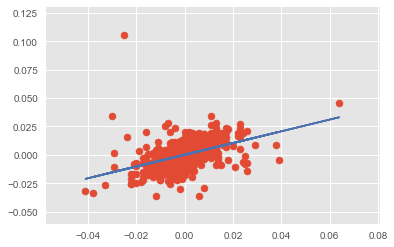

{'beta': array([ 0.51695897]), 'r2-score': 0.19685680695896612}
[7, 15]
['FIN', 'GER']
Regression time series


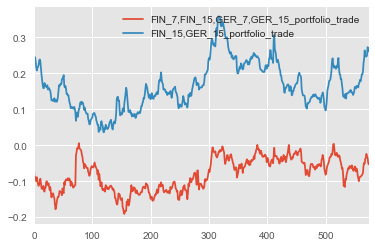

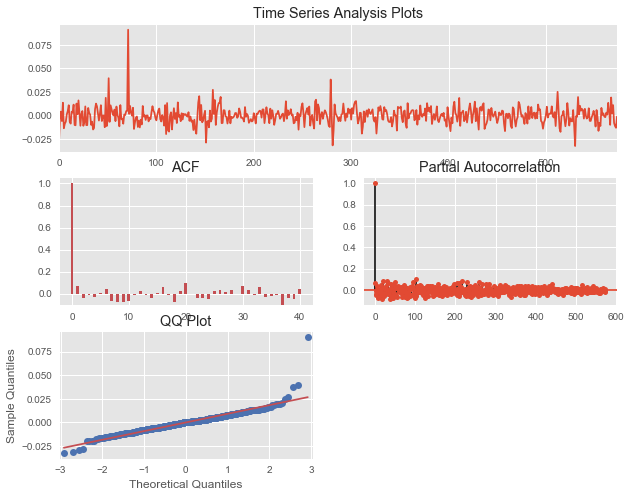

ADF Tests
ADF Statistic: -22.511755
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.47020683871197588, 'Average': 5.6300557060738039e-05, 'half-life': 0.74379414309142056, 'Current_Displacement': 0.0012124304555251192}


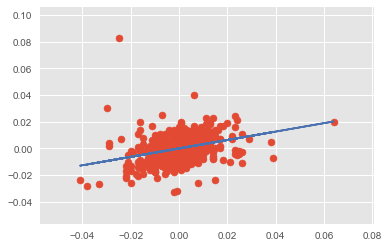

{'beta': array([ 0.31598557]), 'r2-score': 0.10968584626829814}
[2, 30]
['FIN', 'GER']
Regression time series


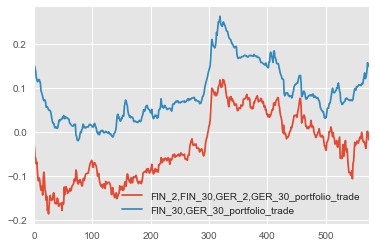

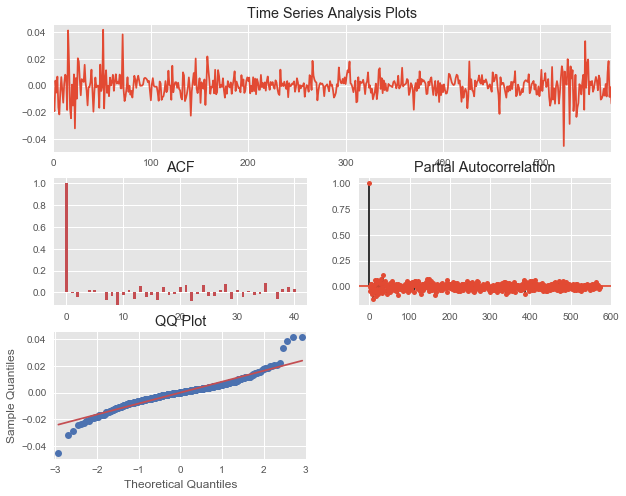

ADF Tests
ADF Statistic: -24.065437
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.50354097238674855, 'Average': 3.5862285300972974e-05, 'half-life': 0.68861252589268018, 'Current_Displacement': 0.013477957773119028}


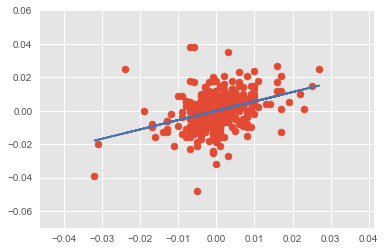

{'beta': array([ 0.55790451]), 'r2-score': 0.12867037692917493}
[5, 30]
['FIN', 'GER']
Regression time series


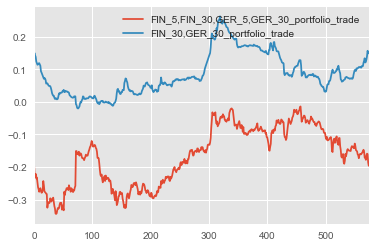

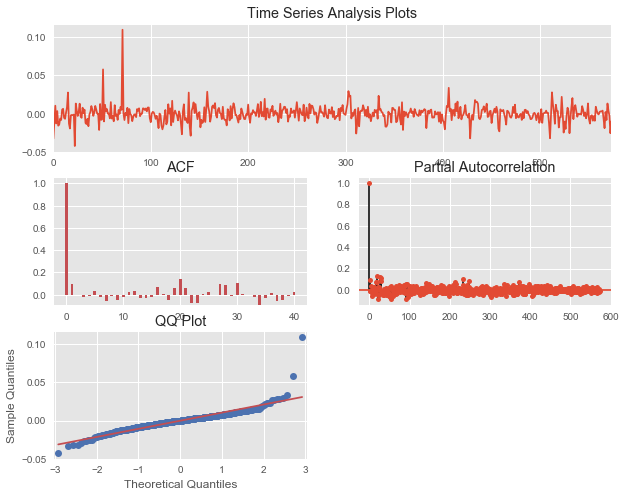

ADF Tests
ADF Statistic: -21.915410
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45685528692439514, 'Average': 4.4388058956604426e-05, 'half-life': 0.76494241394020313, 'Current_Displacement': 0.0099484085986702685}


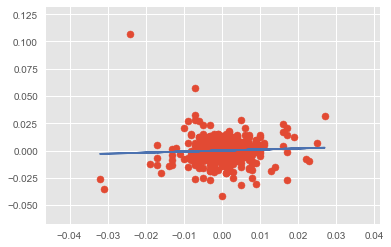

{'beta': array([ 0.09597946]), 'r2-score': 0.0026295732917045456}
[10, 30]
['FIN', 'GER']
Regression time series


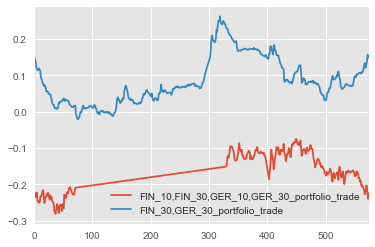

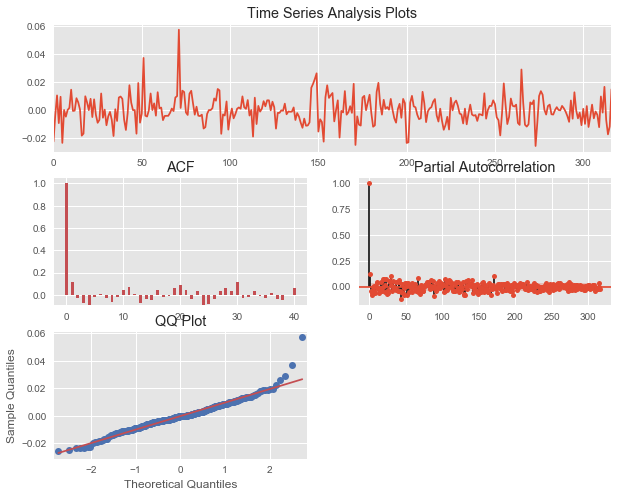

ADF Tests
ADF Statistic: -15.753371
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.44144879430962058, 'Average': -2.9124703628415889e-05, 'half-life': 0.78920448628845685, 'Current_Displacement': -0.014933633188416069}


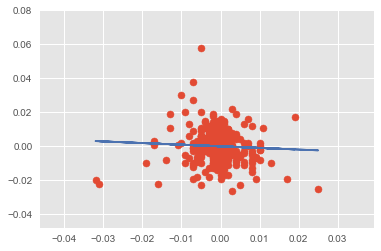

{'beta': array([-0.09549152]), 'r2-score': 0.0029469988834986971}
[5, 15]
['FIN', 'GER']
Regression time series


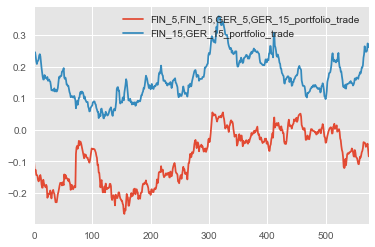

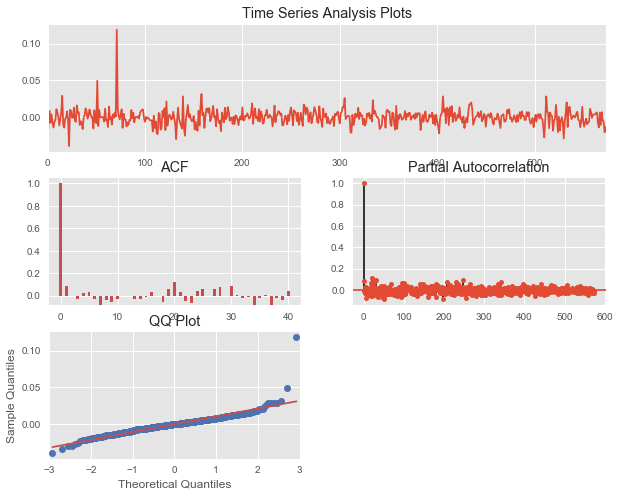

ADF Tests
ADF Statistic: -22.130412
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.4617042256875632, 'Average': 5.7686806409903314e-05, 'half-life': 0.75651042090093978, 'Current_Displacement': 0.013405056110765043}


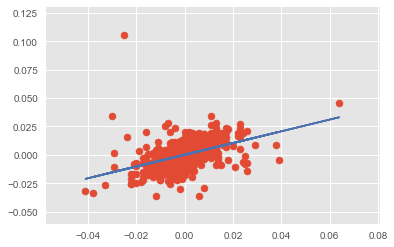

{'beta': array([ 0.51695897]), 'r2-score': 0.19685680695896612}
[2, 5]
['AUT', 'GER']
Regression time series


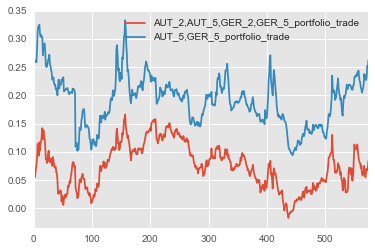

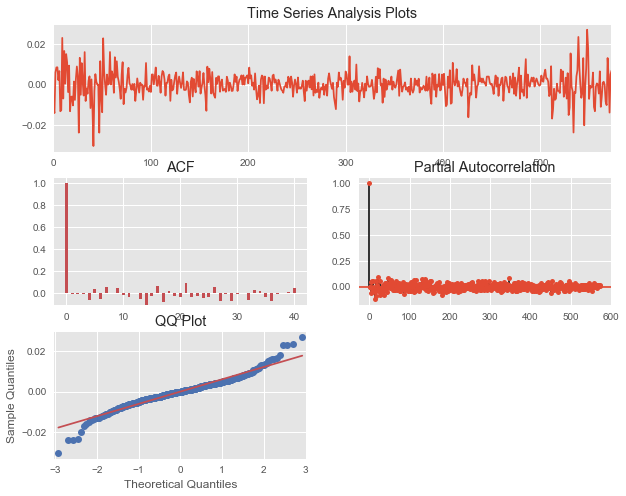

ADF Tests
ADF Statistic: -24.092221
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.5040971001703709, 'Average': 2.5126307337105072e-05, 'half-life': 0.6887650962866515, 'Current_Displacement': -0.0068425037019043686}


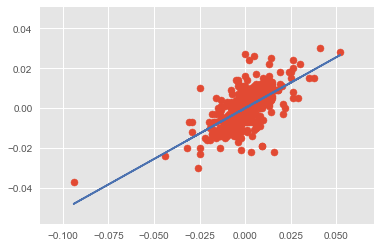

{'beta': array([ 0.51103083]), 'r2-score': 0.42535379500621295}
[2, 7]
['AUT', 'GER']
Regression time series


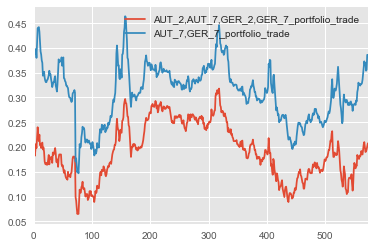

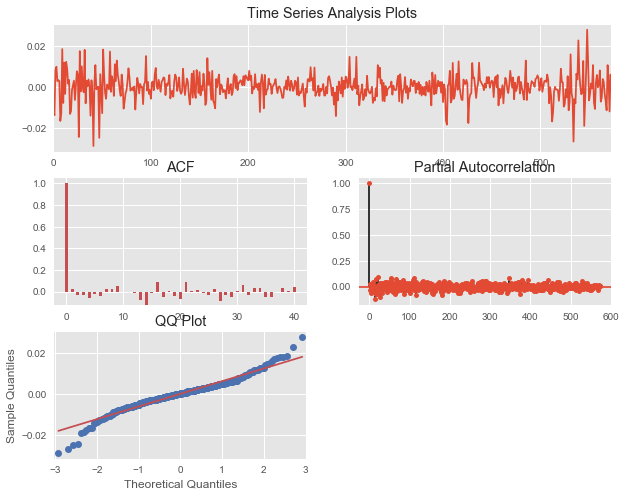

ADF Tests
ADF Statistic: -23.394653
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48940802350326906, 'Average': 2.3879417065267236e-05, 'half-life': 0.71007548220266892, 'Current_Displacement': -0.00097612058293481687}


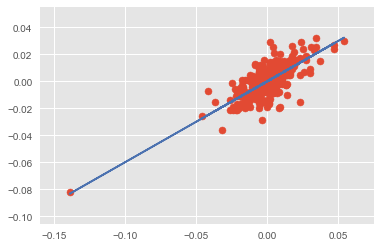

{'beta': array([ 0.59877751]), 'r2-score': 0.57773515552433463}
[2, 10]
['AUT', 'GER']
Regression time series


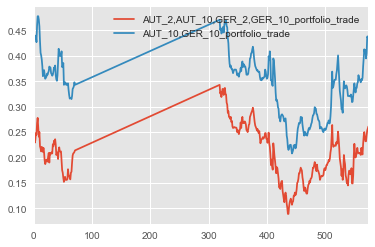

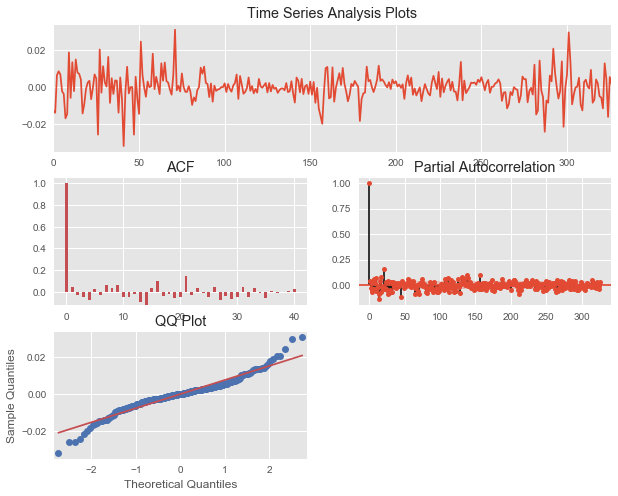

ADF Tests
ADF Statistic: -17.332467
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.48111382432970928, 'Average': 4.7983238242308e-05, 'half-life': 0.72358220597631651, 'Current_Displacement': -0.0016619584665003022}


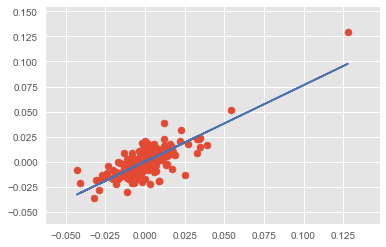

{'beta': array([ 0.76335277]), 'r2-score': 0.63300311327136227}
[5, 10]
['AUT', 'GER']
Regression time series


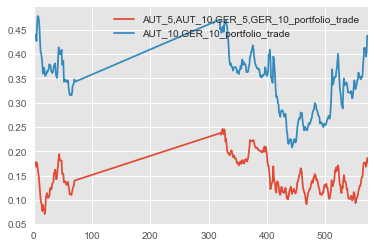

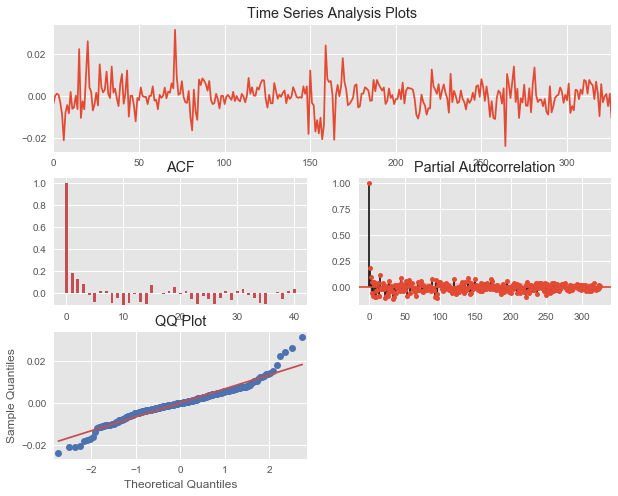

ADF Tests
ADF Statistic: -14.823425
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.40412031253356251, 'Average': -1.8312425581205882e-06, 'half-life': 0.85402008238878502, 'Current_Displacement': 0.01053390742662946}


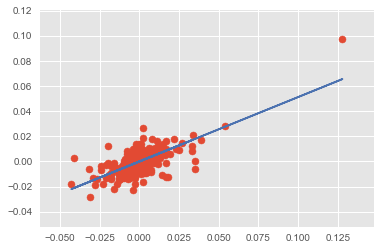

{'beta': array([ 0.51191289]), 'r2-score': 0.50815848515923778}
[5, 15]
['AUT', 'GER']
Regression time series


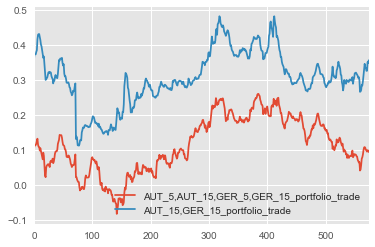

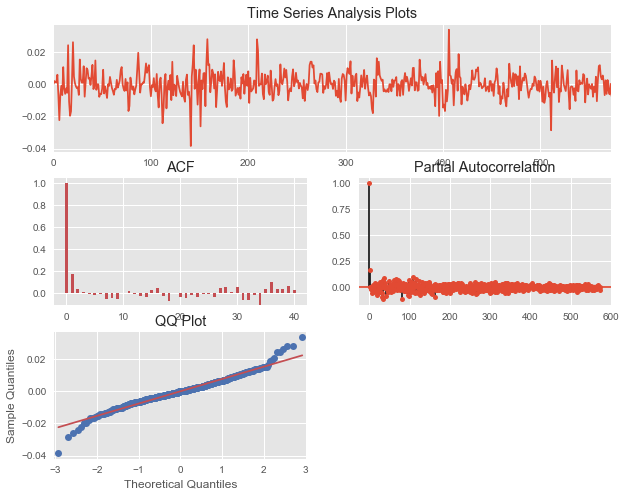

ADF Tests
ADF Statistic: -20.099822
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.41436067972568469, 'Average': -1.9466187791989512e-05, 'half-life': 0.83561542173616865, 'Current_Displacement': 0.0072477815992208292}


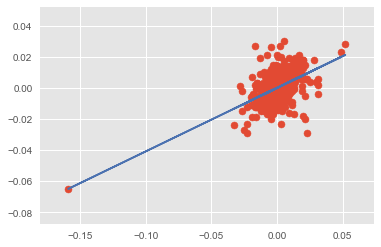

{'beta': array([ 0.40840597]), 'r2-score': 0.26853570675884553}
[7, 15]
['AUT', 'GER']
Regression time series


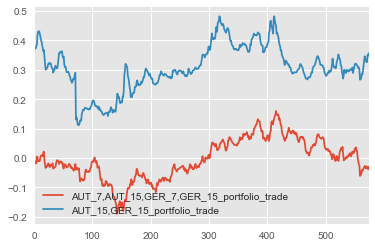

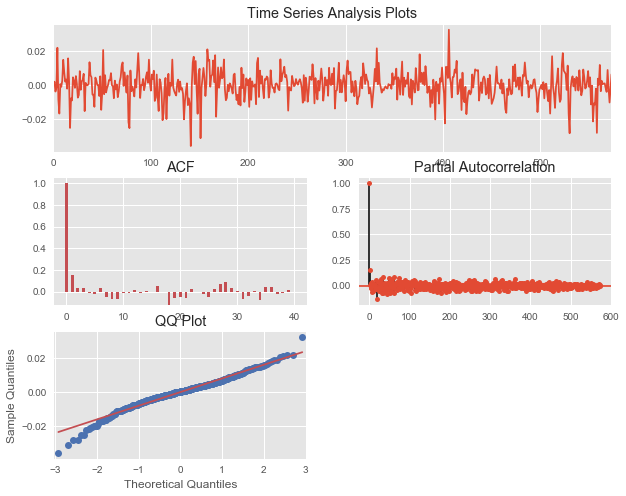

ADF Tests
ADF Statistic: -20.546885
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.42507583822115802, 'Average': -1.604287218725345e-05, 'half-life': 0.81480352301395409, 'Current_Displacement': -0.0063386322363332874}


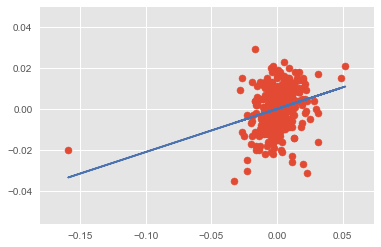

{'beta': array([ 0.20967633]), 'r2-score': 0.080702790900086918}
[2, 30]
['AUT', 'GER']
Regression time series


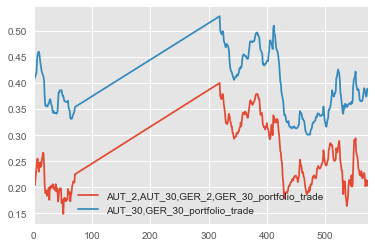

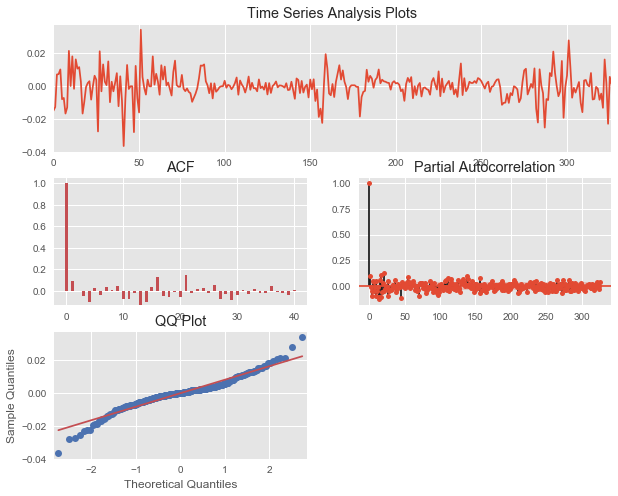

ADF Tests
ADF Statistic: -16.448971
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.45506713306330382, 'Average': 4.7134208841691742e-05, 'half-life': 0.76580517535408632, 'Current_Displacement': -0.0013734012368620701}


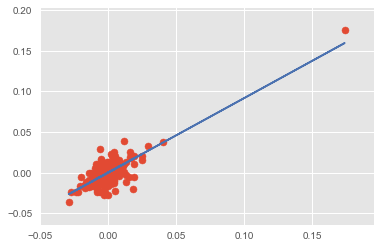

{'beta': array([ 0.91589291]), 'r2-score': 0.65385513169575205}
[5, 30]
['AUT', 'GER']
Regression time series


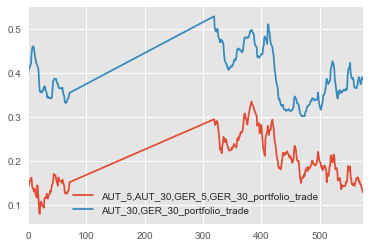

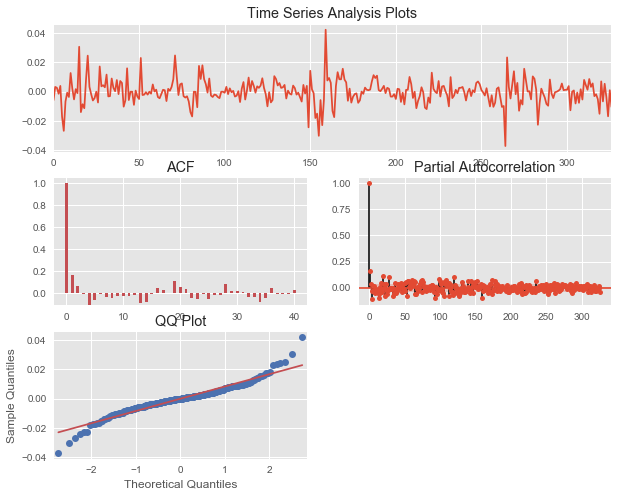

ADF Tests
ADF Statistic: -15.265248
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.41834140122958863, 'Average': -1.5377375730848268e-05, 'half-life': 0.82684938137558295, 'Current_Displacement': 0.010380792282345858}


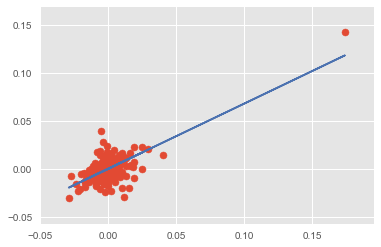

{'beta': array([ 0.67923393]), 'r2-score': 0.50042271962233031}
[10, 30]
['AUT', 'GER']
Regression time series


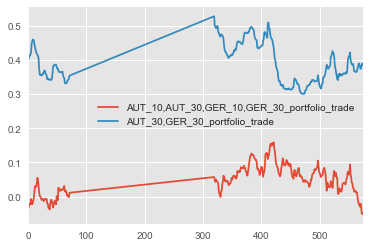

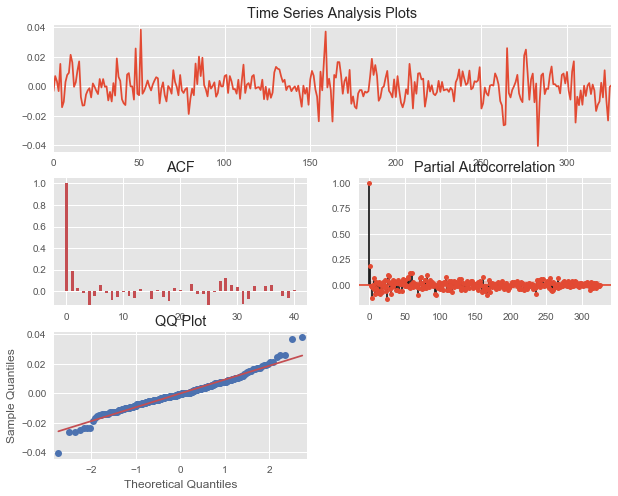

ADF Tests
ADF Statistic: -9.750526
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.40740557260339194, 'Average': -3.4212436148251091e-05, 'half-life': 0.85085365198569063, 'Current_Displacement': -0.00080198542321347052}


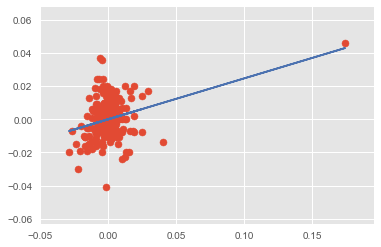

{'beta': array([ 0.2464454]), 'r2-score': 0.095108026618723529}
[5, 15]
['AUT', 'GER']
Regression time series


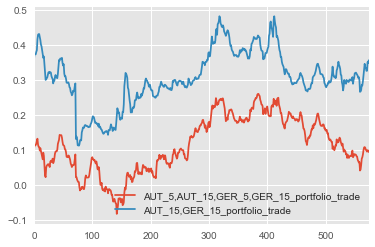

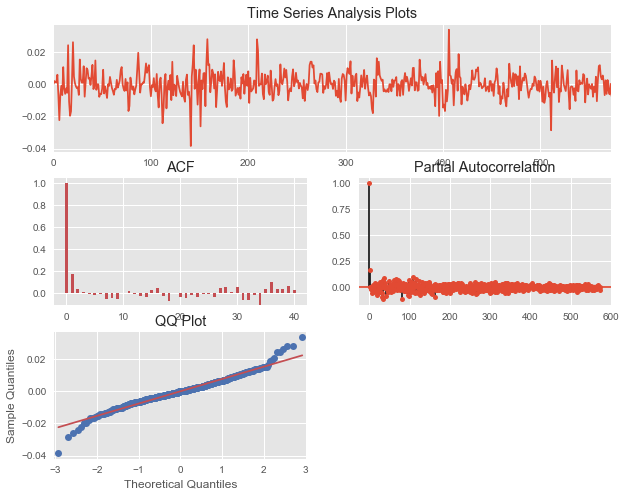

ADF Tests
ADF Statistic: -20.099822
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.41436067972568469, 'Average': -1.9466187791989512e-05, 'half-life': 0.83561542173616865, 'Current_Displacement': 0.0072477815992208292}


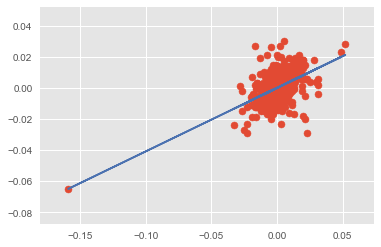

{'beta': array([ 0.40840597]), 'r2-score': 0.26853570675884553}
[2, 5]
['FRA', 'GER']
Regression time series


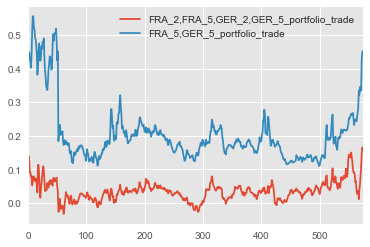

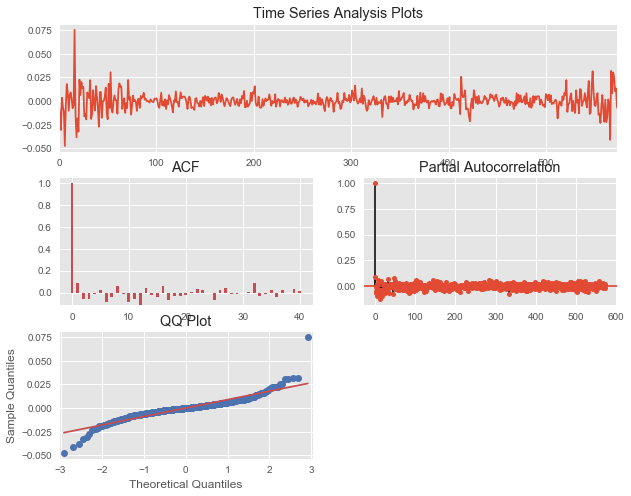

ADF Tests
ADF Statistic: -7.497125
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.45757434532562313, 'Average': 3.0581160548020446e-05, 'half-life': 0.7571185658423023, 'Current_Displacement': 0.0069317623275787317}


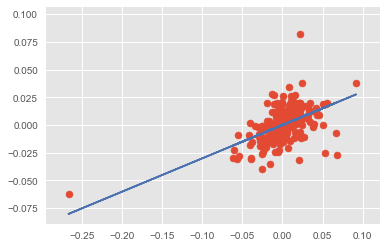

{'beta': array([ 0.30039372]), 'r2-score': 0.28539603103044753}
[2, 7]
['FRA', 'GER']
Regression time series


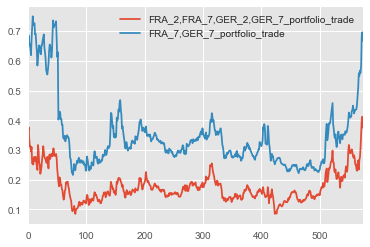

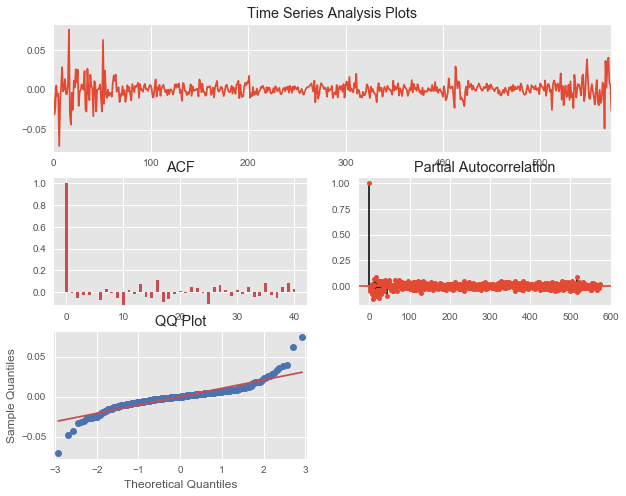

ADF Tests
ADF Statistic: -7.748470
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.5041114689137316, 'Average': 8.2575707710767127e-06, 'half-life': 0.68366063664701737, 'Current_Displacement': 0.026543203195852561}


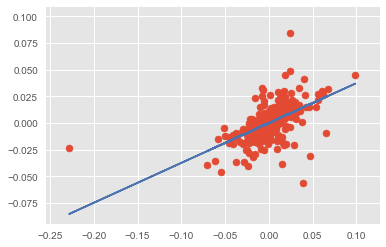

{'beta': array([ 0.37375194]), 'r2-score': 0.31526506336169846}
[2, 10]
['FRA', 'GER']
Regression time series


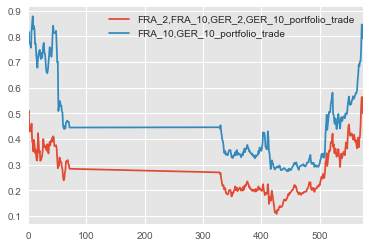

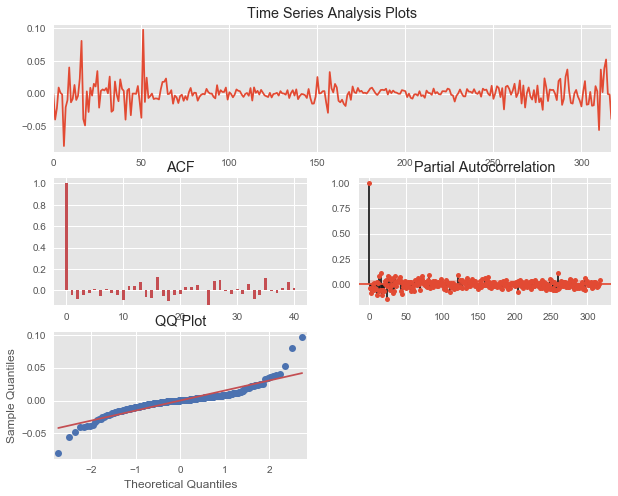

ADF Tests
ADF Statistic: -8.235124
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.51735182363851995, 'Average': 8.2520407444356319e-06, 'half-life': 0.66333159732999647, 'Current_Displacement': 0.038769068949128932}


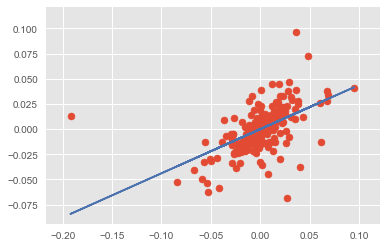

{'beta': array([ 0.43847515]), 'r2-score': 0.29976969960299671}
[5, 10]
['FRA', 'GER']
Regression time series


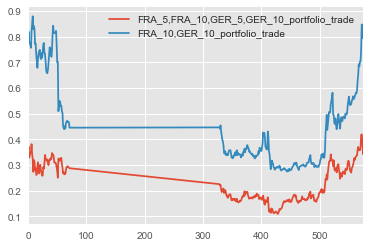

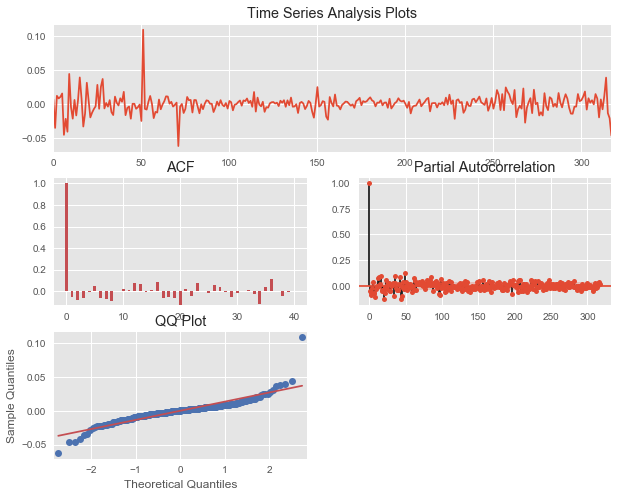

ADF Tests
ADF Statistic: -7.766019
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.51609315701047254, 'Average': -6.9410982017016954e-05, 'half-life': 0.65948749293764819, 'Current_Displacement': 0.046554880021963646}


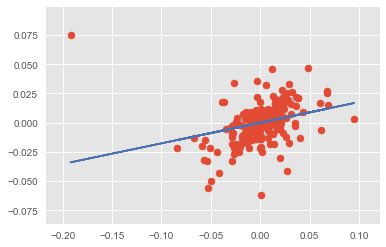

{'beta': array([ 0.17690017]), 'r2-score': 0.082318176018771116}
[5, 15]
['FRA', 'GER']
Regression time series


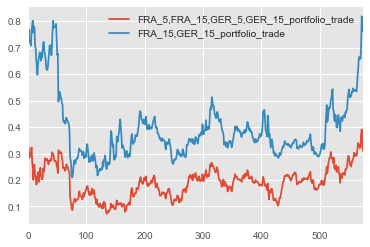

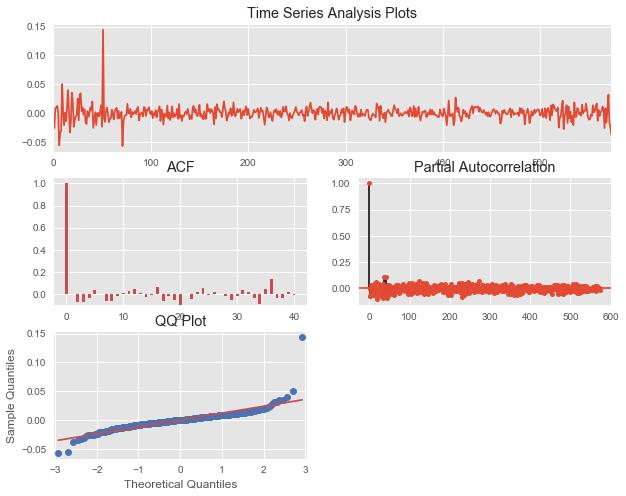

ADF Tests
ADF Statistic: -23.749492
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.49693330835895155, 'Average': -1.5139919309236128e-05, 'half-life': 0.6917795978378436, 'Current_Displacement': 0.038108546767825505}


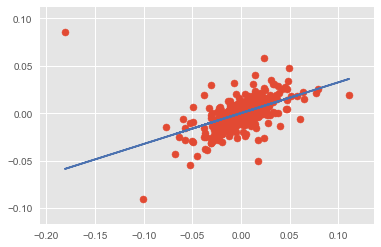

{'beta': array([ 0.32454449]), 'r2-score': 0.24843214921244405}
[7, 15]
['FRA', 'GER']
Regression time series


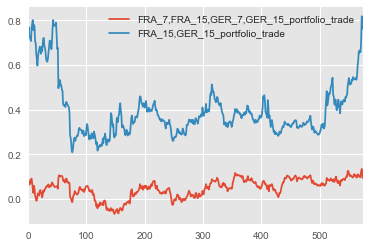

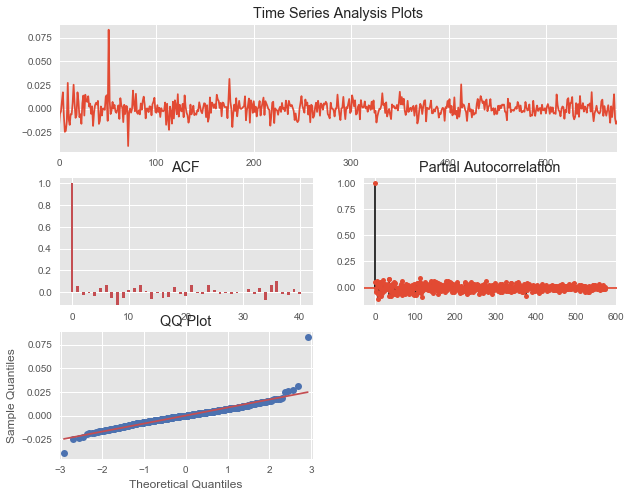

ADF Tests
ADF Statistic: -22.691436
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.4741694991986577, 'Average': 2.0399006768895739e-05, 'half-life': 0.7323950315015969, 'Current_Displacement': 0.013550923406231988}


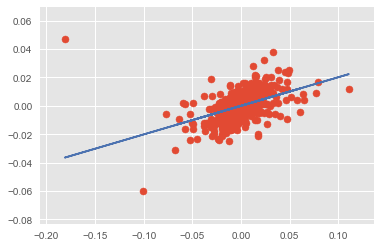

{'beta': array([ 0.20133607]), 'r2-score': 0.20307501837601827}
[2, 30]
['FRA', 'GER']
Regression time series


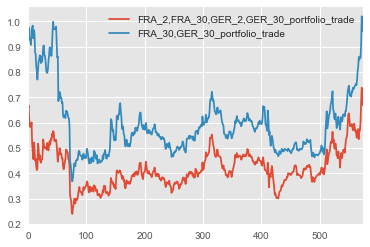

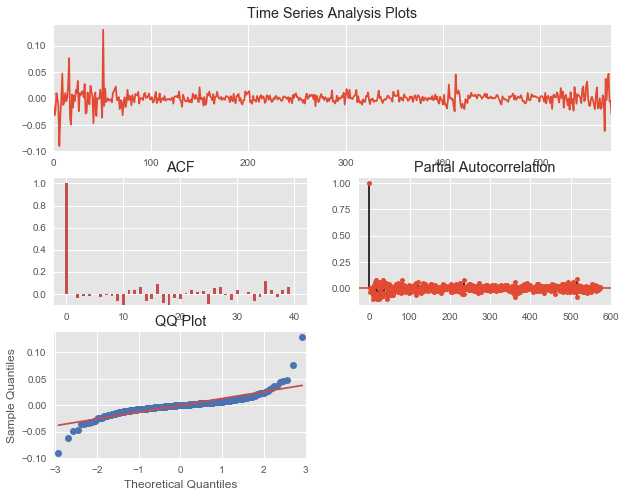

ADF Tests
ADF Statistic: -8.170544
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.49843661632898895, 'Average': 1.5774757641198631e-05, 'half-life': 0.6925748108519697, 'Current_Displacement': 0.03035617274844039}


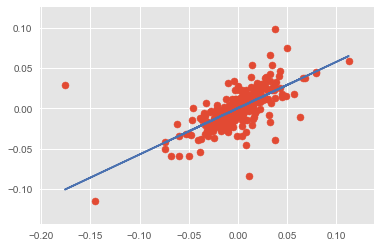

{'beta': array([ 0.57319204]), 'r2-score': 0.47700969685671024}
[5, 30]
['FRA', 'GER']
Regression time series


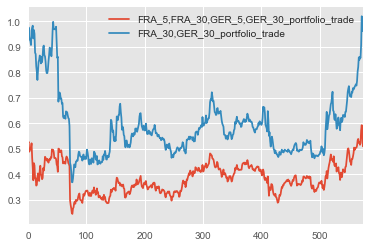

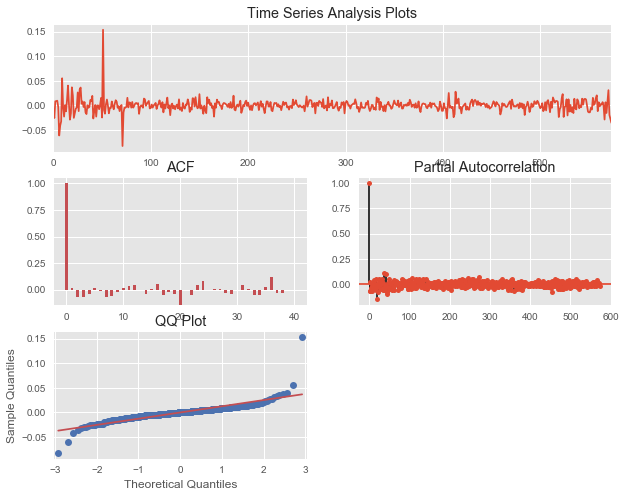

ADF Tests
ADF Statistic: -23.334108
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48811300650735623, 'Average': -2.3441632874795543e-05, 'half-life': 0.70561999323428737, 'Current_Displacement': 0.035140373885973519}


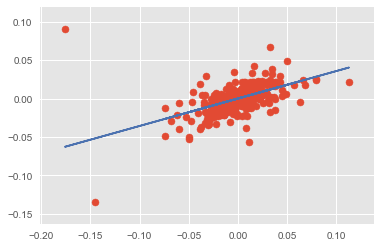

{'beta': array([ 0.35672369]), 'r2-score': 0.26981342683899212}
[10, 30]
['FRA', 'GER']
Regression time series


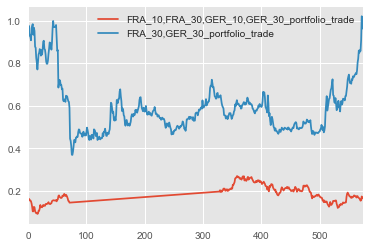

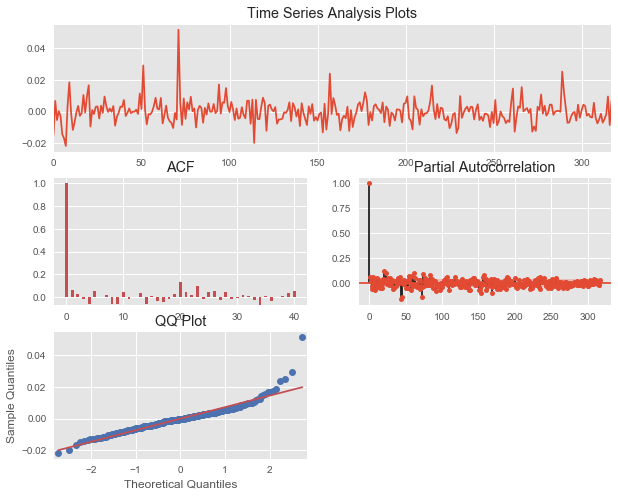

ADF Tests
ADF Statistic: -16.825065
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.47331707078300267, 'Average': 5.3463209978513567e-05, 'half-life': 0.73620589302807216, 'Current_Displacement': -0.0066722549648790576}


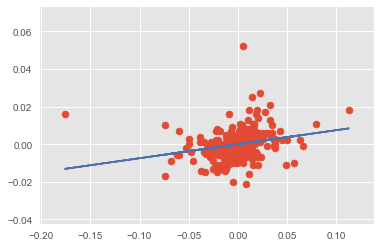

{'beta': array([ 0.07451436]), 'r2-score': 0.0552465974957983}
[5, 15]
['FRA', 'GER']
Regression time series


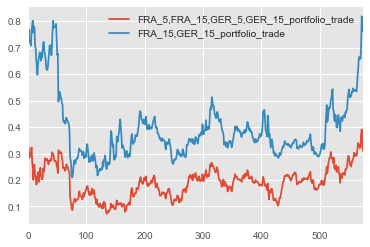

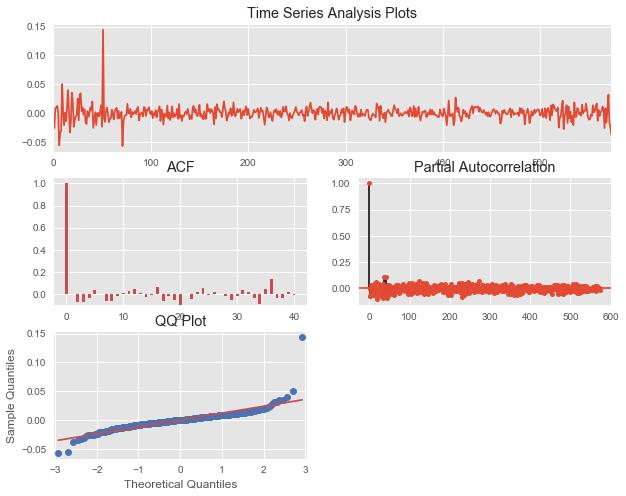

ADF Tests
ADF Statistic: -23.749492
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.49693330835895155, 'Average': -1.5139919309236128e-05, 'half-life': 0.6917795978378436, 'Current_Displacement': 0.038108546767825505}


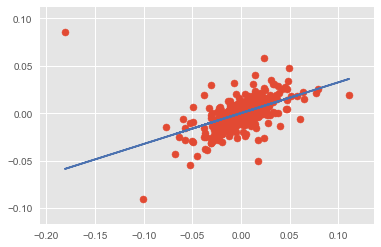

{'beta': array([ 0.32454449]), 'r2-score': 0.24843214921244405}
[2, 5]
['BEL', 'GER']
Regression time series


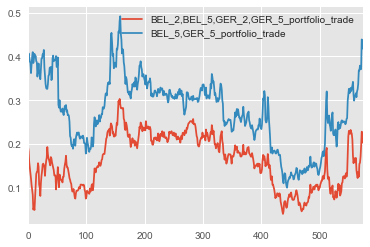

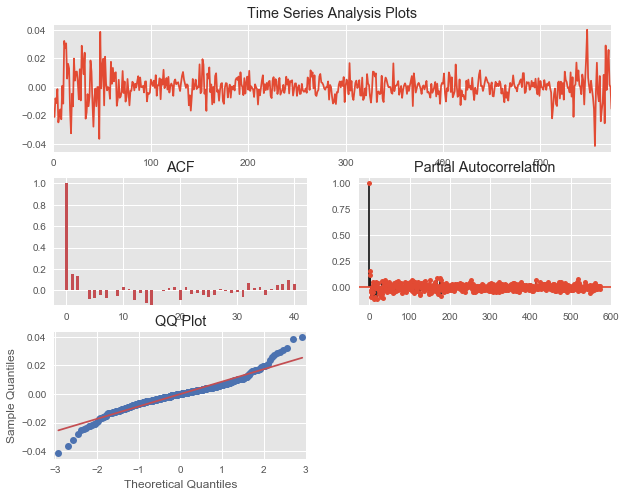

ADF Tests
ADF Statistic: -8.366692
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.42540504702120374, 'Average': 2.7316114363637301e-05, 'half-life': 0.81624530528334593, 'Current_Displacement': 0.015200443477654564}


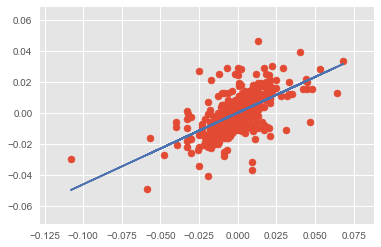

{'beta': array([ 0.46040427]), 'r2-score': 0.37238540049194546}
[2, 7]
['BEL', 'GER']
Regression time series


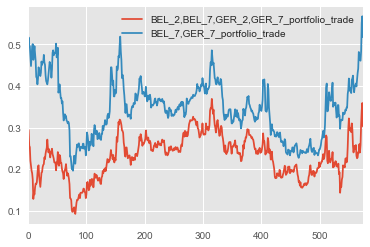

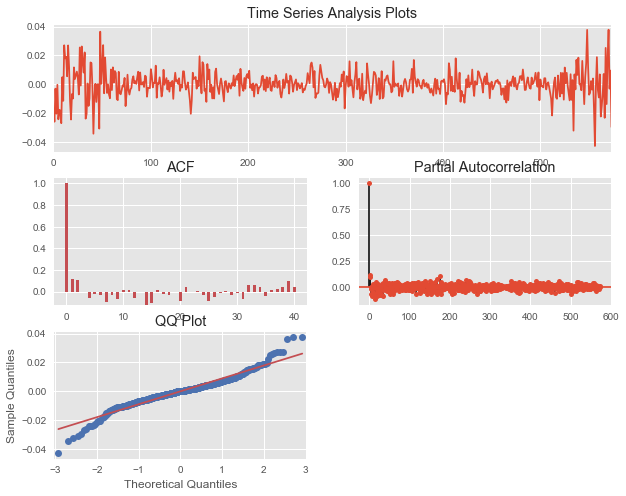

ADF Tests
ADF Statistic: -8.451403
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.43723492478310633, 'Average': 1.3742368647695983e-05, 'half-life': 0.78712142065169854, 'Current_Displacement': 0.029549588252199031}


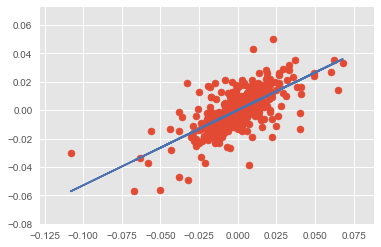

{'beta': array([ 0.52928308]), 'r2-score': 0.47137657221655005}
[2, 10]
['BEL', 'GER']
Regression time series


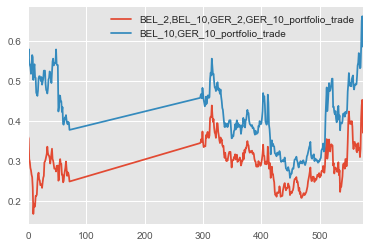

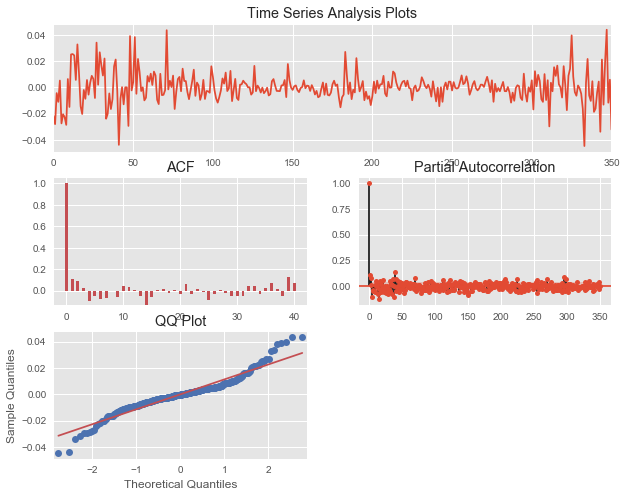

ADF Tests
ADF Statistic: -16.617681
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.442439331257519, 'Average': 2.7996315627249638e-05, 'half-life': 0.77786701150857418, 'Current_Displacement': 0.032100555307319346}


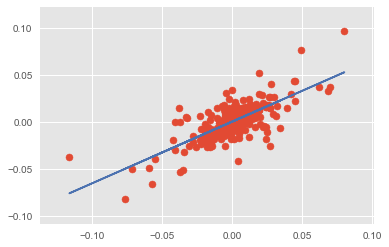

{'beta': array([ 0.65694001]), 'r2-score': 0.54577267841097732}
[5, 10]
['BEL', 'GER']
Regression time series


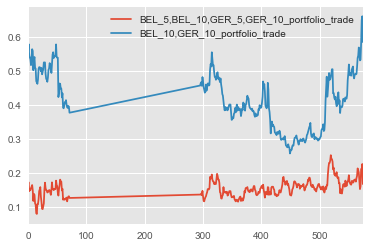

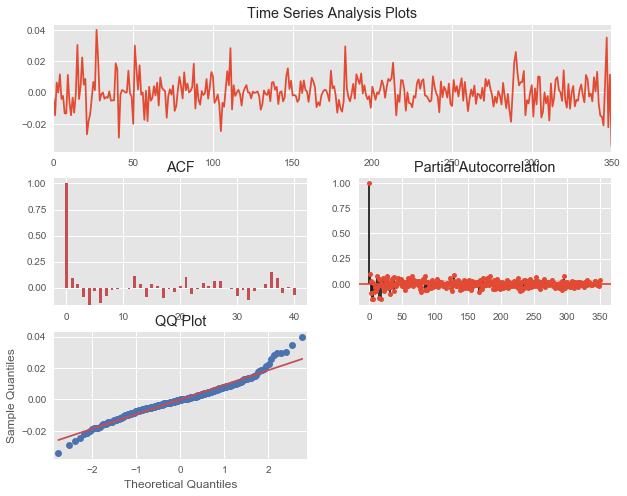

ADF Tests
ADF Statistic: -6.268603
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.450
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.44233122410528836, 'Average': -2.9111479287944537e-05, 'half-life': 0.76695181331859974, 'Current_Displacement': 0.034131105850212708}


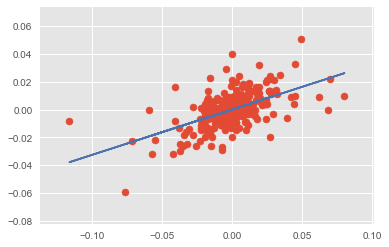

{'beta': array([ 0.32683925]), 'r2-score': 0.30572706254559123}
[5, 15]
['BEL', 'GER']
Regression time series


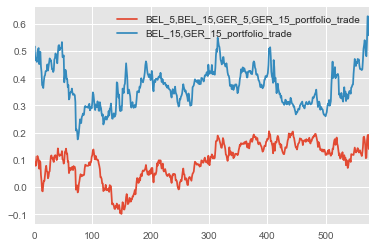

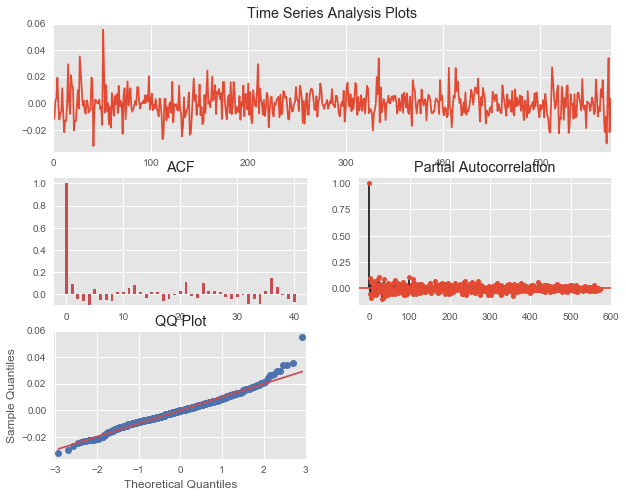

ADF Tests
ADF Statistic: -10.735460
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45119258440764876, 'Average': 1.6660513695372406e-05, 'half-life': 0.76637221635177577, 'Current_Displacement': 0.019774246192712064}


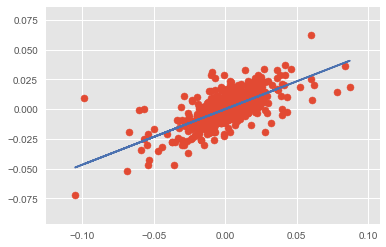

{'beta': array([ 0.46728137]), 'r2-score': 0.46527224245217091}
[7, 15]
['BEL', 'GER']
Regression time series


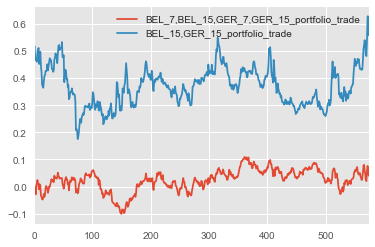

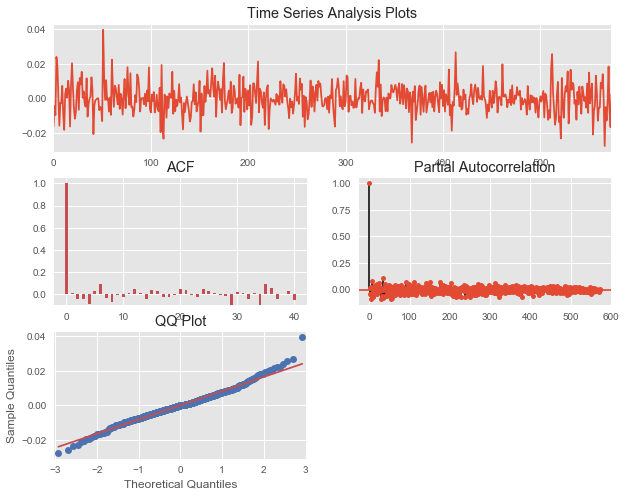

ADF Tests
ADF Statistic: -23.650394
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.49484276301604857, 'Average': 4.6864754596279936e-05, 'half-life': 0.70278578960862903, 'Current_Displacement': -0.0023554748820697456}


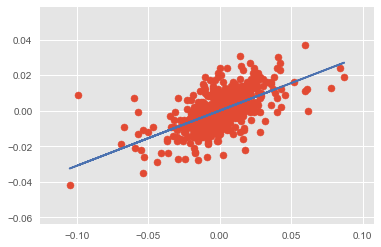

{'beta': array([ 0.31017884]), 'r2-score': 0.35957508419568895}
[2, 30]
['BEL', 'GER']
Regression time series


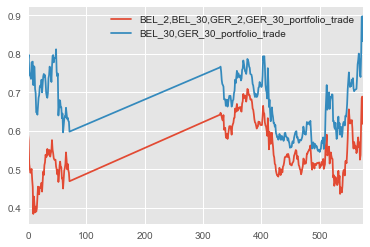

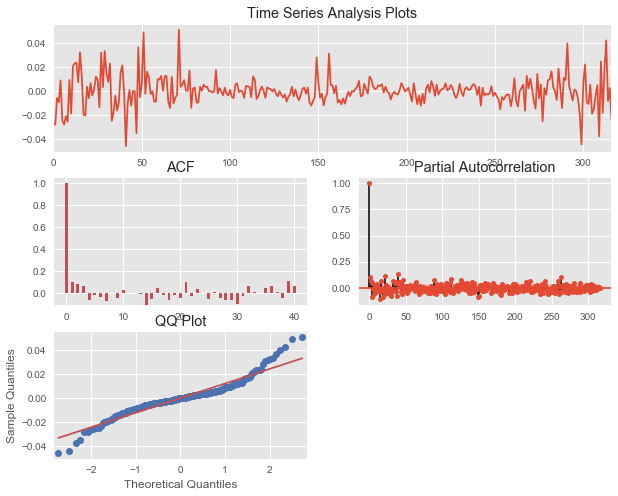

ADF Tests
ADF Statistic: -16.056234
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.45085947964659423, 'Average': 5.9292812410619904e-05, 'half-life': 0.77012833015992466, 'Current_Displacement': 0.023510601554081502}


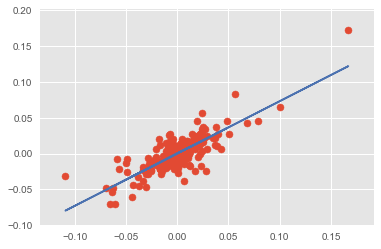

{'beta': array([ 0.73151833]), 'r2-score': 0.66466502296984387}
[5, 30]
['BEL', 'GER']
Regression time series


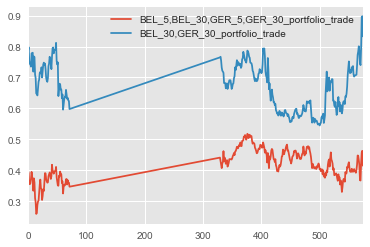

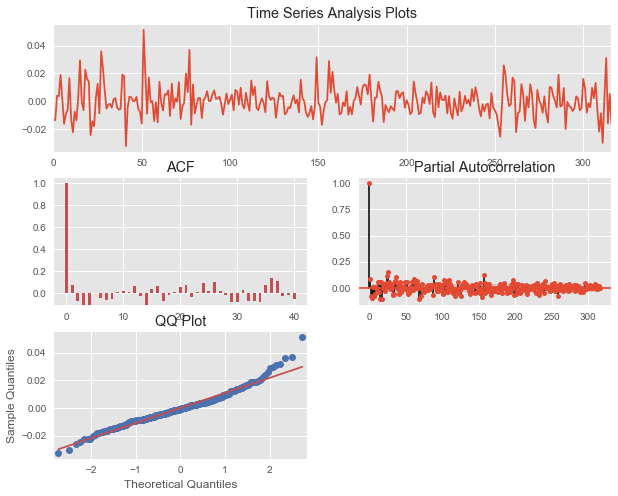

ADF Tests
ADF Statistic: -16.333123
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.45933931697561148, 'Average': 2.1716235130333217e-05, 'half-life': 0.75335463899446653, 'Current_Displacement': 0.016756210301156347}


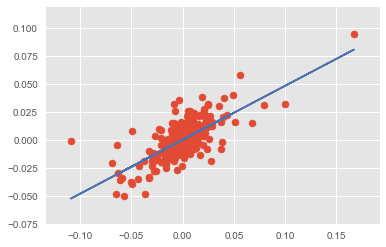

{'beta': array([ 0.48100778]), 'r2-score': 0.51381799885844481}
[10, 30]
['BEL', 'GER']
Regression time series


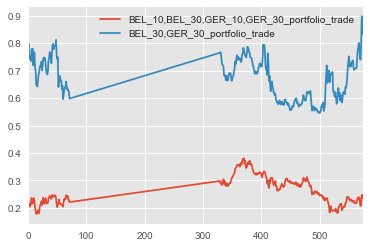

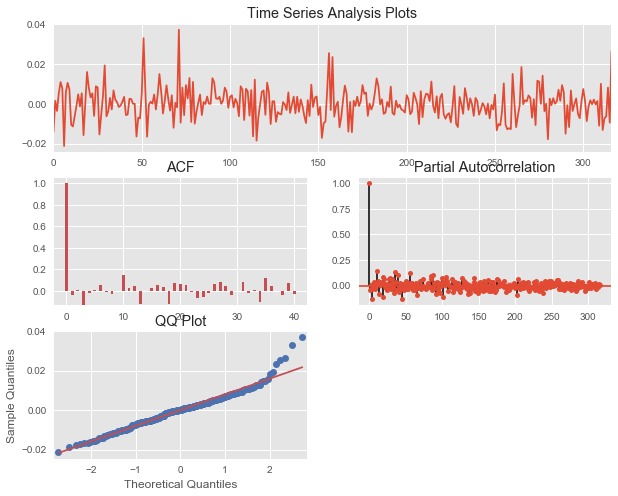

ADF Tests
ADF Statistic: -11.754138
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.451
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.51594545076981224, 'Average': 5.9887698646732654e-05, 'half-life': 0.66347797126456243, 'Current_Displacement': -0.026425712058626743}


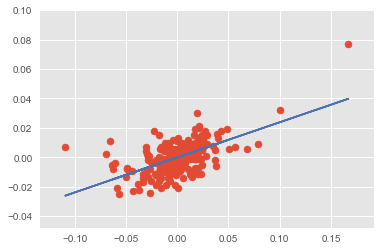

{'beta': array([ 0.23824]), 'r2-score': 0.32658101658918304}
[5, 15]
['BEL', 'GER']
Regression time series


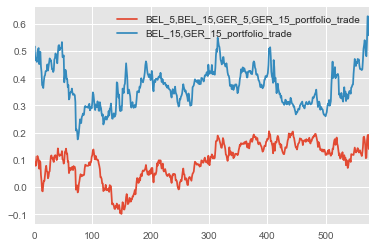

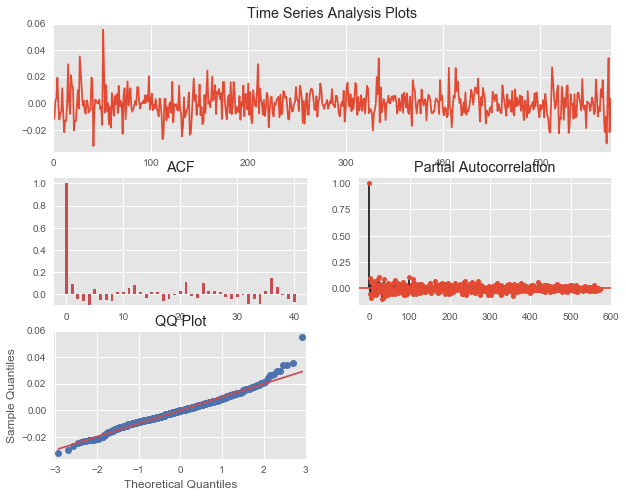

ADF Tests
ADF Statistic: -10.735460
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45119258440764876, 'Average': 1.6660513695372406e-05, 'half-life': 0.76637221635177577, 'Current_Displacement': 0.019774246192712064}


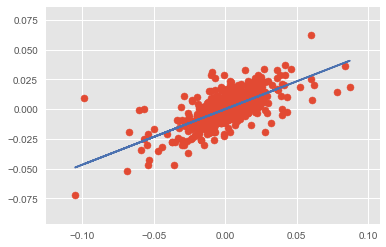

{'beta': array([ 0.46728137]), 'r2-score': 0.46527224245217091}
[2, 5]
['IRE', 'GER']
Regression time series


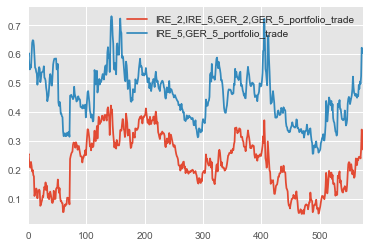

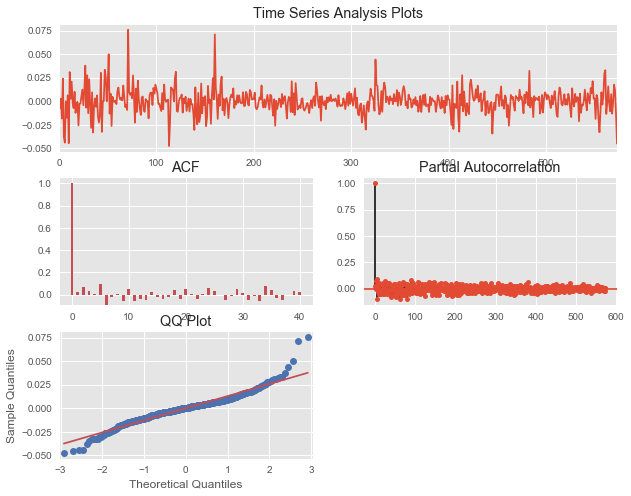

ADF Tests
ADF Statistic: -23.000199
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48091340953017403, 'Average': 2.4149498396691412e-05, 'half-life': 0.71272136938666752, 'Current_Displacement': 0.045024149498396622}


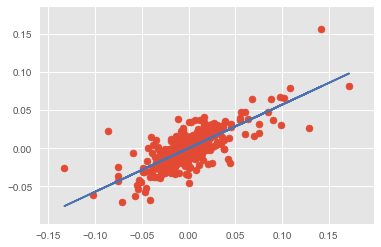

{'beta': array([ 0.5705336]), 'r2-score': 0.58397855214803995}
[2, 7]
['IRE', 'GER']
Regression time series


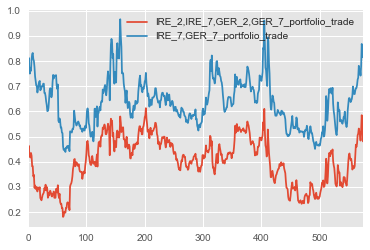

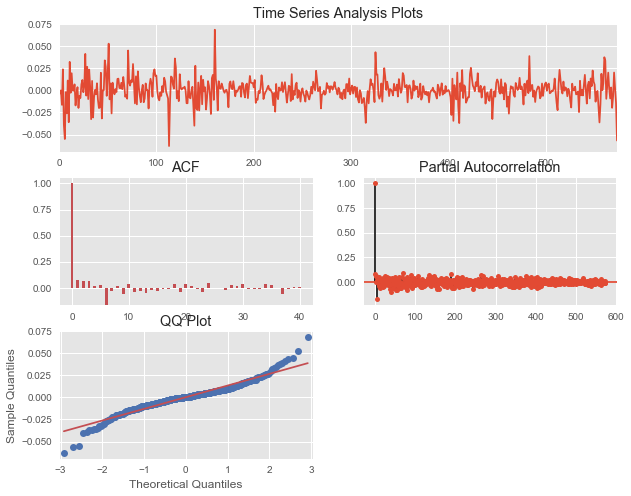

ADF Tests
ADF Statistic: -10.590229
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.452133965889427, 'Average': 1.8793416563440563e-05, 'half-life': 0.75281110120527661, 'Current_Displacement': 0.056731668483775963}


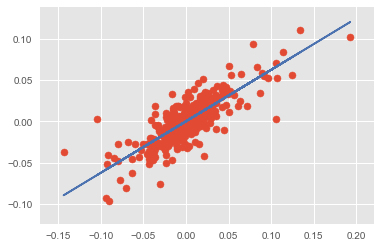

{'beta': array([ 0.62216532]), 'r2-score': 0.66102459729726903}
[2, 10]
['IRE', 'GER']
Regression time series


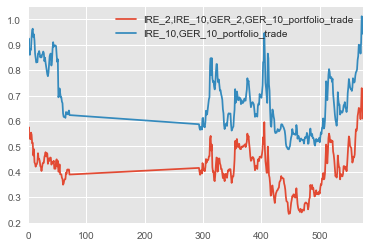

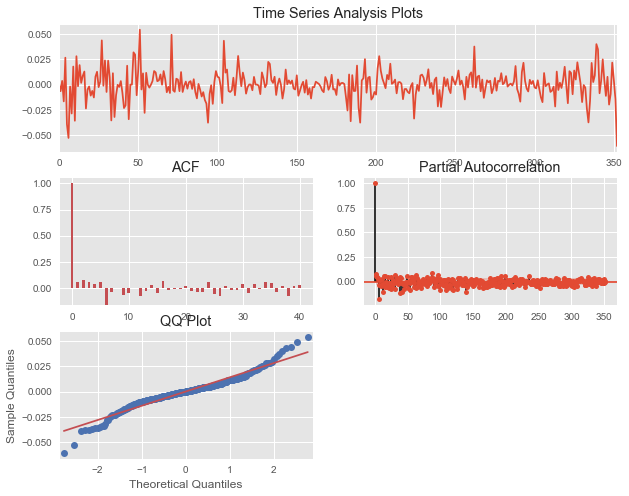

ADF Tests
ADF Statistic: -7.919786
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.45476833692116247, 'Average': 4.8695907809753111e-05, 'half-life': 0.74002764419067679, 'Current_Displacement': 0.0608492475935326}


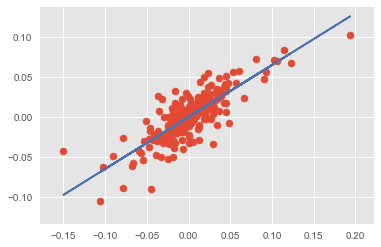

{'beta': array([ 0.64887663]), 'r2-score': 0.66925435173708214}
[5, 10]
['IRE', 'GER']
Regression time series


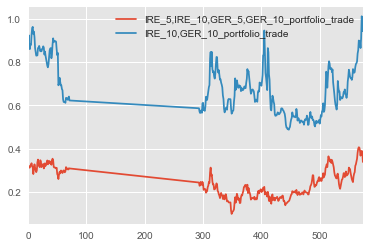

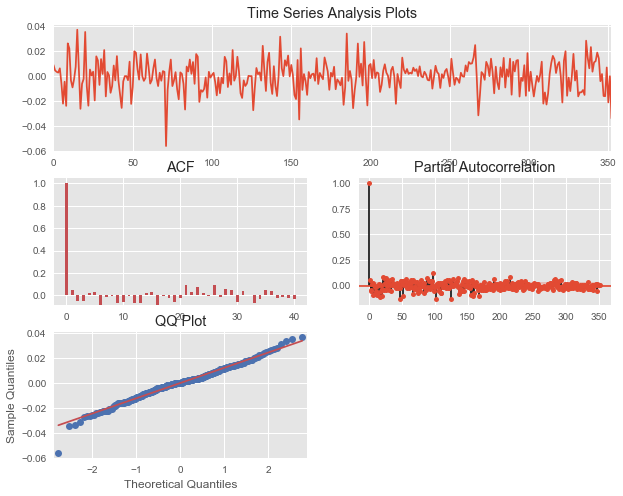

ADF Tests
ADF Statistic: -17.599054
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46947727301144837, 'Average': 3.2045081243829266e-05, 'half-life': 0.73020402244456639, 'Current_Displacement': 0.03395387281426588}


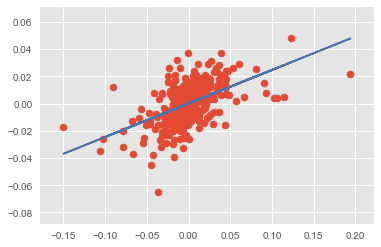

{'beta': array([ 0.24618161]), 'r2-score': 0.27827818839776275}
[5, 15]
['IRE', 'GER']
Regression time series


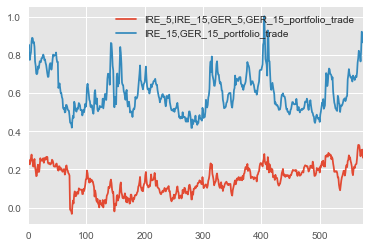

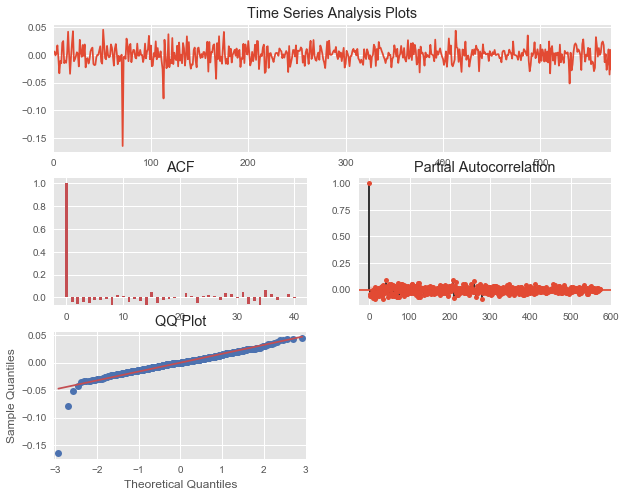

ADF Tests
ADF Statistic: -24.750610
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.51757053508090478, 'Average': 1.4252691964187491e-05, 'half-life': 0.66810560685596543, 'Current_Displacement': 0.026853669232126509}


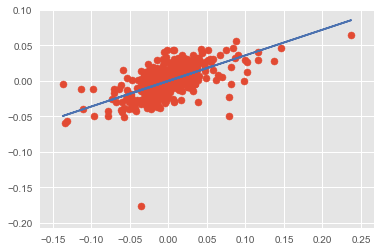

{'beta': array([ 0.36096627]), 'r2-score': 0.35566202480981901}
[7, 15]
['IRE', 'GER']
Regression time series


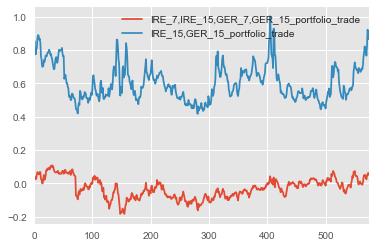

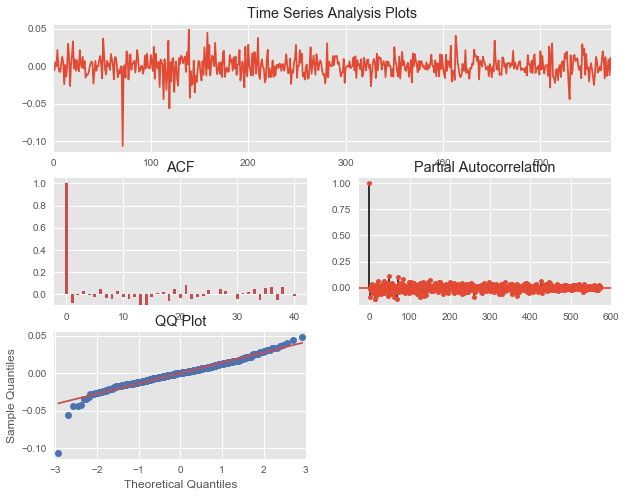

ADF Tests
ADF Statistic: -26.033615
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.54274241550953817, 'Average': 1.1005796138609279e-05, 'half-life': 0.63864683947253409, 'Current_Displacement': 0.0019435515026925505}


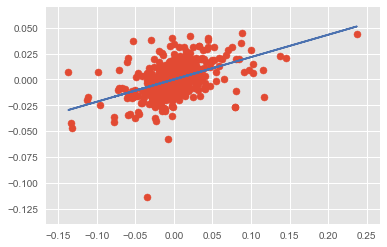

{'beta': array([ 0.21589177]), 'r2-score': 0.21384212620977694}
[2, 30]
['IRE', 'GER']
Regression time series


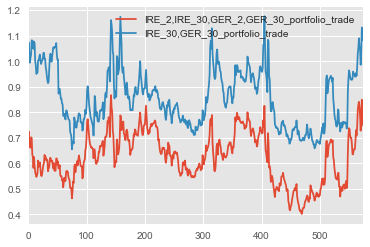

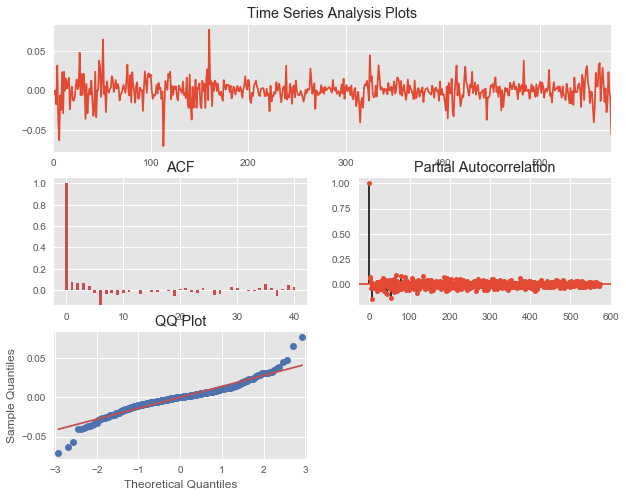

ADF Tests
ADF Statistic: -10.524242
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45581516467624816, 'Average': 2.3597435256197581e-05, 'half-life': 0.74850416996978075, 'Current_Displacement': 0.056118918175419343}


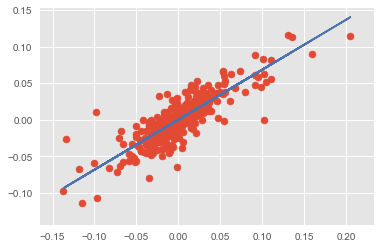

{'beta': array([ 0.68299084]), 'r2-score': 0.71516800890381971}
[5, 30]
['IRE', 'GER']
Regression time series


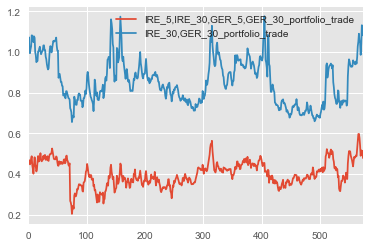

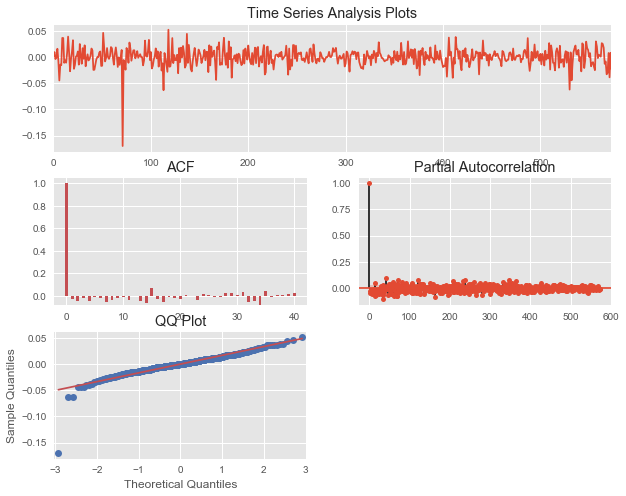

ADF Tests
ADF Statistic: -24.439148
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.5112439345723121, 'Average': 1.1146303528661098e-05, 'half-life': 0.67685231393103451, 'Current_Displacement': 0.022627758891668154}


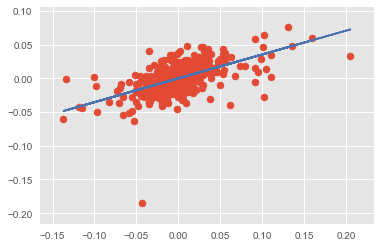

{'beta': array([ 0.35381107]), 'r2-score': 0.31671870024634352}
[10, 30]
['IRE', 'GER']
Regression time series


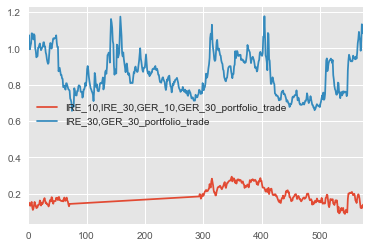

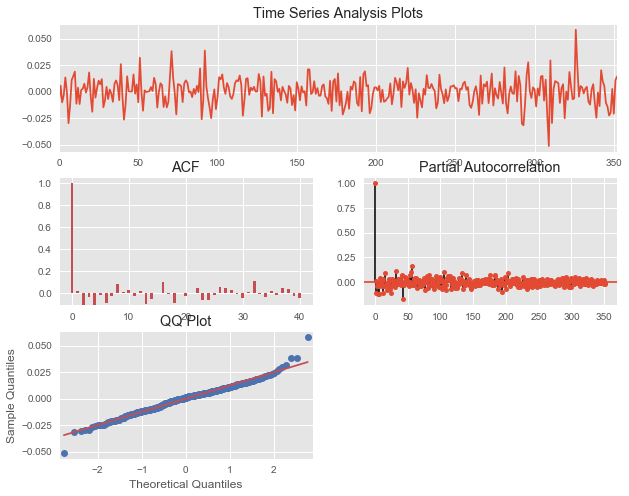

ADF Tests
ADF Statistic: -9.777307
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.49152670261235909, 'Average': -3.4010020316838694e-05, 'half-life': 0.70426991764160962, 'Current_Displacement': -0.014209628227474555}


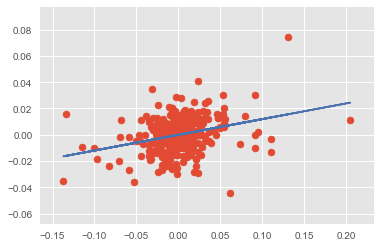

{'beta': array([ 0.11930338]), 'r2-score': 0.086021147890032457}
[5, 15]
['IRE', 'GER']
Regression time series


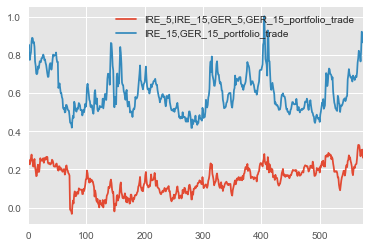

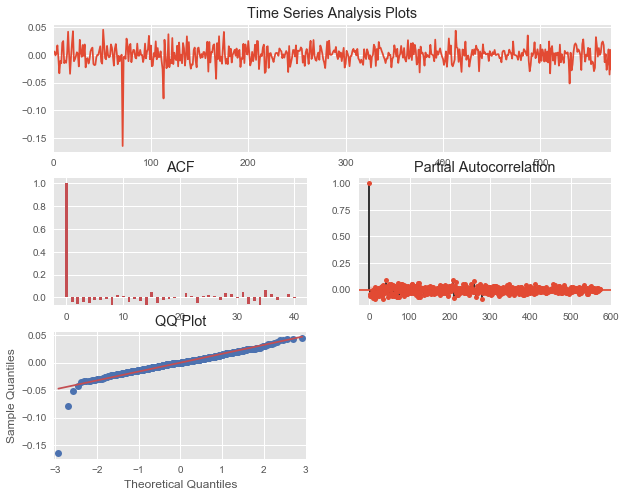

ADF Tests
ADF Statistic: -24.750610
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.51757053508090478, 'Average': 1.4252691964187491e-05, 'half-life': 0.66810560685596543, 'Current_Displacement': 0.026853669232126509}


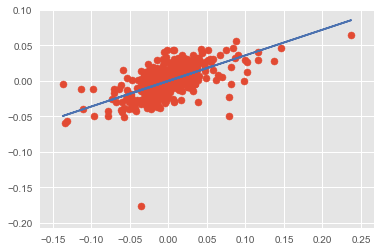

{'beta': array([ 0.36096627]), 'r2-score': 0.35566202480981901}
[2, 5]
['ESP', 'GER']
Regression time series


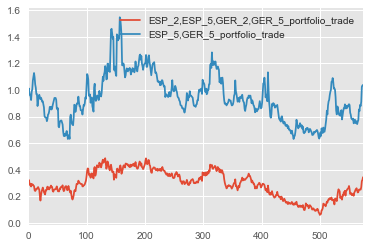

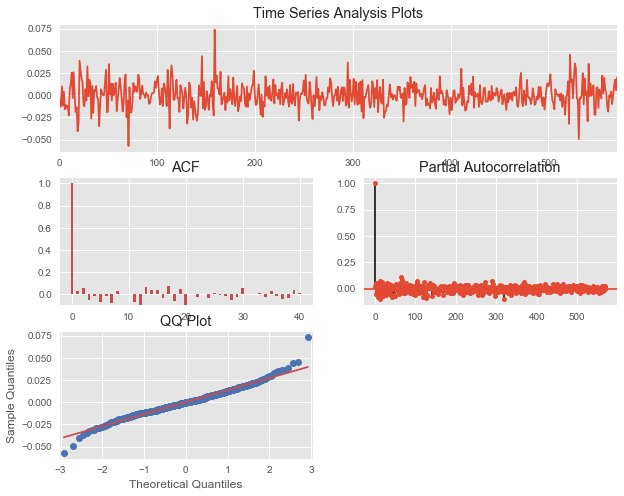

ADF Tests
ADF Statistic: -23.089024
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48415363255318444, 'Average': 2.443713510073469e-05, 'half-life': 0.71444487811842705, 'Current_Displacement': -0.019956725472299586}


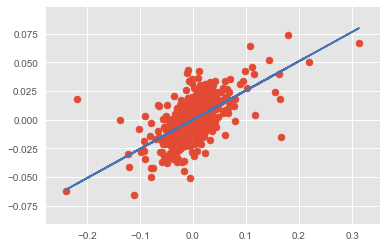

{'beta': array([ 0.25470935]), 'r2-score': 0.39373845478457836}
[2, 7]
['ESP', 'GER']
Regression time series


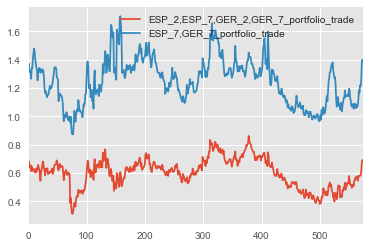

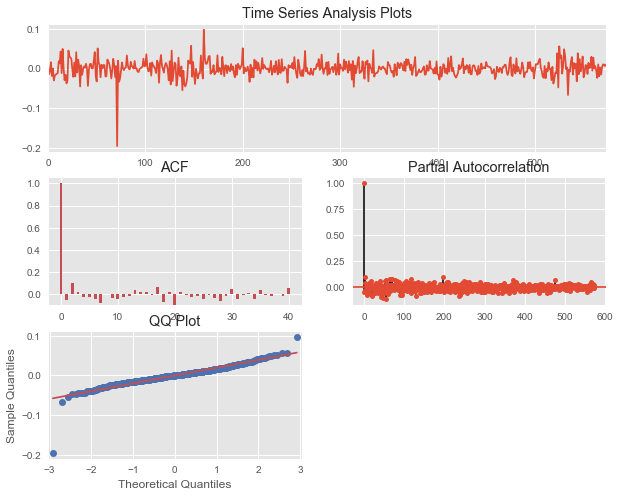

ADF Tests
ADF Statistic: -15.668093
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.52611018065669124, 'Average': 5.4262654112857729e-06, 'half-life': 0.65864883125320095, 'Current_Displacement': -0.0099946434841876805}


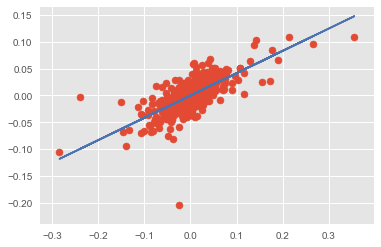

{'beta': array([ 0.41667248]), 'r2-score': 0.51835318241055095}
[2, 10]
['ESP', 'GER']
Regression time series


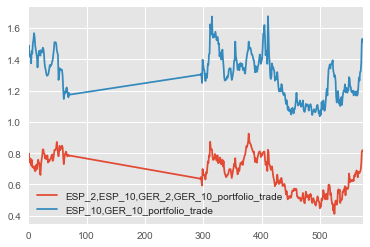

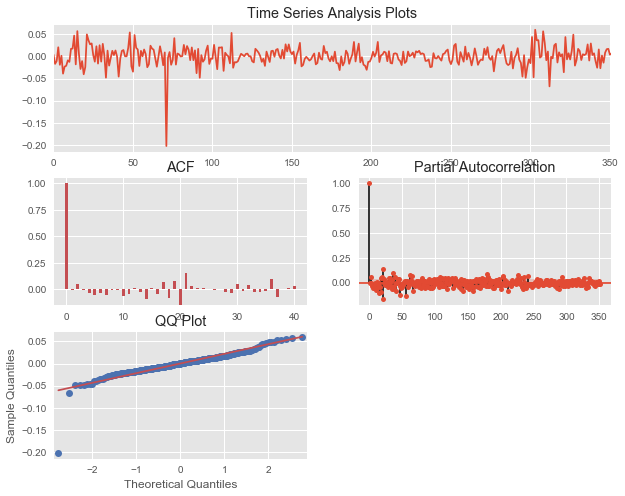

ADF Tests
ADF Statistic: -18.814277
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.50353995575949129, 'Average': 2.1625834677887161e-05, 'half-life': 0.68822584384248253, 'Current_Displacement': -0.0062057533375141439}


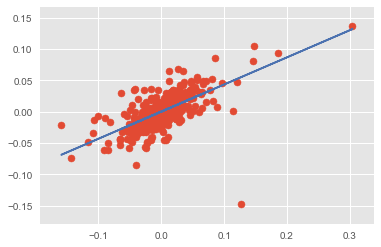

{'beta': array([ 0.43301996]), 'r2-score': 0.42865340128402829}
[5, 10]
['ESP', 'GER']
Regression time series


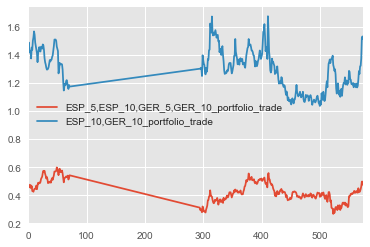

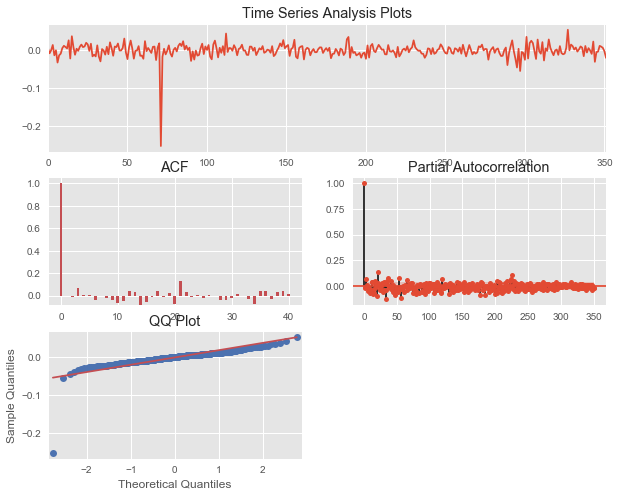

ADF Tests
ADF Statistic: -18.762366
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.50215854428527473, 'Average': -1.7970930866960115e-05, 'half-life': 0.68927011245035352, 'Current_Displacement': 0.019459104937428712}


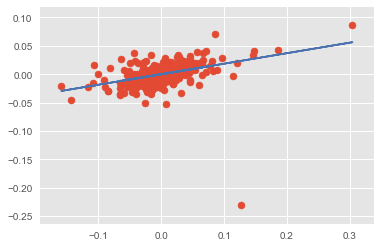

{'beta': array([ 0.18541706]), 'r2-score': 0.14915223434066027}
[5, 15]
['ESP', 'GER']
Regression time series


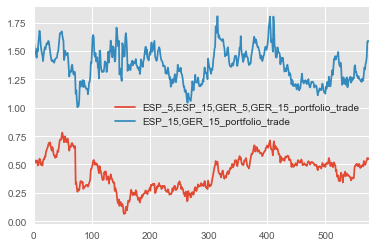

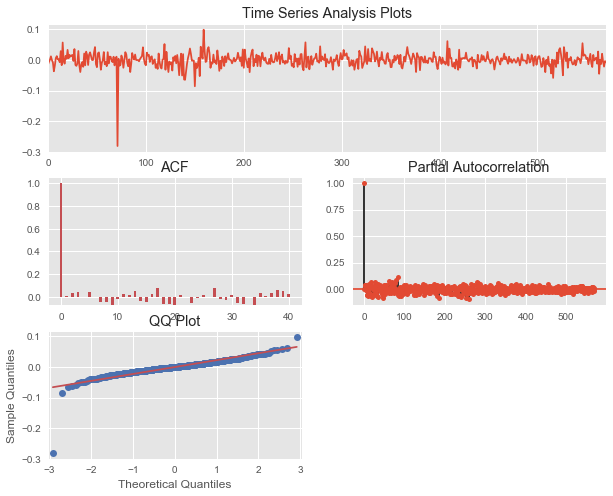

ADF Tests
ADF Statistic: -23.778509
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.49886073680375631, 'Average': -2.0120551604274166e-05, 'half-life': 0.69493345770971282, 'Current_Displacement': 0.0073842843032983678}


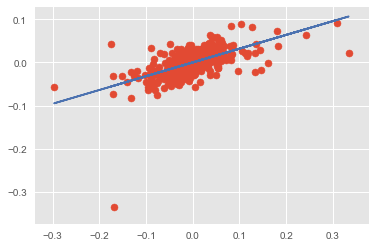

{'beta': array([ 0.31911903]), 'r2-score': 0.3647309600048867}
[7, 15]
['ESP', 'GER']
Regression time series


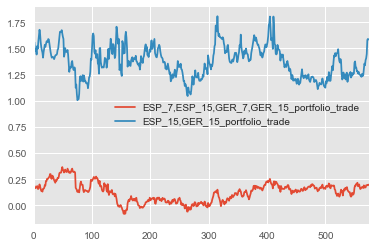

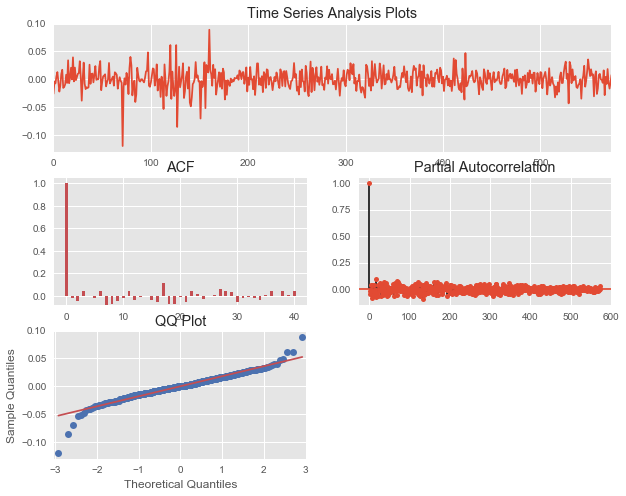

ADF Tests
ADF Statistic: -24.359338
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.50960915726488099, 'Average': 9.7081434002552264e-06, 'half-life': 0.68117692200442326, 'Current_Displacement': -0.0077316531150596977}


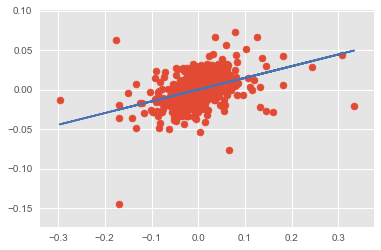

{'beta': array([ 0.14827225]), 'r2-score': 0.16185358650612069}
[2, 30]
['ESP', 'GER']
Regression time series


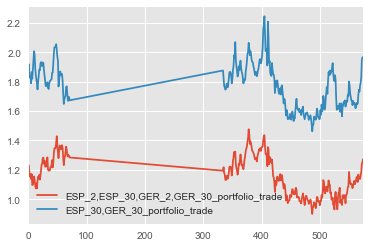

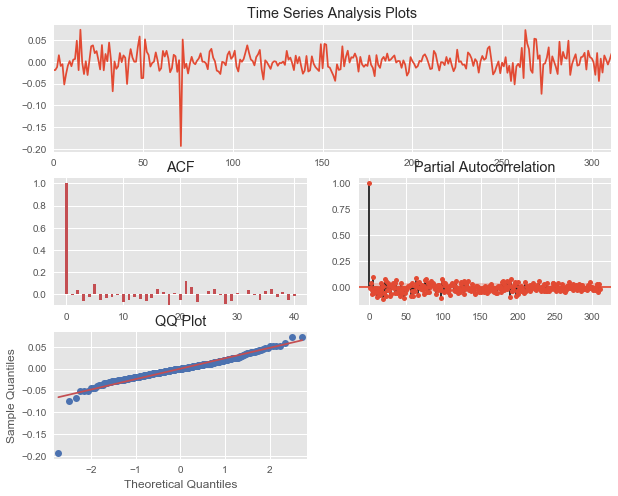

ADF Tests
ADF Statistic: -17.691954
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.50321960319912806, 'Average': 5.5927432457657326e-05, 'half-life': 0.68876524195614353, 'Current_Displacement': -0.018421054546495334}


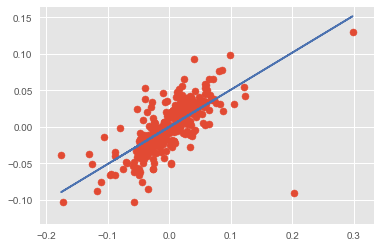

{'beta': array([ 0.50767267]), 'r2-score': 0.50740068286811457}
[5, 30]
['ESP', 'GER']
Regression time series


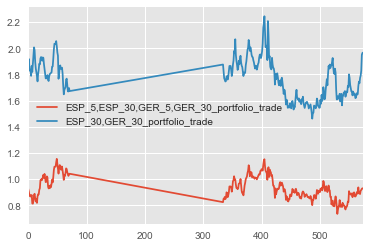

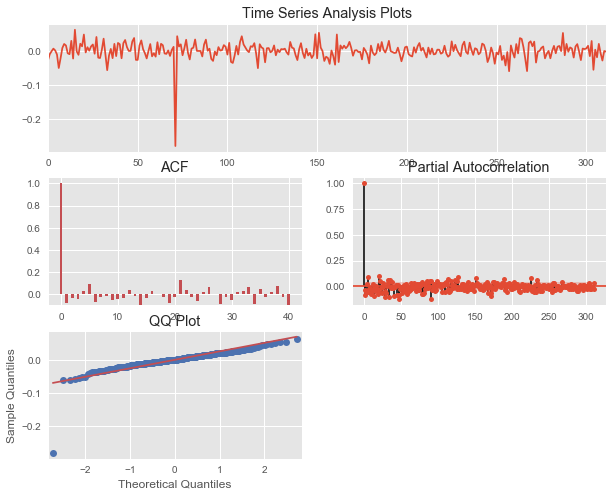

ADF Tests
ADF Statistic: -19.118964
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.54190649812802827, 'Average': 1.7015577863125669e-05, 'half-life': 0.64065894391837197, 'Current_Displacement': 0.0019396948637452212}


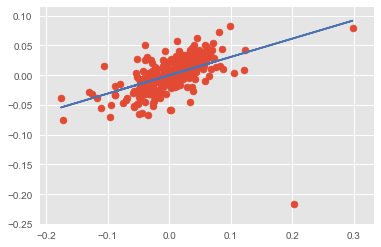

{'beta': array([ 0.30755976]), 'r2-score': 0.25107550800319089}
[10, 30]
['ESP', 'GER']
Regression time series


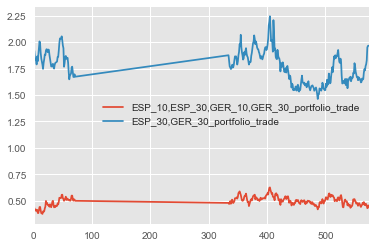

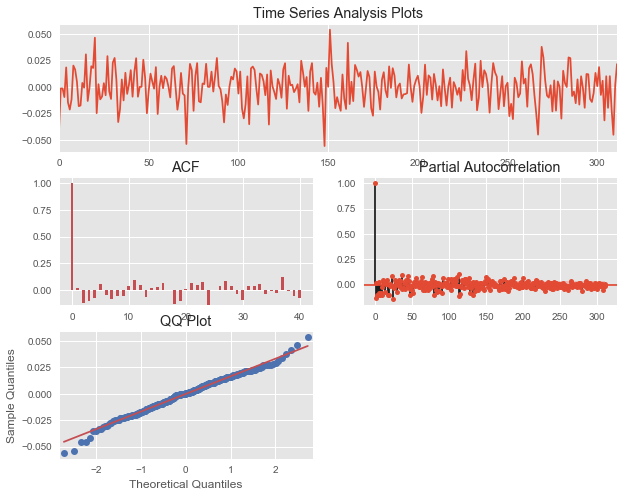

ADF Tests
ADF Statistic: -8.496174
p-value: 0.000000
Critical Values:
	5%: -2.871
	1%: -3.452
	10%: -2.572
Mean Reversion characteristics
{'R-squared': 0.49768866034361681, 'Average': 5.3794993238481777e-05, 'half-life': 0.70163105535941539, 'Current_Displacement': -0.021443506892919607}


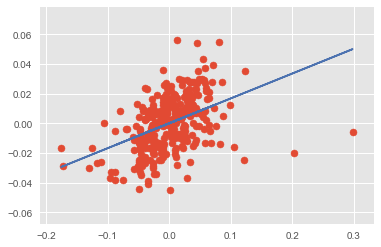

{'beta': array([ 0.16756604]), 'r2-score': 0.18880697722018014}
[5, 15]
['ESP', 'GER']
Regression time series


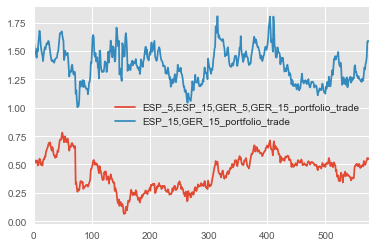

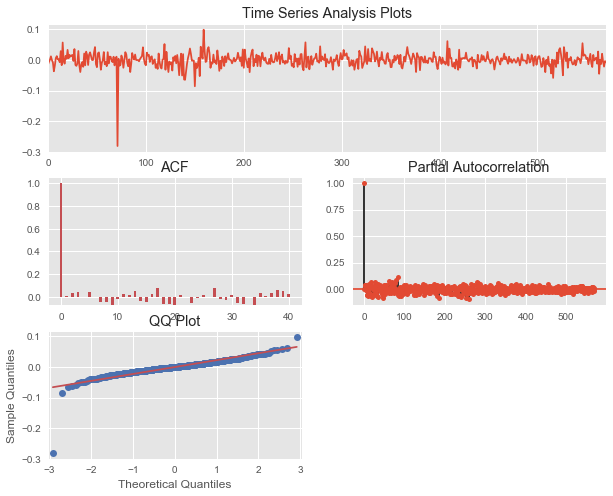

ADF Tests
ADF Statistic: -23.778509
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.49886073680375631, 'Average': -2.0120551604274166e-05, 'half-life': 0.69493345770971282, 'Current_Displacement': 0.0073842843032983678}


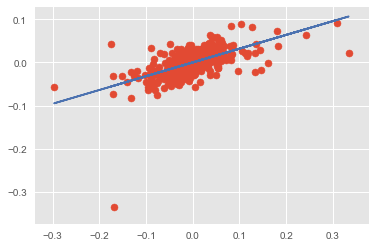

{'beta': array([ 0.31911903]), 'r2-score': 0.3647309600048867}
[2, 5]
['ITL', 'GER']
Regression time series


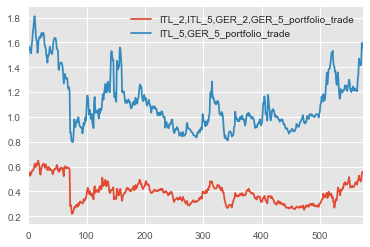

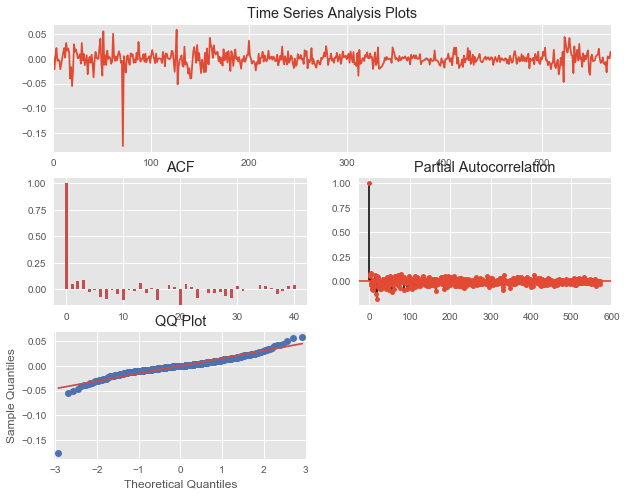

ADF Tests
ADF Statistic: -6.684586
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.47404313828091316, 'Average': 1.8595008342291539e-05, 'half-life': 0.73065394548199225, 'Current_Displacement': -0.012876323410196459}


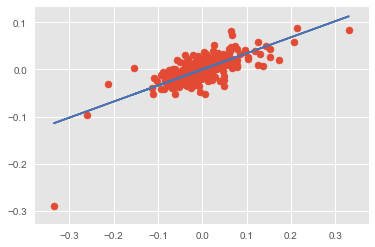

{'beta': array([ 0.3404662]), 'r2-score': 0.51479099390656158}
[2, 7]
['ITL', 'GER']
Regression time series


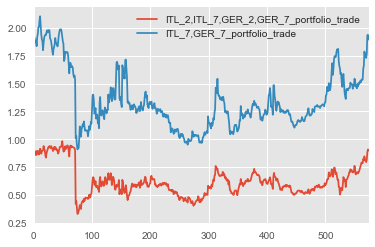

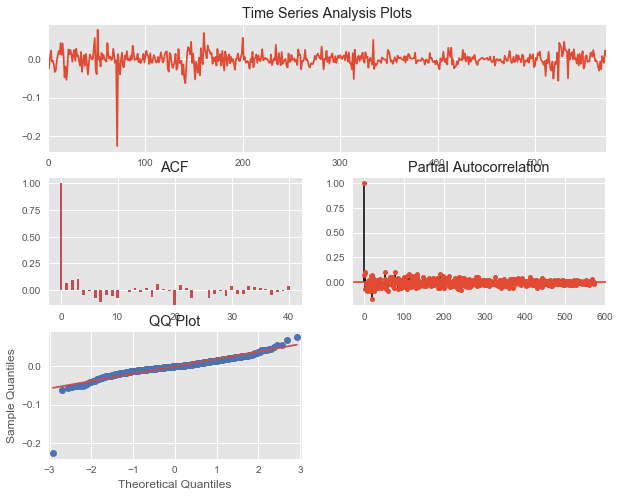

ADF Tests
ADF Statistic: -6.986651
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.46560569258822804, 'Average': 1.519050585974092e-05, 'half-life': 0.74407375830206246, 'Current_Displacement': -0.012281864417660982}


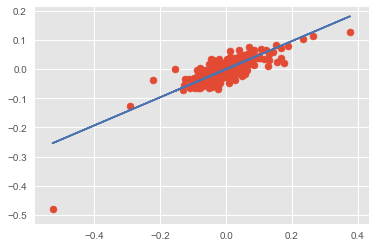

{'beta': array([ 0.48326321]), 'r2-score': 0.65243249533242365}
[2, 10]
['ITL', 'GER']
Regression time series


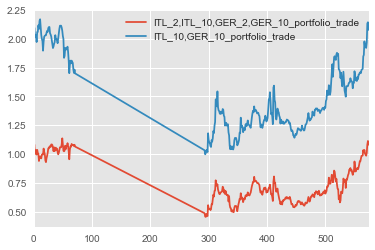

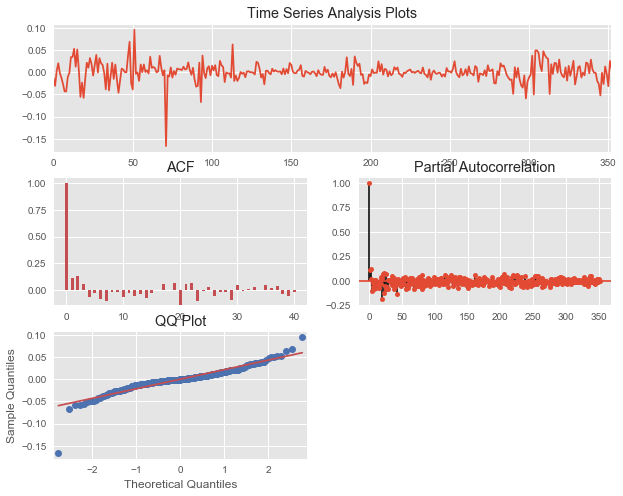

ADF Tests
ADF Statistic: -10.995109
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.44306052829529941, 'Average': 3.8522894225922525e-05, 'half-life': 0.7824903224523907, 'Current_Displacement': -0.00870856134196203}


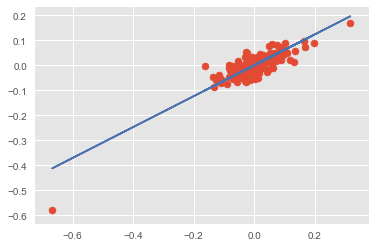

{'beta': array([ 0.61738006]), 'r2-score': 0.7448504968494537}
[5, 10]
['ITL', 'GER']
Regression time series


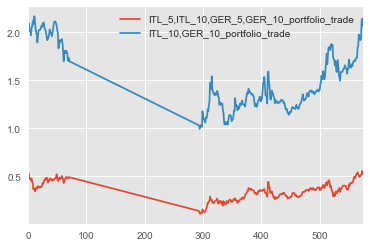

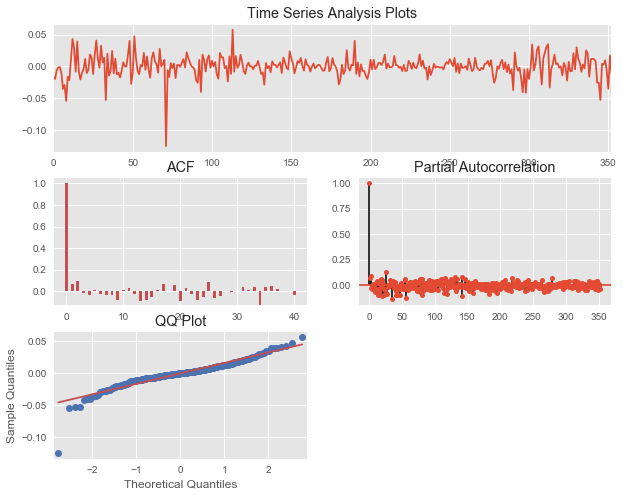

ADF Tests
ADF Statistic: -17.465831
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.4656939223094676, 'Average': -6.0327296909559444e-07, 'half-life': 0.74475212660036594, 'Current_Displacement': 0.011621344787982863}


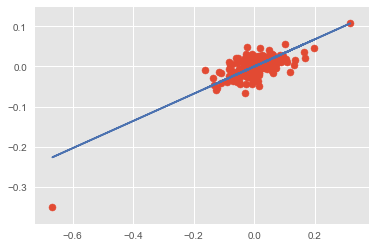

{'beta': array([ 0.33906139]), 'r2-score': 0.60194824909026678}
[5, 15]
['ITL', 'GER']
Regression time series


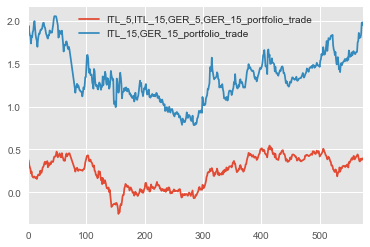

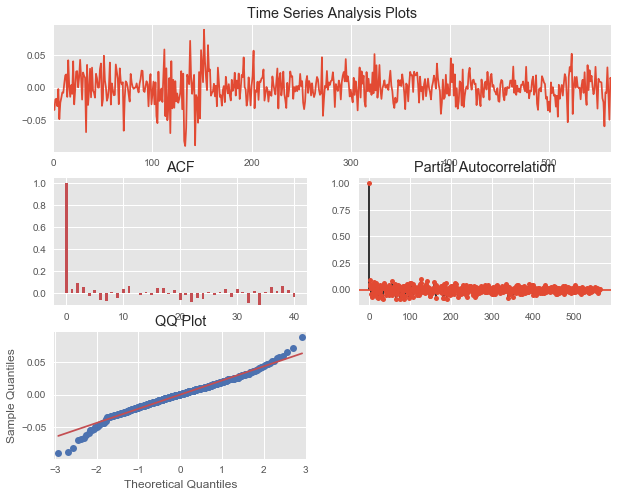

ADF Tests
ADF Statistic: -15.075458
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.48315031067965031, 'Average': 3.2176821918177525e-05, 'half-life': 0.71816026727748561, 'Current_Displacement': -0.0097600252779522605}


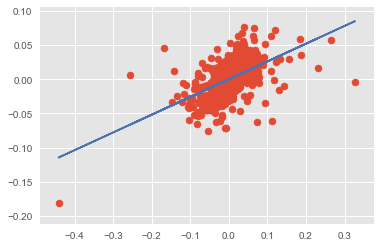

{'beta': array([ 0.25974007]), 'r2-score': 0.29170559153061493}
[7, 15]
['ITL', 'GER']
Regression time series


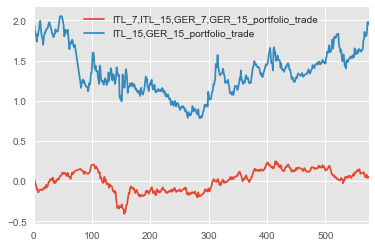

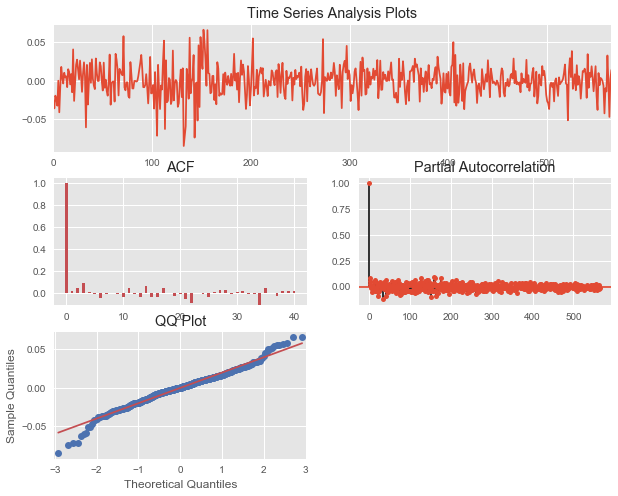

ADF Tests
ADF Statistic: -12.102592
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.48894952314313589, 'Average': 5.3451353063857623e-05, 'half-life': 0.70957528000342407, 'Current_Displacement': -0.014205296508022245}


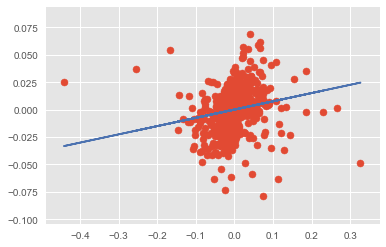

{'beta': array([ 0.0752916]), 'r2-score': 0.039804499647895897}
[2, 30]
['ITL', 'GER']
Regression time series


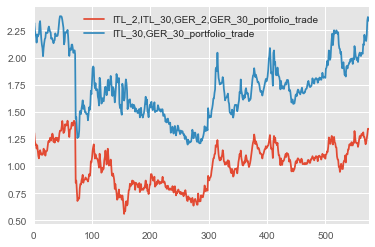

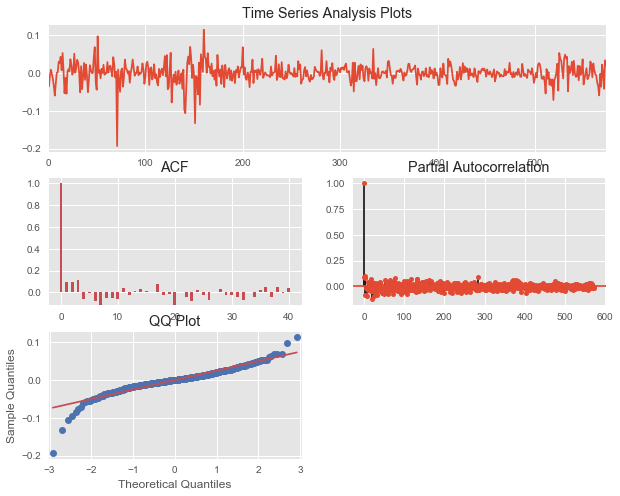

ADF Tests
ADF Statistic: -10.294821
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45466884038731503, 'Average': 5.3656385068068011e-05, 'half-life': 0.76262261899751904, 'Current_Displacement': -0.020366189571874523}


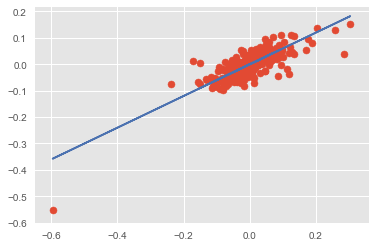

{'beta': array([ 0.6005837]), 'r2-score': 0.66362705605180261}
[5, 30]
['ITL', 'GER']
Regression time series


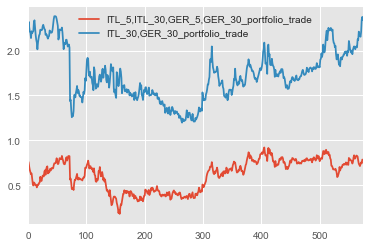

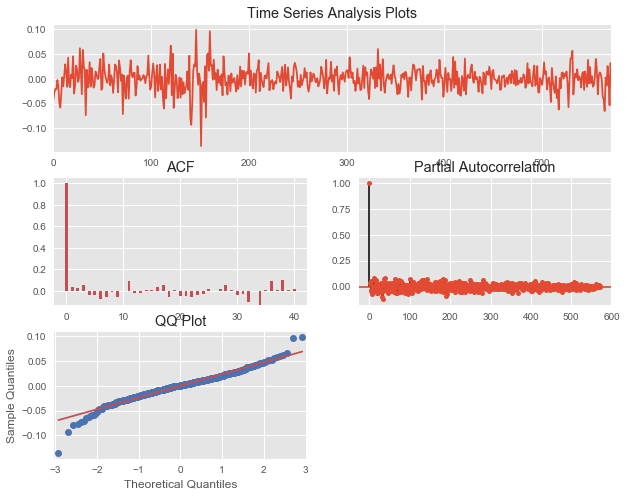

ADF Tests
ADF Statistic: -23.030880
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48245505326026927, 'Average': 3.6576907897936203e-05, 'half-life': 0.7201808275899324, 'Current_Displacement': -0.0087813264349814318}


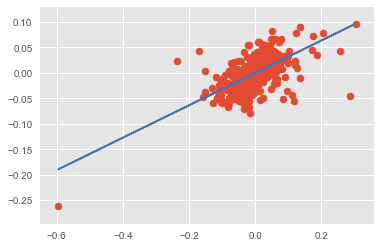

{'beta': array([ 0.31817363]), 'r2-score': 0.38115219256485233}
[10, 30]
['ITL', 'GER']
Regression time series


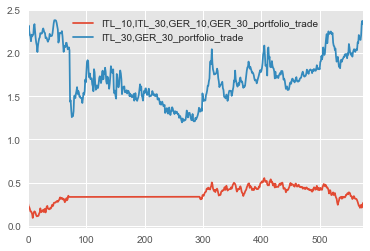

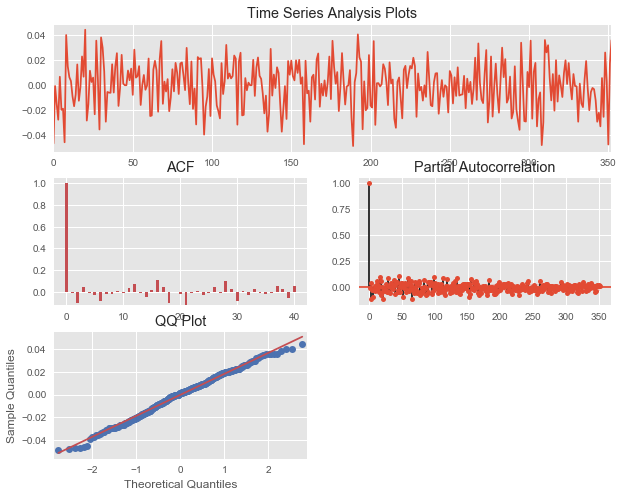

ADF Tests
ADF Statistic: -14.738168
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.50631140122913076, 'Average': -0.00013007184291090855, 'half-life': 0.68686370033733291, 'Current_Displacement': -0.035996575986566498}


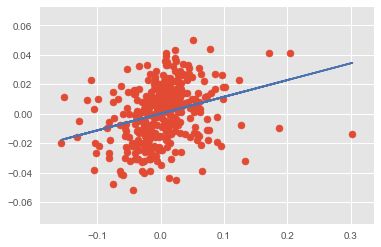

{'beta': array([ 0.11372071]), 'r2-score': 0.086372778320981447}
[5, 15]
['ITL', 'GER']
Regression time series


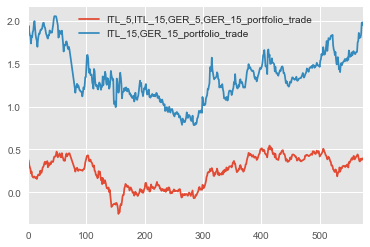

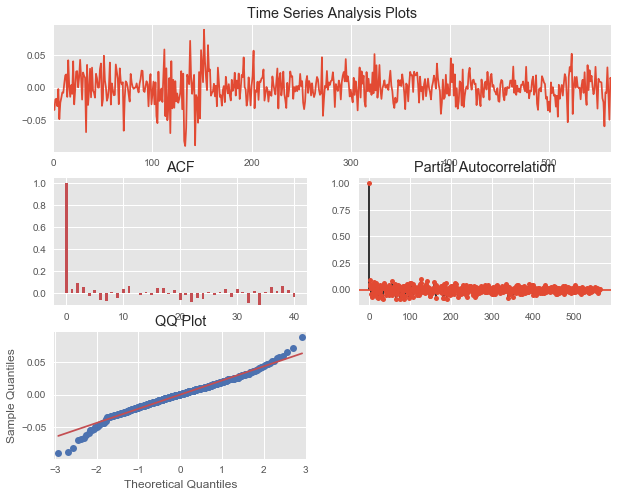

ADF Tests
ADF Statistic: -15.075458
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.48315031067965031, 'Average': 3.2176821918177525e-05, 'half-life': 0.71816026727748561, 'Current_Displacement': -0.0097600252779522605}


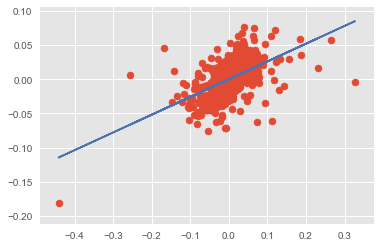

{'beta': array([ 0.25974007]), 'r2-score': 0.29170559153061493}
[2, 5]
['PTE', 'GER']
Regression time series


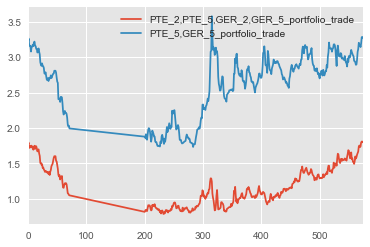

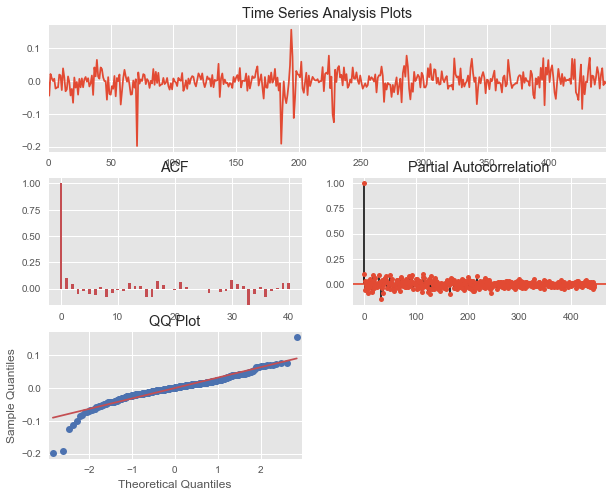

ADF Tests
ADF Statistic: -19.068104
p-value: 0.000000
Critical Values:
	5%: -2.868
	1%: -3.445
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.45077600319781674, 'Average': -1.8849517807189984e-06, 'half-life': 0.76882567556842341, 'Current_Displacement': 0.0073704161527486612}


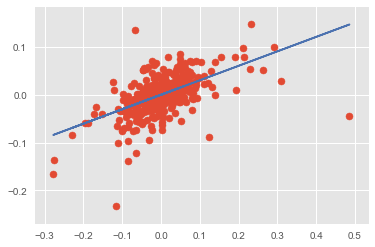

{'beta': array([ 0.30230824]), 'r2-score': 0.30155545367915126}
[2, 7]
['PTE', 'GER']
Regression time series


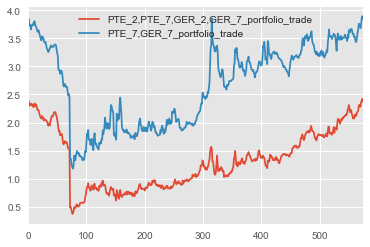

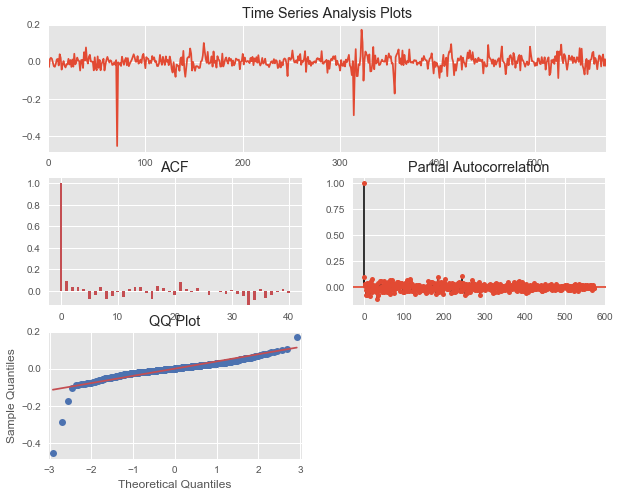

ADF Tests
ADF Statistic: -21.794648
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45411437512991215, 'Average': -1.8167962845686902e-05, 'half-life': 0.76294321403575582, 'Current_Displacement': 0.022589071436528201}


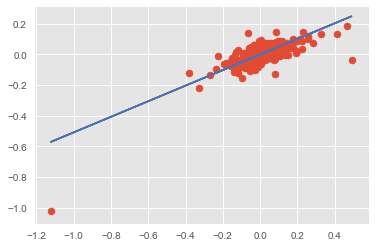

{'beta': array([ 0.50818251]), 'r2-score': 0.58618760147989291}
[2, 10]
['PTE', 'GER']
Regression time series


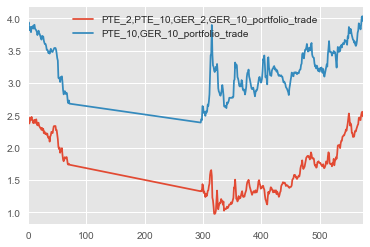

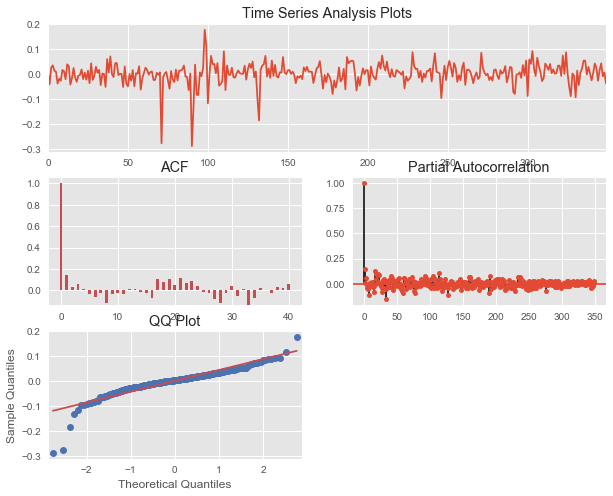

ADF Tests
ADF Statistic: -16.095293
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.42744798041811605, 'Average': -8.1889727830241031e-06, 'half-life': 0.80975103528461867, 'Current_Displacement': 0.038431681399166806}


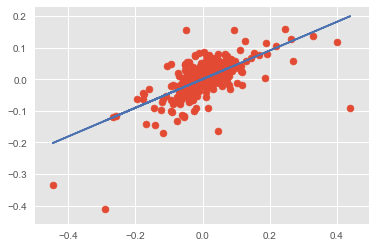

{'beta': array([ 0.45222402]), 'r2-score': 0.41600861675242995}
[5, 10]
['PTE', 'GER']
Regression time series


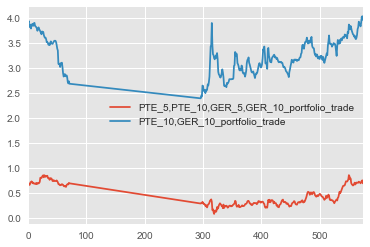

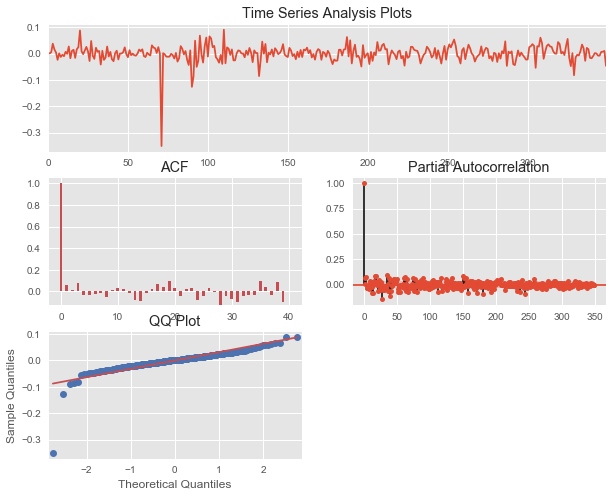

ADF Tests
ADF Statistic: -17.478437
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46819577225591058, 'Average': 8.9796160301135358e-06, 'half-life': 0.73774895469125745, 'Current_Displacement': 0.046849710113953634}


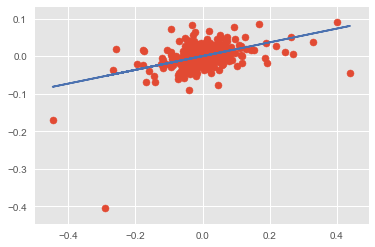

{'beta': array([ 0.18276763]), 'r2-score': 0.17973990273208995}
[5, 15]
['PTE', 'GER']
Regression time series


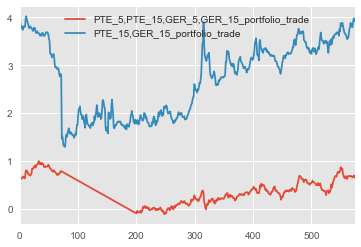

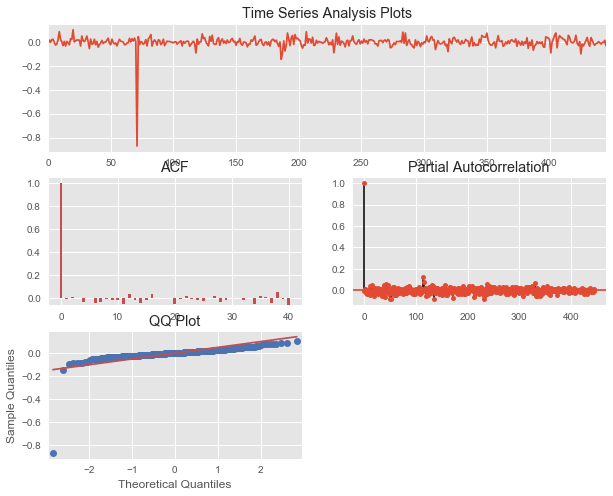

ADF Tests
ADF Statistic: -21.105008
p-value: 0.000000
Critical Values:
	5%: -2.868
	1%: -3.445
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.50136273919683627, 'Average': -0.00037659083971808429, 'half-life': 0.69102020319900015, 'Current_Displacement': 0.030888067299338989}


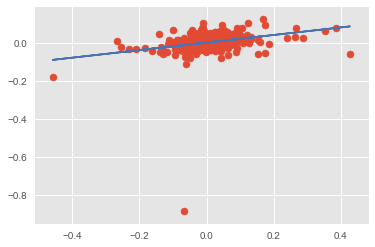

{'beta': array([ 0.19880263]), 'r2-score': 0.081723971626035619}
[7, 15]
['PTE', 'GER']
Regression time series


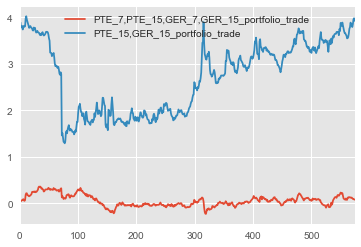

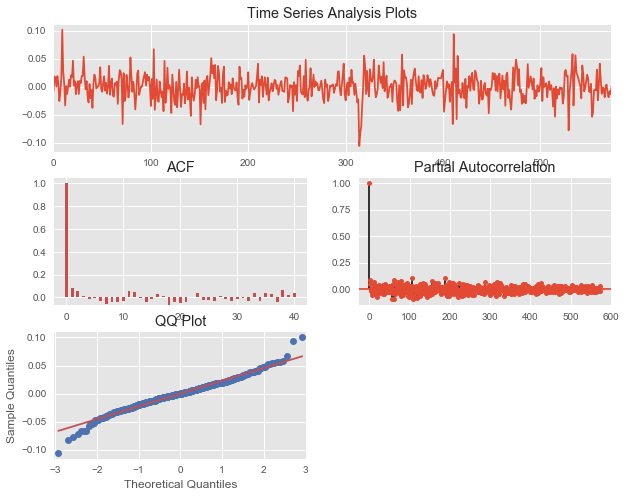

ADF Tests
ADF Statistic: -15.295555
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.45744332195439463, 'Average': 6.313279759349882e-05, 'half-life': 0.7577285626777619, 'Current_Displacement': 0.00076031824306141784}


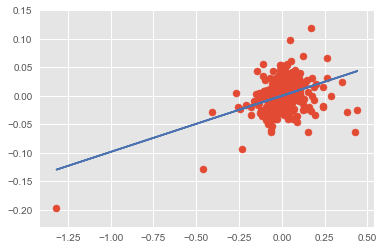

{'beta': array([ 0.09820027]), 'r2-score': 0.15056549345284553}
[2, 30]
['PTE', 'GER']
Regression time series


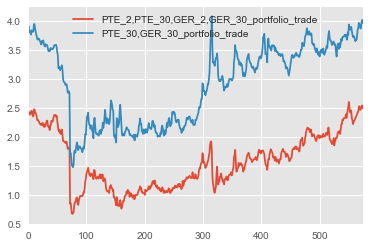

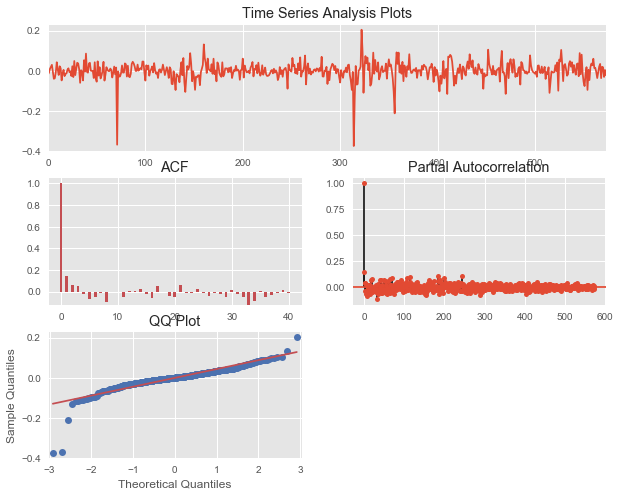

ADF Tests
ADF Statistic: -20.698740
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.42867883212444435, 'Average': 3.2558243080353368e-05, 'half-life': 0.8084009422023769, 'Current_Displacement': 0.021848381608740954}


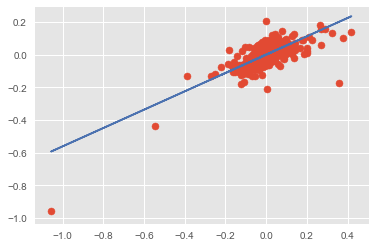

{'beta': array([ 0.56123417]), 'r2-score': 0.57319216739370782}
[5, 30]
['PTE', 'GER']
Regression time series


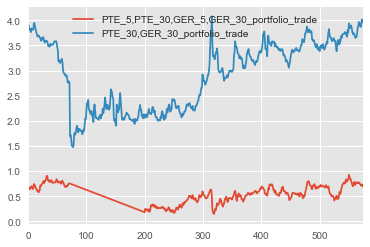

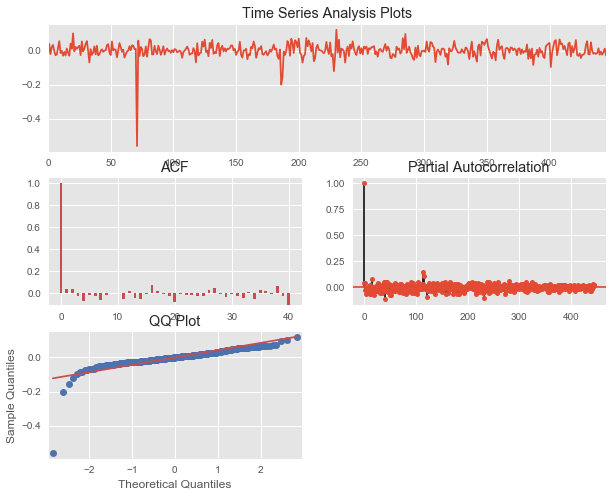

ADF Tests
ADF Statistic: -20.195011
p-value: 0.000000
Critical Values:
	5%: -2.868
	1%: -3.445
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.47933712215168023, 'Average': -0.0002028336695138553, 'half-life': 0.72307666296778039, 'Current_Displacement': 0.029250403269011432}


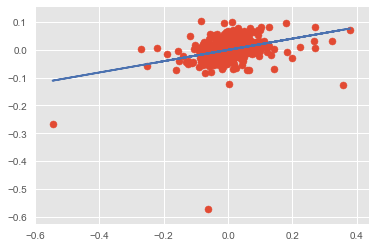

{'beta': array([ 0.20282237]), 'r2-score': 0.10853355377404239}
[10, 30]
['PTE', 'GER']
Regression time series


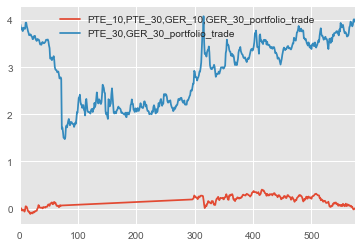

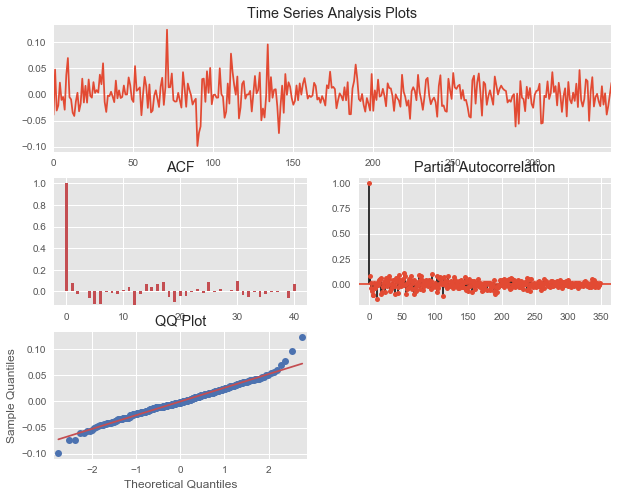

ADF Tests
ADF Statistic: -9.462130
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.450
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.46193565901878686, 'Average': 8.5559808786827725e-05, 'half-life': 0.75197905064496073, 'Current_Displacement': -0.022361689584073183}


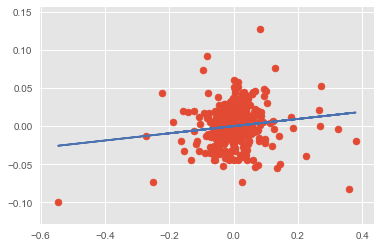

{'beta': array([ 0.04706249]), 'r2-score': 0.019529910241471882}
[5, 15]
['PTE', 'GER']
Regression time series


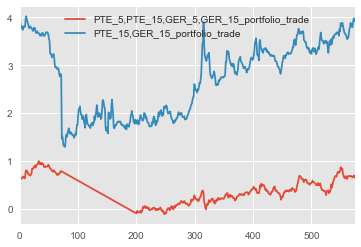

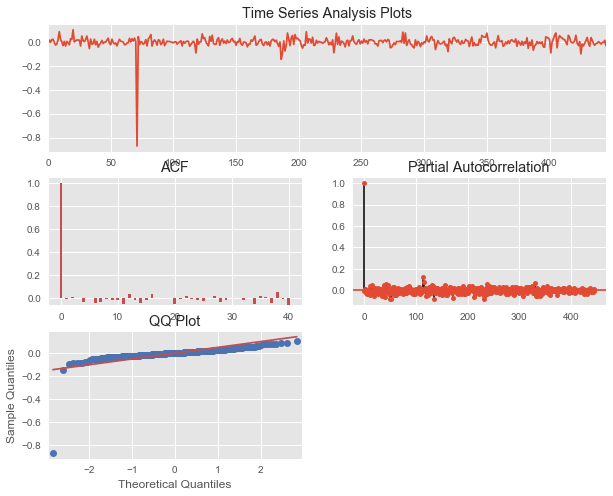

ADF Tests
ADF Statistic: -21.105008
p-value: 0.000000
Critical Values:
	5%: -2.868
	1%: -3.445
	10%: -2.570
Mean Reversion characteristics
{'R-squared': 0.50136273919683627, 'Average': -0.00037659083971808429, 'half-life': 0.69102020319900015, 'Current_Displacement': 0.030888067299338989}


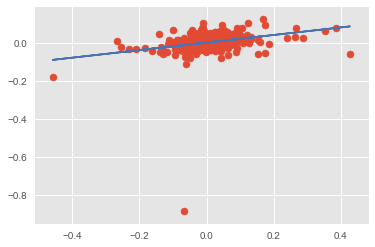

{'beta': array([ 0.19880263]), 'r2-score': 0.081723971626035619}
[2, 5]
['UKT', 'GER']
Regression time series


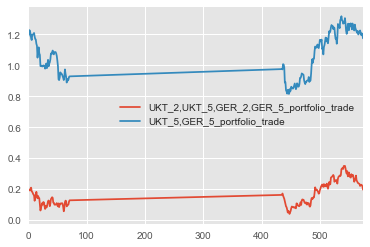

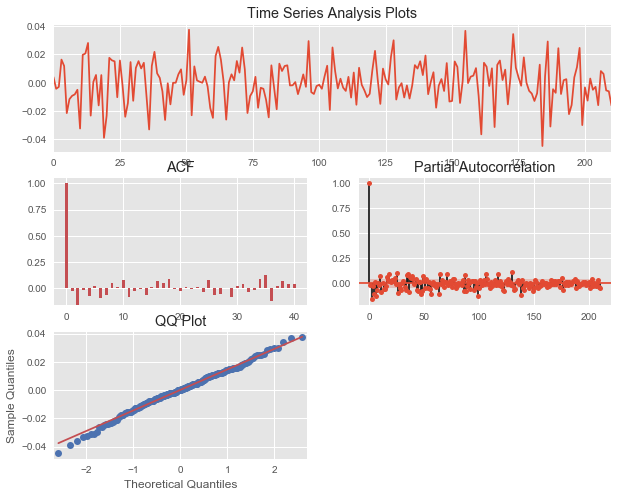

ADF Tests
ADF Statistic: -12.060322
p-value: 0.000000
Critical Values:
	5%: -2.875
	1%: -3.462
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.50959078478519737, 'Average': 4.1032146755462704e-05, 'half-life': 0.67826625084272729, 'Current_Displacement': 0.016069854362338633}


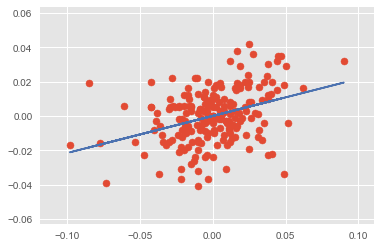

{'beta': array([ 0.21613816]), 'r2-score': 0.12864174929896977}
[2, 7]
['UKT', 'GER']
Regression time series


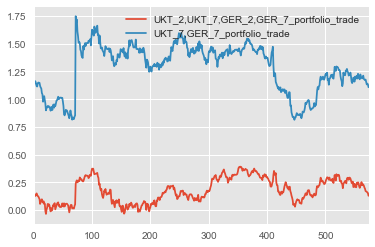

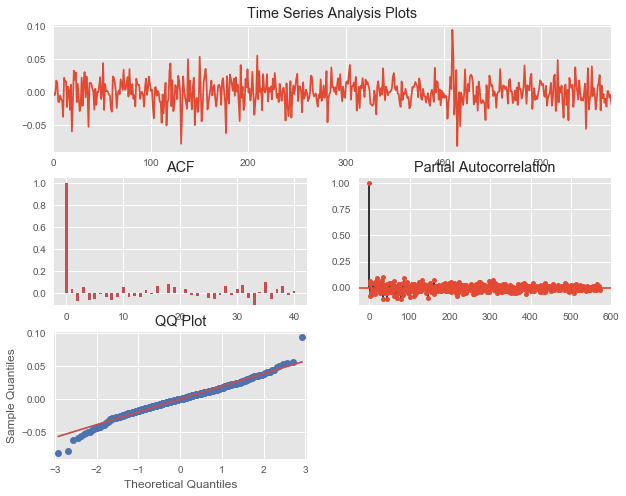

ADF Tests
ADF Statistic: -12.551831
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48212823764372292, 'Average': 6.9755537507568526e-06, 'half-life': 0.71823508175971573, 'Current_Displacement': 0.018737942868568988}


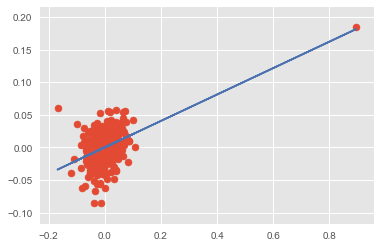

{'beta': array([ 0.2026551]), 'r2-score': 0.20712033608178648}
[2, 10]
['UKT', 'GER']
Regression time series


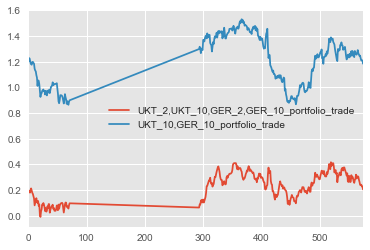

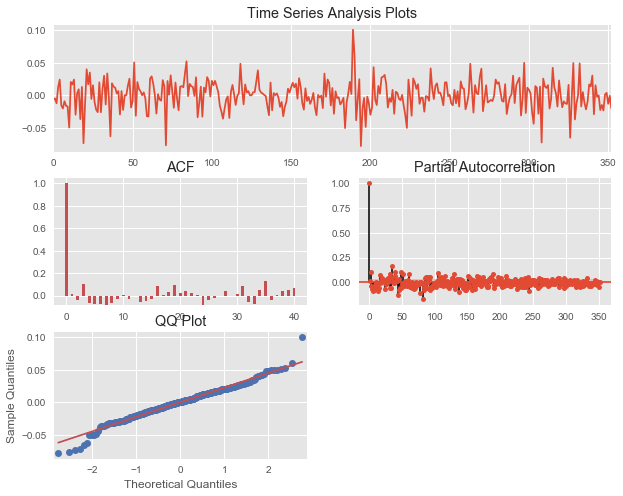

ADF Tests
ADF Statistic: -9.840272
p-value: 0.000000
Critical Values:
	5%: -2.870
	1%: -3.449
	10%: -2.571
Mean Reversion characteristics
{'R-squared': 0.49320097784900807, 'Average': 3.0712971074022327e-05, 'half-life': 0.70197719021633309, 'Current_Displacement': 0.020281043626744936}


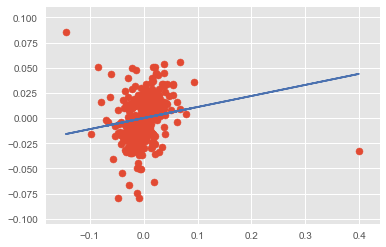

{'beta': array([ 0.10998677]), 'r2-score': 0.027192179653469983}
[5, 10]
['UKT', 'GER']
Regression time series


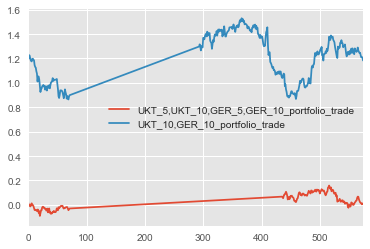

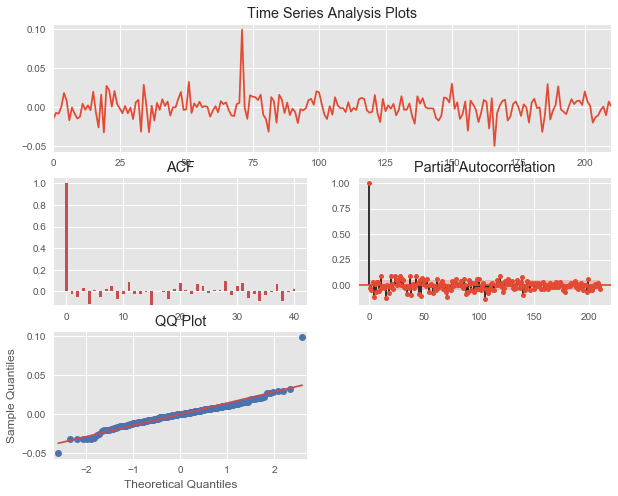

ADF Tests
ADF Statistic: -14.860369
p-value: 0.000000
Critical Values:
	5%: -2.875
	1%: -3.462
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.51495996316352999, 'Average': 0.00013112204529534363, 'half-life': 0.67452181369942044, 'Current_Displacement': -0.00093318218365727739}


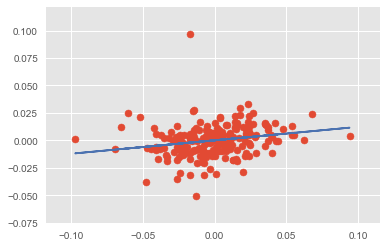

{'beta': array([ 0.12257217]), 'r2-score': 0.046925474853651949}
[5, 15]
['UKT', 'GER']
Regression time series


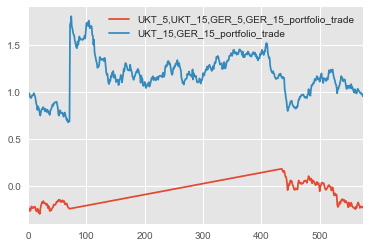

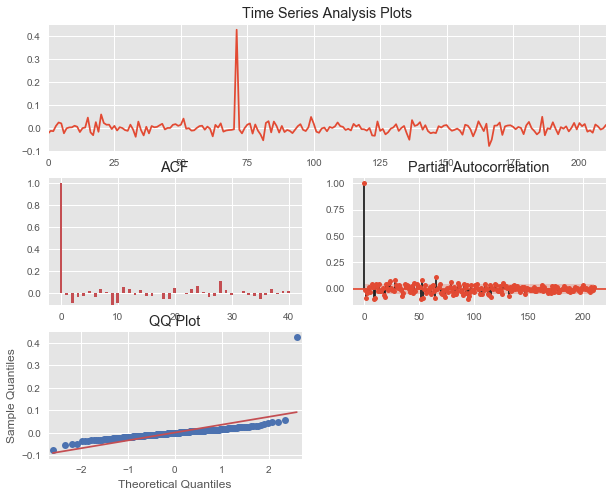

ADF Tests
ADF Statistic: -14.659780
p-value: 0.000000
Critical Values:
	5%: -2.875
	1%: -3.462
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.50816859529908753, 'Average': 0.00087613547066474741, 'half-life': 0.68263580019825276, 'Current_Displacement': -0.012316822940813642}


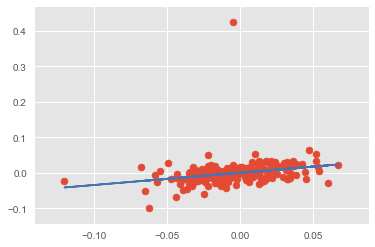

{'beta': array([ 0.34619723]), 'r2-score': 0.066129132594222373}
[7, 15]
['UKT', 'GER']
Regression time series


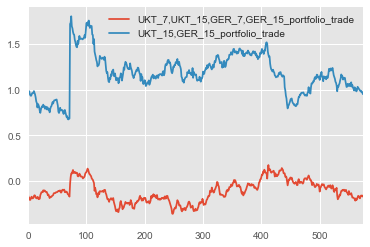

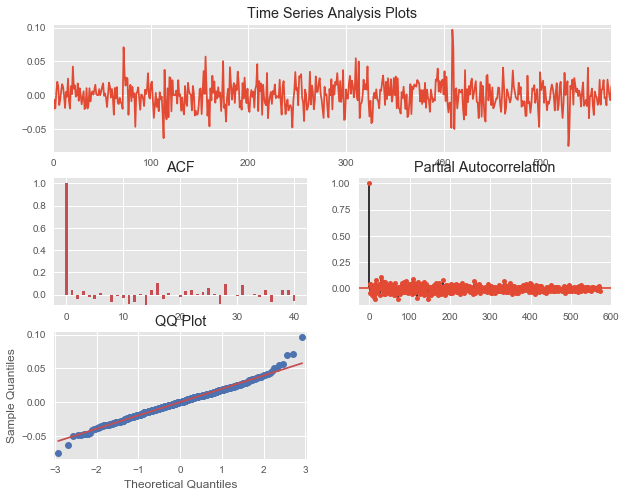

ADF Tests
ADF Statistic: -22.945253
p-value: 0.000000
Critical Values:
	5%: -2.867
	1%: -3.442
	10%: -2.569
Mean Reversion characteristics
{'R-squared': 0.48015686578819716, 'Average': 4.1240297615690608e-05, 'half-life': 0.72235141602745712, 'Current_Displacement': -0.013271255475158332}


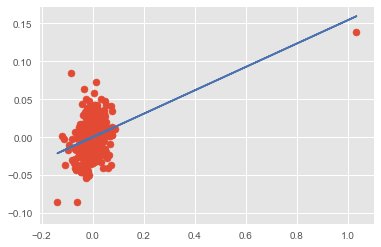

{'beta': array([ 0.15416638]), 'r2-score': 0.14653382143007643}
[2, 30]
['UKT', 'GER']
Regression time series


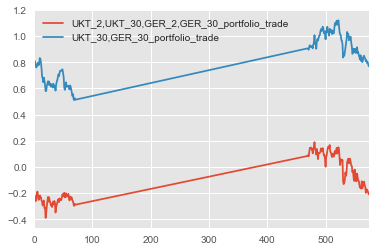

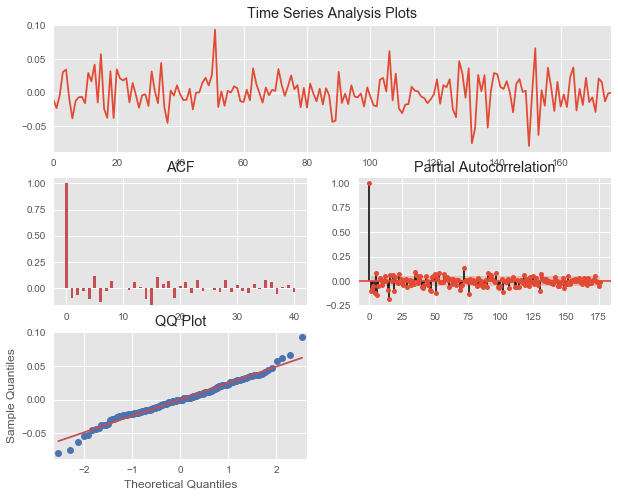

ADF Tests
ADF Statistic: -14.601265
p-value: 0.000000
Critical Values:
	5%: -2.878
	1%: -3.468
	10%: -2.576
Mean Reversion characteristics
{'R-squared': 0.55061627427612736, 'Average': 0.00014107502557427344, 'half-life': 0.62971928631617491, 'Current_Displacement': 0.00037701642931777207}


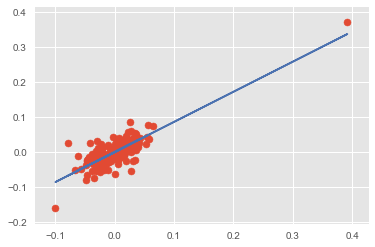

{'beta': array([ 0.86025366]), 'r2-score': 0.67394057224402681}
[5, 30]
['UKT', 'GER']
Regression time series


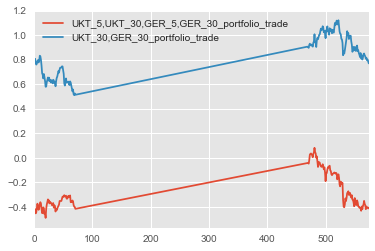

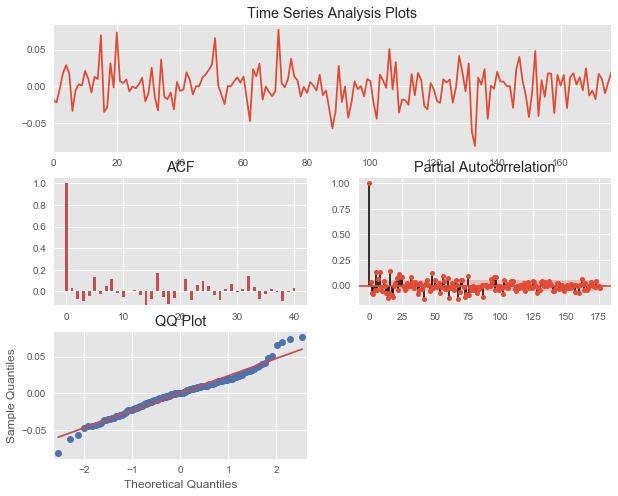

ADF Tests
ADF Statistic: -12.726669
p-value: 0.000000
Critical Values:
	5%: -2.878
	1%: -3.468
	10%: -2.576
Mean Reversion characteristics
{'R-squared': 0.48209370191820389, 'Average': 0.00013202714743173818, 'half-life': 0.71897813373080222, 'Current_Displacement': -0.018946174007564171}


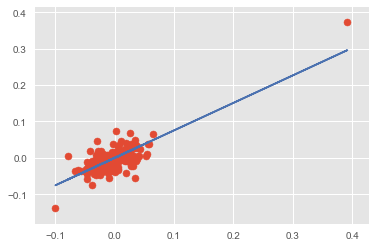

{'beta': array([ 0.75488757]), 'r2-score': 0.62672100166537548}
[10, 30]
['UKT', 'GER']
Regression time series


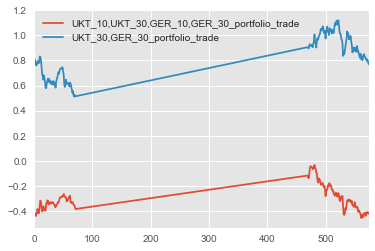

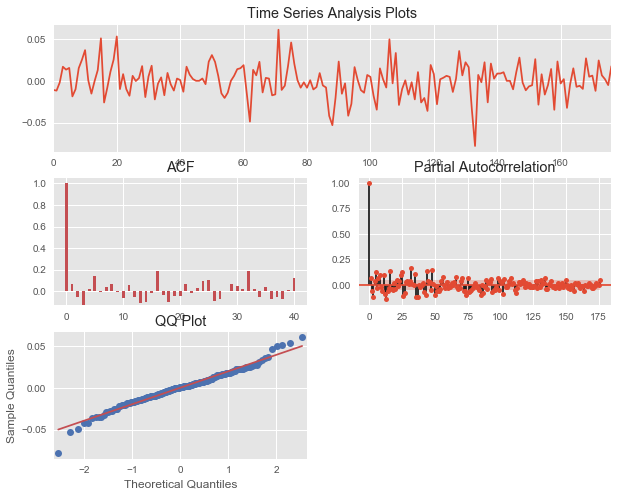

ADF Tests
ADF Statistic: -12.278228
p-value: 0.000000
Critical Values:
	5%: -2.878
	1%: -3.468
	10%: -2.576
Mean Reversion characteristics
{'R-squared': 0.46421128945385581, 'Average': 9.0166092701948958e-05, 'half-life': 0.74550360975153407, 'Current_Displacement': -0.017318751678674478}


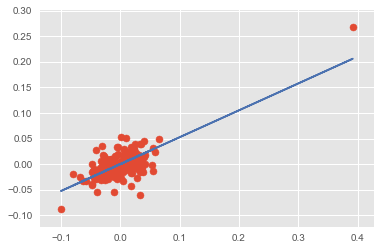

{'beta': array([ 0.52555736]), 'r2-score': 0.54152747477190888}
[5, 15]
['UKT', 'GER']
Regression time series


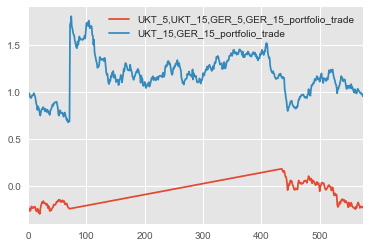

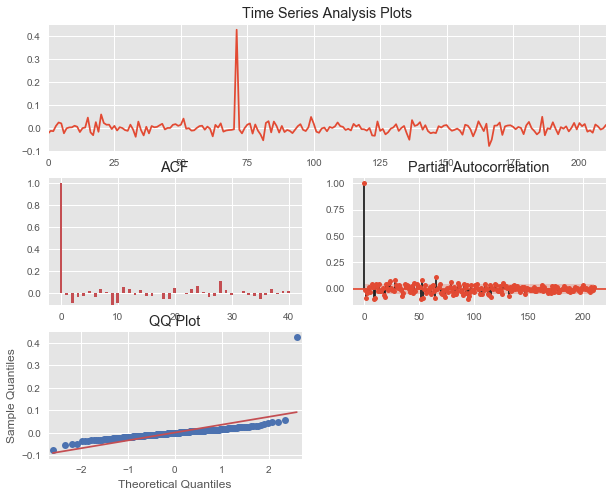

ADF Tests
ADF Statistic: -14.659780
p-value: 0.000000
Critical Values:
	5%: -2.875
	1%: -3.462
	10%: -2.574
Mean Reversion characteristics
{'R-squared': 0.50816859529908753, 'Average': 0.00087613547066474741, 'half-life': 0.68263580019825276, 'Current_Displacement': -0.012316822940813642}


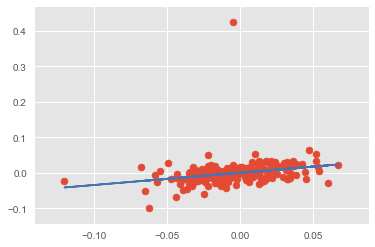

{'beta': array([ 0.34619723]), 'r2-score': 0.066129132594222373}
[2, 5]
['FIN', 'NET']
Regression time series


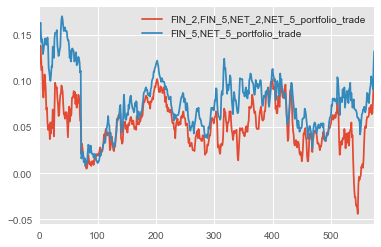

In [ ]:
#3 - Part C - Regression box vs cross country spread level

def reg_box_xcy(ret_df,Ylist,Y_country,Xlist,X_country, metric = 'YLD_YTM_MID', del_changes = True):
    print Ylist
    print [Y_country,X_country]
    leg = portfolio_regression(ret_df,Ylist+Xlist,[-1,1,1,-1],
                                [Y_country,Y_country,X_country,X_country],[Ylist[1],Xlist[1]],[1,-1]
                                ,[Y_country,X_country])
    print leg
    
    return 0.

mastercurve_list_1 = [[2,5],[2,7],[2,10],[5,10],[5,15],[7,15],[2,30],[5,30],[10,30],[5,15]]
fly_country_dict1_1 = {key:np.nan for key in list(headers.columns)}
#for cn in headers.columns:
len1 = len(headers.columns)    
for cn1 in range(0,len1-1):
    X_country = str(headers.columns[cn1])
    for cn2 in range(cn1+1,len1):
        Y_country = str(headers.columns[cn2])
       
        compare_fly_list = mastercurve_list_1
        
        for fly in compare_fly_list:
            Ylist = fly
            Xlist = Ylist
            reg_box_xcy(ret_df.copy(),Ylist,Y_country,Xlist,X_country)

In [ ]:
#4 Cross country same tenor fly
def calc_custom_portfolio(ret_df,Ylist,Yweights,Y_country, metric = 'YLD_YTM_MID', del_changes = True,ispca=False):
    if not isinstance(Y_country,list):
        Y_country = [Y_country]*len(Yweights)
        
    Y_tickerlist = [headers.loc[str(x)+'Y',country]+' Govt__'+metric for x,country in zip(Ylist,Y_country)]
    Y_country_label = ','.join([country+'_'+str(x) for x,country in  zip(Ylist,Y_country)])

    try:
        Y = pd.DataFrame(np.array(sum([ret_df[col]*weight for col,weight in zip(Y_tickerlist,Yweights)]))
                                                       , columns = [Y_country_label+'_portfolio_trade'])
        Y = Y.dropna()
    except:
        print "Did not work at data referencing level"
        return 0.

    #tsdiagnostics(Y.iloc[:,0])
    if ispca and len(Ylist)<=3:
        pcatsrolling = rolling_pca_calc(ret_df.copy(),Y_tickerlist,window=100)
        pcatsrolling.dropna().plot(legend = True)
        plt.show()
        print "Returning PCA weighted portfolio"
        print "PCA weights are - "
        pcats = trade_pca_calc(ret_df.copy(),Y_tickerlist).dropna()
        tsdiagnostics(pcats)
        
        #pca_fly_country_dict = pd.DataFrame(pcats, columns = ['PCA_Fly'+''.join([str(x) for x in Y_tickerlist])])
        #print pca_fly_country_dict[country]
        #fly_country_dict = pd.DataFrame(o_trade_calc(ret_df.copy(),Y_tickerlist).dropna(),columns = ['1-2-1_Fly'+''.join([str(x) for x in Y_tickerlist)])
        #ax = pca_fly_country_dict.plot(legend = True)
        #fly_country_dict.plot(legend = True, ax = ax)
        
        
        pca_fly_country_dict = pd.DataFrame(pcats, columns = ['PCA_Fly'+''.join([str(x) for x in Y_tickerlist])])
        #print pca_fly_country_dict[country]
        o_fly_country_dict = pd.DataFrame(o_trade_calc(ret_df.copy(),Y_tickerlist).dropna(),columns = ['Bond Yield'+''.join([str(x) for x in Y_tickerlist[1]])])
        ax = pca_fly_country_dict.plot(legend = True)
        o_fly_country_dict.plot(legend = True, ax = ax)
        
        plt.show()
    
    print "New Structure"
    return 0.


#Ylist = [3,7]
#Xlist = Ylist
#X_country = 'GER'
#Y_country = 'ITL'
#calc_custom_portfolio(ret_df.copy(),Ylist+Xlist,[-1,1,1,-1],[Y_country,Y_country,X_country,X_country])
calc_custom_portfolio(ret_df.copy(),[2,2,2],[-1,2,-1],['ITL','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[5,5,5],[-1,2,-1],['ITL','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[10,10,10],[-1,2,-1],['ITL','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[15,15,15],[-1,2,-1],['ITL','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[30,30,30],[-1,2,-1],['ITL','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[2,2,2],[-1,2,-1],['ESP','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[5,5,5],[-1,2,-1],['ESP','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[10,10,10],[-1,2,-1],['ESP','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[15,15,15],[-1,2,-1],['ESP','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[30,30,30],[-1,2,-1],['ESP','FRA','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[2,2,2],[-1,2,-1],['PTE','BEL','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[5,5,5],[-1,2,-1],['PTE','BEL','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[10,10,10],[-1,2,-1],['PTE','BEL','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[15,15,15],[-1,2,-1],['PTE','BEL','GER'],ispca = True)
calc_custom_portfolio(ret_df.copy(),[30,30,30],[-1,2,-1],['PTE','BEL','GER'],ispca = True)
#print "Regression"
#print '\n'
#calc_custom_portfolio(ret_df.copy(),[5,5,5],[-1,2,-1],['ITL','FRA','GER'],ispca = False)